In [18]:
import os
import glob
import numpy as np
import pandas as pd
import torch
import torch.nn as nn
import torch.nn.functional as F
from torch.utils.data import Dataset, DataLoader
from sklearn.model_selection import StratifiedKFold, train_test_split
from sklearn.metrics import accuracy_score, f1_score, precision_score, recall_score, confusion_matrix, classification_report
from sklearn.preprocessing import StandardScaler, MinMaxScaler, LabelEncoder
from collections import Counter
import matplotlib.pyplot as plt
import seaborn as sns
from mlxtend.plotting import plot_confusion_matrix
from sklearn.manifold import TSNE
import warnings
warnings.filterwarnings('ignore')

import requests
import zipfile
import csv

###############################
def set_seed(seed=232):
    torch.manual_seed(seed)
    torch.cuda.manual_seed(seed)
    torch.cuda.manual_seed_all(seed)
    np.random.seed(seed)
    torch.backends.cudnn.deterministic = True
    torch.backends.cudnn.benchmark = False

###############################
class HARDataset(Dataset):
    def __init__(self, X, y):
        self.X = torch.tensor(X, dtype=torch.float32)
        self.y = torch.tensor(y, dtype=torch.long)

    def __len__(self):
        return len(self.X)

    def __getitem__(self, idx):
        return self.X[idx], self.y[idx]

###############################
def split_sequences(sequences, n_steps, overlap_ratio=0.5):
    X, y = list(), list()
    step_size = max(1, int(n_steps * (1 - overlap_ratio)))

    for i in range(len(sequences)):
        seq_data = sequences[i][:, :-1]
        seq_labels = sequences[i][:, -1]

        for j in range(0, len(seq_data) - n_steps + 1, step_size):
            end_ix = j + n_steps
            if end_ix > len(seq_data):
                break
            seq_x = seq_data[j:end_ix]
            seq_y = seq_labels[end_ix-1]
            X.append(seq_x)
            y.append(seq_y)

    return np.array(X), np.array(y)

###############################
def load_uci_har_data(dataset_path="data/UCI_HAR_Dataset"):
    print("Loading UCI HAR dataset...")

    SIGNALS = ["body_acc_x", "body_acc_y", "body_acc_z",
               "body_gyro_x", "body_gyro_y", "body_gyro_z",
               "total_acc_x", "total_acc_y", "total_acc_z"]

    X_list = []

    for signal in SIGNALS:
        train_file = os.path.join(dataset_path, f"{signal}_train.txt")
        test_file = os.path.join(dataset_path, f"{signal}_test.txt")

        try:
            train_signal = np.loadtxt(train_file, dtype=np.float32)
            test_signal = np.loadtxt(test_file, dtype=np.float32)
            combined_signal = np.concatenate([train_signal, test_signal], axis=0)
            X_list.append(combined_signal)
        except FileNotFoundError as e:
            print(f"Error loading file: {e}")
            return None, None, None

    if not X_list:
        print("No signal data loaded")
        return None, None, None

    X = np.stack(X_list, axis=-1)
    X = np.transpose(X, (0, 2, 1))

    X_df = pd.DataFrame(X.reshape(X.shape[0], -1))
    X_df = X_df.fillna(method='ffill').fillna(method='bfill')
    X = X_df.values.reshape(X.shape)

    try:
        y_train = np.loadtxt(os.path.join(dataset_path, "y_train.txt"), dtype=int)
        y_test = np.loadtxt(os.path.join(dataset_path, "y_test.txt"), dtype=int)
        y = np.concatenate([y_train, y_test], axis=0)
        y = y - 1

        label_encoder = LabelEncoder()
        y_encoded = label_encoder.fit_transform(y)
    except FileNotFoundError as e:
        print(f"Error loading label file: {e}")
        return None, None, None

    window_size = 128
    step_size = 64

    all_sequences = []
    for i in range(X.shape[0]):
        seq_data = X[i]
        seq_label = int(y_encoded[i])
        all_sequences.append(np.column_stack([seq_data.T, np.full(window_size, seq_label, dtype=int)]))

    X_seq, y_seq = split_sequences(all_sequences, window_size, overlap_ratio=0.5)
    y_seq = y_seq.astype(int)
    X_seq = np.transpose(X_seq, (0, 2, 1))

    scaler = MinMaxScaler()
    X_flat = X_seq.reshape(X_seq.shape[0], -1)
    X_flat = scaler.fit_transform(X_flat)
    X_seq = X_flat.reshape(X_seq.shape)

    ucihar_activity_mapping = {
        0: 'Walking', 1: 'Walking Upstairs', 2: 'Walking Downstairs',
        3: 'Sitting', 4: 'Standing', 5: 'Laying'
    }

    activity_labels = [ucihar_activity_mapping.get(label, f"Unknown_Activity_{label}") for label in sorted(np.unique(y_seq))]

    print(f"UCI HAR - X_sequences shape: {X_seq.shape}")
    return X_seq, y_seq, activity_labels

###############################
def download_usc_had(save_dir="data/USC_HAD"):
    zip_path = os.path.join(save_dir, "USC-HAD.zip")
    data_path = os.path.join(save_dir, "USC-HAD")

    if os.path.exists(data_path):
        print("USC-HAD already downloaded.")
        return data_path

    os.makedirs(save_dir, exist_ok=True)
    url = "http://sipi.usc.edu/had/USC-HAD.zip"
    print("Downloading USC-HAD dataset...")
    r = requests.get(url, stream=True)
    if r.status_code != 200:
        raise RuntimeError(f"Failed to download USC-HAD: status {r.status_code}")

    with open(zip_path, "wb") as f:
        for chunk in r.iter_content(chunk_size=8192):
            f.write(chunk)

    print("Extracting USC-HAD dataset...")
    with zipfile.ZipFile(zip_path, "r") as zip_ref:
        zip_ref.extractall(save_dir)

    os.remove(zip_path)
    print("USC-HAD download & extraction complete.")
    return data_path

###############################
def load_usc_had_data(dataset_path="data/USC_HAD/USC-HAD"):
    import scipy.io
    print("Loading USC-HAD dataset...")

    download_usc_had()

    subject_ids = []
    act_nums = []
    sensor_data = []

    for path, _, files in os.walk(dataset_path):
        for name in files:
            if name.endswith('.mat'):
                try:
                    mat = scipy.io.loadmat(os.path.join(path, name))
                    subject_ids.append(int(mat['subject'][0][0]))
                    act_num = int(mat['activity_number'][0][0]) if 'activity_number' in mat else 0
                    act_nums.append(act_num)
                    signal = np.array(mat['sensor_readings'], dtype=np.float32)
                    signal = signal[::2, :]
                    sensor_data.append(signal)
                except Exception as e:
                    print(f"Error loading {name}: {e}")

    if not sensor_data:
        print("Error: No data loaded")
        return None, None, None

    clean_data = []
    for sig in sensor_data:
        df = pd.DataFrame(sig)
        df = df.fillna(method='ffill').fillna(method='bfill')
        clean_data.append(df.values)

    def windowing(features, label, window_size, step):
        X_win, y_win = [], []
        start = 0
        while start + window_size <= len(features):
            win_data = features[start:start+window_size, :]
            win_label = label[start:start+window_size]
            most_common_label = Counter(win_label).most_common(1)[0][0]
            X_win.append(win_data)
            y_win.append(most_common_label)
            start += step
        return np.array(X_win, dtype=np.float32), np.array(y_win, dtype=int)

    window_size = 100
    step = 50

    all_windows = []
    all_labels = []
    for sig, act in zip(clean_data, act_nums):
        if act == 0:
            continue
        labels = np.full(len(sig), act, dtype=int)
        X_win, y_win = windowing(sig, labels, window_size, step)
        all_windows.append(X_win)
        all_labels.append(y_win)

    if not all_windows:
        print("Error: No windows created")
        return None, None, None

    X_all = np.vstack(all_windows)
    y_all = np.hstack(all_labels)

    label_encoder = LabelEncoder()
    y_encoded = label_encoder.fit_transform(y_all)

    scaler = MinMaxScaler()
    X_flat = X_all.reshape(X_all.shape[0], -1)
    X_scaled = scaler.fit_transform(X_flat)
    X_scaled = X_scaled.reshape(X_all.shape)
    X_scaled = np.transpose(X_scaled, (0, 2, 1))

    # 🔥 실제 USC-HAD 활동 이름
    usc_had_activity_names = [
        "Walking Forward",
        "Walking Left",
        "Walking Right",
        "Walking Upstairs",
        "Walking Downstairs",
        "Running Forward",
        "Jumping Up",
        "Sitting",
        "Standing",
        "Sleeping",
        "Elevator Up",
        "Elevator Down"
    ]

    # 실제 클래스에 맞춰 활동 이름 매핑
    activity_labels = []
    for cls in sorted(np.unique(y_all)):
        if 1 <= cls <= len(usc_had_activity_names):
            activity_labels.append(usc_had_activity_names[cls-1])  # 1-based to 0-based
        else:
            activity_labels.append(f"Unknown_Activity_{cls}")

    print(f"USC-HAD - X shape: {X_scaled.shape}, y shape: {y_encoded.shape}")
    return X_scaled, y_encoded, activity_labels

###############################
def load_wisdm_data(dataset_path="data/WISDM_ar_v1.1/WISDM_ar_v1.1_raw.txt"):
    print("Loading WISDM dataset...")

    try:
        if os.path.isfile(dataset_path):
            file_paths = [dataset_path]
        else:
            possible_files = ['WISDM_ar_v1.1_raw.txt', 'WISDM_ar_v1.1_trans.arff', 'wisdm-dataset.txt', 'actitracker_raw.txt']
            file_paths = []
            for filename in possible_files:
                full_path = os.path.join(dataset_path, filename)
                if os.path.exists(full_path):
                    file_paths.append(full_path)

        if not file_paths:
            print("Error: No WISDM data files found")
            return None, None, None

        all_data = []
        for file_path in file_paths:
            try:
                with open(file_path, 'r') as f:
                    lines = f.readlines()

                cleaned_data = []
                for line in lines:
                    try:
                        line = line.strip().rstrip(';').rstrip(',')
                        if not line:
                            continue

                        parts = line.split(',')
                        if len(parts) >= 6:
                            user = parts[0].strip()
                            activity = parts[1].strip()
                            timestamp = parts[2].strip()
                            x = float(parts[3].strip())
                            y = float(parts[4].strip())
                            z = float(parts[5].strip())
                            cleaned_data.append([user, activity, timestamp, x, y, z])
                        elif len(parts) == 5:
                            user = parts[0].strip()
                            activity = parts[1].strip()
                            x = float(parts[2].strip())
                            y = float(parts[3].strip())
                            z = float(parts[4].strip())
                            cleaned_data.append([user, activity, 0, x, y, z])
                    except:
                        continue

                if cleaned_data:
                    df = pd.DataFrame(cleaned_data, columns=['user', 'activity', 'timestamp', 'x', 'y', 'z'])
                    df['x'] = pd.to_numeric(df['x'], errors='coerce')
                    df['y'] = pd.to_numeric(df['y'], errors='coerce')
                    df['z'] = pd.to_numeric(df['z'], errors='coerce')

                    df = df.fillna(method='ffill').fillna(method='bfill')
                    print(f"    Processed data shape after NaN interpolation: {df.shape}")
                    all_data.append(df)

            except Exception as e:
                print(f"Error processing {file_path}: {e}")
                continue

        if not all_data:
            print("Error: No valid data loaded")
            return None, None, None

        combined_df = pd.concat(all_data, ignore_index=True)

        combined_df = combined_df.dropna(subset=['activity'])
        combined_df = combined_df[combined_df['activity'].str.strip() != '']

        all_windows = []
        all_labels = []
        original_labels_collected = []

        if 'user' in combined_df.columns:
            groups = combined_df.groupby(['user', 'activity'])
        else:
            groups = combined_df.groupby(['activity'])

        window_size = 20
        step = 10

        for group_name, group_data in groups:
            if isinstance(group_name, tuple):
                activity = group_name[-1]
            else:
                activity = group_name

            acc_data = group_data[['x', 'y', 'z']].values.astype(np.float32)

            if len(acc_data) < window_size:
                continue

            start = 0
            while start + window_size <= len(acc_data):
                window_data = acc_data[start:start + window_size, :]
                all_windows.append(window_data)
                all_labels.append(activity)
                original_labels_collected.append(activity)
                start += step

        if not all_windows:
            print("Error: No windows created")
            return None, None, None

        X_windowed = np.array(all_windows, dtype=np.float32)
        X_windowed = np.transpose(X_windowed, (0, 2, 1))

        scaler = MinMaxScaler()
        X_windowed_flat = X_windowed.reshape(X_windowed.shape[0], -1)
        X_windowed_flat = scaler.fit_transform(X_windowed_flat)
        X_windowed = X_windowed_flat.reshape(X_windowed.shape)

        label_encoder = LabelEncoder()
        label_encoder.fit(sorted(set(original_labels_collected)))
        y_encoded = label_encoder.transform(all_labels)
        class_names = list(label_encoder.classes_)

        print(f"WISDM - X_sequences shape: {X_windowed.shape}")
        return X_windowed, y_encoded, class_names

    except Exception as e:
        print(f"Error loading WISDM data: {e}")
        return None, None, None

###############################
def load_pamap2_data(dataset_dir="data/PAMAP2_Dataset"):
    print("Loading PAMAP2 dataset...")

    file_paths = sorted(glob.glob(os.path.join(dataset_dir, 'Protocol', 'subject*.dat')))
    optional_path = os.path.join(dataset_dir, 'Optional')
    if os.path.exists(optional_path):
        file_paths += sorted(glob.glob(os.path.join(optional_path, 'subject*.dat')))

    if not file_paths:
        print("Error: No subject files found")
        return None, None, None

    print(f"Found {len(file_paths)} subject files. Processing...")

    all_windows = []
    all_labels = []

    window_size = 100
    step = 50

    for file_path in file_paths:
        subject_id = os.path.basename(file_path).split('.')[0]
        print(f"  Processing {subject_id}...")

        try:
            df = pd.read_csv(file_path, sep='\s+', header=None, na_values='NaN')
            print(f"    {subject_id}: Loaded dataframe with shape {df.shape}")

            df_cleaned = df.fillna(method='ffill').fillna(method='bfill')
            print(f"    {subject_id}: Shape after NaN interpolation: {df_cleaned.shape}")

            if df_cleaned.empty:
                continue

            labels = df_cleaned.iloc[:, 1].values.astype(int)

            hand_imu = list(range(4, 13))      # accel(3) + gyro(3) + mag(3) = 9개
            chest_imu = list(range(20, 29))    # accel(3) + gyro(3) + mag(3) = 9개
            ankle_imu = list(range(36, 45))    # accel(3) + gyro(3) + mag(3) = 9개
            all_sensor_cols = hand_imu + chest_imu + ankle_imu  # 총 27개

            if df_cleaned.shape[1] < max(all_sensor_cols) + 1:
                continue

            features = df_cleaned.iloc[:, all_sensor_cols].values.astype(np.float32)

            valid_indices = np.where(~np.isin(labels, [0]))[0]
            if len(valid_indices) == 0:
                continue

            features = features[valid_indices, :]
            labels = labels[valid_indices]

            if len(features) < window_size:
                continue

            start = 0
            while start + window_size <= len(features):
                window_data = features[start : start + window_size, :]
                window_labels_raw = labels[start : start + window_size]
                most_common_label = Counter(window_labels_raw).most_common(1)[0][0]
                all_windows.append(window_data)
                all_labels.append(most_common_label)
                start += step

            print(f"    {subject_id}: Created windows")

        except Exception as e:
            print(f"    Error processing {subject_id}: {e}")

    if not all_windows:
        print("Error: No windows created")
        return None, None, None

    pamap2_original_to_new = {
        1: 0, 2: 1, 3: 2, 4: 3, 5: 4, 12: 5,
        13: 6, 6: 7, 7: 8, 16: 9, 17: 10, 24: 11
    }

    pamap2_activity_names = [
        "Lying", "Sitting", "Standing", "Walking", "Running",
        "Ascending Stairs", "Descending Stairs", "Cycling",
        "Nordic Walking", "Vacuum Cleaning", "Ironing", "Rope Jumping"
    ]

    valid_mask = np.isin(all_labels, list(pamap2_original_to_new.keys()))
    if not np.any(valid_mask):
        print("Error: No valid activities found")
        return None, None, None

    filtered_windows = [all_windows[i] for i in range(len(all_windows)) if valid_mask[i]]
    filtered_labels = [all_labels[i] for i in range(len(all_labels)) if valid_mask[i]]

    mapped_labels = [pamap2_original_to_new[label] for label in filtered_labels]

    X_windowed = np.array(filtered_windows, dtype=np.float32)
    y_encoded = np.array(mapped_labels, dtype=int)

    scaler = MinMaxScaler()
    X_windowed_flat = X_windowed.reshape(X_windowed.shape[0], -1)
    X_windowed_flat = scaler.fit_transform(X_windowed_flat)
    X_windowed = X_windowed_flat.reshape(X_windowed.shape)
    X_windowed = np.transpose(X_windowed, (0, 2, 1))

    print(f"PAMAP2 - X_sequences shape: {X_windowed.shape}")
    return X_windowed, y_encoded, pamap2_activity_names

###############################
def load_mhealth_data(dataset_dir="data/MHEALTHDATASET"):
    print("Loading mHealth dataset...")

    subject_files = sorted([
        os.path.join(dataset_dir, f)
        for f in os.listdir(dataset_dir)
        if f.startswith("mHealth_subject") and f.endswith(".log")
    ])

    if not subject_files:
        print("Error: No subject files found")
        return None, None, None

    print(f"Found {len(subject_files)} subject files. Processing...")

    all_windows = []
    all_labels = []
    original_labels_collected = []

    window_size = 50
    step = 25

    for file_path in subject_files:
        subject_id = os.path.basename(file_path).split('.')[0]
        print(f"  Processing {subject_id}...")

        try:
            df = pd.read_csv(file_path, sep='\s+', header=None, engine='python', dtype=np.float32)
            print(f"    {subject_id}: Loaded dataframe with shape {df.shape}")

            df = df.fillna(method='ffill').fillna(method='bfill')
            print(f"    {subject_id}: Shape after NaN interpolation: {df.shape}")

            if df.shape[1] < 24:
                continue

            labels = df.iloc[:, 23].values.astype(int)
            # IMU 컬럼: chest accel(0-2) + ankle IMU(5-13) + arm IMU(14-22) = 18개
            imu_cols = [0,1,2] + list(range(5, 23))
            features = df.iloc[:, imu_cols].values

            valid_indices = np.where(labels != 0)[0]
            if len(valid_indices) == 0:
                continue

            features = features[valid_indices, :]
            labels = labels[valid_indices]

            if len(features) < window_size:
                continue

            original_labels_collected.extend(labels)

            start = 0
            while start + window_size <= len(features):
                window_data = features[start : start + window_size, :]
                window_labels_raw = labels[start : start + window_size]
                most_common_label = Counter(window_labels_raw).most_common(1)[0][0]
                all_windows.append(window_data)
                all_labels.append(most_common_label)
                start += step

            print(f"    {subject_id}: Created windows")

        except Exception as e:
            print(f"    Error processing {subject_id}: {e}")

    if not all_windows:
        print("Error: No windows created")
        return None, None, None

    label_encoder = LabelEncoder()
    label_encoder.fit(sorted(set(original_labels_collected)))
    y_encoded = label_encoder.transform(all_labels)
    class_names = list(label_encoder.classes_)

    X_windowed = np.array(all_windows, dtype=np.float32)

    scaler = MinMaxScaler()
    X_windowed_flat = X_windowed.reshape(X_windowed.shape[0], -1)
    X_windowed_flat = scaler.fit_transform(X_windowed_flat)
    X_windowed = X_windowed_flat.reshape(X_windowed.shape)
    X_windowed = np.transpose(X_windowed, (0, 2, 1))

    mhealth_activity_mapping = {
        1: 'Standing still', 2: 'Sitting and relaxing', 3: 'Lying down', 4: 'Walking',
        5: 'Climbing stairs', 6: 'Waist bends forward', 7: 'Frontal elevation of arms',
        8: 'Knees bending (crouching)', 9: 'Cycling', 10: 'Jogging', 11: 'Running', 12: 'Jump front & back'
    }

    activity_labels = []
    for encoded_idx in range(len(class_names)):
        original_label = class_names[encoded_idx]
        if original_label in mhealth_activity_mapping:
            activity_labels.append(mhealth_activity_mapping[original_label])
        else:
            activity_labels.append(f"Unknown_Activity_{original_label}")

    print(f"mHealth - X_sequences shape: {X_windowed.shape}")
    return X_windowed, y_encoded, activity_labels

###############################
import os
import csv

###############################
def load_opportunity_data(datapath='data/OpportunityUCIDataset', window_size=30, step=15):
    print("Loading Opportunity dataset...")

    # 🔥 실제 Opportunity 활동 라벨 정의
    label_map = [
        (406516, 'Open Door 1'),
        (406517, 'Open Door 2'),
        (404516, 'Close Door 1'),
        (404517, 'Close Door 2'),
        (406520, 'Open Fridge'),
        (404520, 'Close Fridge'),
        (406505, 'Open Dishwasher'),
        (404505, 'Close Dishwasher'),
        (406519, 'Open Drawer 1'),
        (404519, 'Close Drawer 1'),
        (406511, 'Open Drawer 2'),
        (404511, 'Close Drawer 2'),
        (406508, 'Open Drawer 3'),
        (404508, 'Close Drawer 3'),
        (408512, 'Clean Table'),
        (407521, 'Drink from Cup'),
        (405506, 'Toggle Switch')
    ]

    label2id = {str(x[0]): i for i, x in enumerate(label_map)}

    # train / val / test 파일 리스트
    files = {
        'train': [
            'S2-ADL4.dat', 'S3-ADL5.dat', 'S4-ADL4.dat',
            'S2-ADL1.dat', 'S2-ADL3.dat',
            'S3-ADL1.dat', 'S3-ADL2.dat', 'S3-ADL3.dat',
            'S4-ADL1.dat', 'S4-ADL2.dat', 'S4-ADL3.dat', 'S4-ADL5.dat',
            'S2-ADL5.dat', 'S3-ADL4.dat'
        ],
        'val': ['S2-ADL2.dat'],
        'test': ['S1-ADL2.dat', 'S1-ADL3.dat', 'S1-ADL1.dat', 'S1-ADL4.dat', 'S1-ADL5.dat']
    }

    all_data = []
    all_labels = []

    try:
        for dataset_type in ['train', 'val', 'test']:
            print(f"\nProcessing {dataset_type} set...")
            data_list = []
            label_list = []
            for fname in files[dataset_type]:
                path = os.path.join(datapath, fname)
                print(f"Loading file: {fname}")
                with open(path, 'r') as f:
                    reader = csv.reader(f, delimiter=' ')
                    rows = [line for line in reader if len(line) > 1]
                rows = [[x for x in row if x != ''] for row in rows]  # 빈 값 제거
                rows = pd.DataFrame(rows).astype(str)

                # 모든 feature 사용, 마지막 컬럼이 label
                imu_cols = list(range(37, 46)) + list(range(50, 59)) + list(range(76, 85))
                X = rows.iloc[:, imu_cols].astype(float).values / 1000.0
                y = rows.iloc[:, -1].values
                print(f"  Original X shape: {X.shape}, y length: {len(y)}")

                # NaN 처리 (forward/backward fill)
                X = pd.DataFrame(X).fillna(method='ffill').fillna(method='bfill').values
                y = pd.DataFrame(y).fillna(method='ffill').fillna(method='bfill').values.flatten()
                print(f"  After NaN fill - X shape: {X.shape}, y length: {len(y)}")

                # 무효 라벨 제거
                mask = np.array([str(label) in label2id for label in y])
                X = X[mask]
                y = y[mask]
                y = np.array([label2id[str(label)] for label in y])
                print(f"  After removing invalid labels - X shape: {X.shape}, y length: {len(y)}")

                # 슬라이딩 윈도우
                windows = []
                labels_win = []
                start = 0
                while start + window_size <= len(X):
                    windows.append(X[start:start+window_size])
                    labels_win.append(y[start+window_size-1])
                    start += step
                print(f"  Created {len(windows)} sliding windows")

                if len(windows) > 0:
                    data_list.append(np.array(windows))
                    label_list.append(np.array(labels_win))

            if len(data_list) > 0:
                all_data.append(np.concatenate(data_list, axis=0))
                all_labels.append(np.concatenate(label_list, axis=0))
                print(f"{dataset_type} set - total windows: {all_data[-1].shape[0]}")

        # 최종 train/val/test 데이터 합치기
        X_sequences = np.concatenate(all_data, axis=0).astype(np.float32)
        y_sequences = np.concatenate(all_labels, axis=0)
        print(f"\nConcatenated all sets - X_sequences shape: {X_sequences.shape}, y_sequences length: {len(y_sequences)}")

        # (samples, features, timesteps) 형태로 변환
        X_sequences = np.transpose(X_sequences, (0, 2, 1))
        print(f"Transposed X_sequences shape: {X_sequences.shape}")

        # MinMax scaling
        scaler = MinMaxScaler()
        X_flat = X_sequences.reshape(X_sequences.shape[0], -1)
        X_scaled = scaler.fit_transform(X_flat)
        X_sequences = X_scaled.reshape(X_sequences.shape)
        print("MinMax scaling applied.")

        # 🔥 실제 활동 이름 사용
        activity_labels = [name for _, name in label_map]

        print(f"Opportunity - final X_sequences shape: {X_sequences.shape}")
        return X_sequences, y_sequences, activity_labels

    except Exception as e:
        print(f"Could not load Opportunity dataset: {e}")
        return None, None, None

###############################
import torch
import torch.nn as nn
import torch.nn.functional as F

class CBAMBlock1D(nn.Module):
    def __init__(self, channels, reduction=4, kernel_size=7):
        super().__init__()
        self.pool_avg = nn.AdaptiveAvgPool1d(1)
        self.pool_max = nn.AdaptiveMaxPool1d(1)
        self.mlp = nn.Sequential(
            nn.Linear(channels, channels // reduction, bias=False),
            nn.ReLU(),
            nn.Linear(channels // reduction, channels, bias=False)
        )
        self.sigmoid_channel = nn.Sigmoid()
        self.conv_spatial = nn.Conv1d(2, 1, kernel_size=kernel_size, padding=kernel_size // 2)
        self.sigmoid_spatial = nn.Sigmoid()

    def forward(self, x):
        b, c, t = x.size()
        avg_out = self.mlp(self.pool_avg(x).view(b, c))
        max_out = self.mlp(self.pool_max(x).view(b, c))
        scale = self.sigmoid_channel(avg_out + max_out).view(b, c, 1)
        x = x * scale

        avg_spatial = torch.mean(x, dim=1, keepdim=True)
        max_spatial, _ = torch.max(x, dim=1, keepdim=True)
        spatial = torch.cat([avg_spatial, max_spatial], dim=1)
        spatial = self.sigmoid_spatial(self.conv_spatial(spatial))
        x = x * spatial
        return x

class LightMambaBlock1D(nn.Module):
    def __init__(self, dim):
        super().__init__()
        self.norm = nn.LayerNorm(dim)
        self.proj_in = nn.Linear(dim, dim * 2)  # Expansion for gating
        self.dw_conv = nn.Conv1d(dim, dim, kernel_size=3, padding=1, groups=dim)
        self.act = nn.ReLU()  # More stable activation
        self.proj_out = nn.Linear(dim, dim)
        self.dropout = nn.Dropout(0.1)  # Add dropout for regularization

    def forward(self, x):
        residual = x  # Save residual
        x = self.norm(x)

        # Gated linear unit style processing
        x_proj = self.proj_in(x)
        x1, x2 = x_proj.chunk(2, dim=-1)
        x1 = self.dw_conv(x1.transpose(1, 2)).transpose(1, 2)
        x = self.proj_out(self.act(x1) * torch.sigmoid(x2))
        x = self.dropout(x)

        return x + residual  # Internal residual connection

class MahalanobisContextPrototypes(nn.Module):
    def __init__(self, feature_dim, num_classes):
        super().__init__()
        self.feature_dim = feature_dim
        self.num_classes = num_classes

        # Initialize prototypes with better scaling
        self.prototype_centers = nn.Parameter(torch.randn(num_classes, feature_dim) * 0.01)
        self.log_cov_diag = nn.Parameter(torch.ones(num_classes, feature_dim) * 0.1)

        # Context adaptation networks
        self.context_center_shift = nn.Sequential(
            nn.Linear(feature_dim, feature_dim // 2),
            nn.BatchNorm1d(feature_dim // 2),
            nn.ReLU(inplace=True),
            nn.Dropout(0.2),
            nn.Linear(feature_dim // 2, feature_dim),
            nn.Tanh()
        )

        self.context_cov_scale = nn.Sequential(
            nn.Linear(feature_dim, feature_dim // 2),
            nn.BatchNorm1d(feature_dim // 2),
            nn.ReLU(inplace=True),
            nn.Dropout(0.2),
            nn.Linear(feature_dim // 2, feature_dim),
            nn.Sigmoid()
        )

        # Learnable scaling factors
        self.shift_scale = nn.Parameter(torch.tensor(0.1))
        self.cov_scale = nn.Parameter(torch.tensor(0.1))

        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.trunc_normal_(m.weight, std=0.02)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

    def compute_mahalanobis_distance(self, x, centers, cov_diag):
        batch_size = x.size(0)

        # Expand dimensions for broadcasting
        x_expanded = x.unsqueeze(1).expand(-1, self.num_classes, -1)
        centers_expanded = centers.unsqueeze(0).expand(batch_size, -1, -1)
        cov_diag_expanded = cov_diag.unsqueeze(0).expand(batch_size, -1, -1)

        # Compute Mahalanobis distance
        diff = x_expanded - centers_expanded
        inv_var = 1.0 / (torch.exp(cov_diag_expanded) + 1e-6)
        mahal_dist = torch.sum(diff ** 2 * inv_var, dim=2)

        # Add regularization term
        log_det = torch.sum(cov_diag_expanded, dim=2)
        mahal_dist = mahal_dist + 0.5 * log_det

        return mahal_dist

    def forward(self, x):
        batch_size = x.size(0)

        # Context-aware adjustments
        context_shift = self.context_center_shift(x)
        context_cov = self.context_cov_scale(x)

        # Adjust prototypes based on context
        adjusted_centers = self.prototype_centers + self.shift_scale * context_shift.unsqueeze(1)
        adjusted_cov_diag = self.log_cov_diag + self.cov_scale * context_cov.unsqueeze(1)

        # Average across batch for stable prototypes
        adjusted_centers = adjusted_centers.mean(dim=0)
        adjusted_cov_diag = adjusted_cov_diag.mean(dim=0)

        # Compute distances and convert to logits
        distances = self.compute_mahalanobis_distance(x, adjusted_centers, adjusted_cov_diag)
        logits = -distances

        return logits

class MLPClassifier(nn.Module):
    def __init__(self, input_dim, num_classes, hidden_dim=None, dropout_rate=0.3):
        super().__init__()
        if hidden_dim is None:
            hidden_dim = max(64, input_dim // 2)

        self.classifier = nn.Sequential(
            nn.Linear(input_dim, hidden_dim),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_dim, hidden_dim // 2),
            nn.BatchNorm1d(hidden_dim // 2),
            nn.ReLU(inplace=True),
            nn.Dropout(dropout_rate),
            nn.Linear(hidden_dim // 2, num_classes)
        )

        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Linear):
                nn.init.trunc_normal_(m.weight, std=0.02)
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)
            elif isinstance(m, nn.BatchNorm1d):
                nn.init.constant_(m.bias, 0)
                nn.init.constant_(m.weight, 1.0)

    def forward(self, x):
        return self.classifier(x)


class MambaOnly(nn.Module):
    def __init__(self, in_channels, num_classes, patch_size=8, hidden_dim=128, num_mamba_blocks=2):
        super().__init__()
        self.patch_size = patch_size
        self.token_dim = in_channels * patch_size

        # Projection layers
        self.down_proj = nn.Sequential(
            nn.Conv1d(self.token_dim, hidden_dim, kernel_size=1),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU(inplace=True)
        )

        # Mamba blocks
        self.mamba_blocks = nn.ModuleList([
            LightMambaBlock1D(hidden_dim) for _ in range(num_mamba_blocks)
        ])

        self.up_proj = nn.Sequential(
            nn.Conv1d(hidden_dim, self.token_dim, kernel_size=1),
            nn.BatchNorm1d(self.token_dim)
        )

        # Global pooling and classifier
        self.global_pool = nn.AdaptiveAvgPool1d(1)
        self.classifier = MLPClassifier(
            input_dim=self.token_dim,
            num_classes=num_classes,
            dropout_rate=0.3
        )

        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv1d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

    def forward(self, x):
        b, c, t = x.size()

        # Check divisibility
        if t % self.patch_size != 0:
            # Pad if necessary
            pad_size = self.patch_size - (t % self.patch_size)
            x = F.pad(x, (0, pad_size), mode='constant', value=0)
            t = x.size(2)

        # Patchify
        x = x.view(b, c, t // self.patch_size, self.patch_size)
        x = x.permute(0, 2, 1, 3).reshape(b, t // self.patch_size, -1)

        # Process through Mamba
        x = self.down_proj(x.transpose(1, 2)).transpose(1, 2)
        for block in self.mamba_blocks:
            x = block(x)  # Residual is now inside the block
        x = self.up_proj(x.transpose(1, 2)).transpose(1, 2)

        # Reshape back
        x = x.view(b, t // self.patch_size, c, self.patch_size).permute(0, 2, 1, 3)
        x = x.reshape(b, c * self.patch_size, t // self.patch_size)

        # Global pooling and classification
        features = self.global_pool(x).squeeze(-1)
        return self.classifier(features)

class CBAMPatchMamba(nn.Module):
    def __init__(self, in_channels, num_classes, patch_size=8, hidden_dim=128, num_mamba_blocks=2):
        super().__init__()
        self.attn = CBAMBlock1D(in_channels)
        self.patch_size = patch_size
        self.token_dim = in_channels * patch_size

        # Projection layers with BatchNorm
        self.down_proj = nn.Sequential(
            nn.Conv1d(self.token_dim, hidden_dim, kernel_size=1),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU(inplace=True)
        )

        self.mamba_blocks = nn.ModuleList([
            LightMambaBlock1D(hidden_dim) for _ in range(num_mamba_blocks)
        ])

        self.up_proj = nn.Sequential(
            nn.Conv1d(hidden_dim, self.token_dim, kernel_size=1),
            nn.BatchNorm1d(self.token_dim)
        )

        self.global_pool = nn.AdaptiveAvgPool1d(1)
        self.classifier = MLPClassifier(
            input_dim=self.token_dim,
            num_classes=num_classes,
            dropout_rate=0.3
        )

        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv1d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

    def forward(self, x):
        b, c, t = x.size()

        # CBAM attention
        x = self.attn(x)

        # Pad if necessary
        if t % self.patch_size != 0:
            pad_size = self.patch_size - (t % self.patch_size)
            x = F.pad(x, (0, pad_size), mode='constant', value=0)
            t = x.size(2)

        # Patchify
        x = x.view(b, c, t // self.patch_size, self.patch_size)
        x = x.permute(0, 2, 1, 3).reshape(b, t // self.patch_size, -1)

        # Process through Mamba
        x = self.down_proj(x.transpose(1, 2)).transpose(1, 2)
        for block in self.mamba_blocks:
            x = block(x)
        x = self.up_proj(x.transpose(1, 2)).transpose(1, 2)

        # Reshape back
        x = x.view(b, t // self.patch_size, c, self.patch_size).permute(0, 2, 1, 3)
        x = x.reshape(b, c * self.patch_size, t // self.patch_size)

        # Global pooling and classification
        features = self.global_pool(x).squeeze(-1)
        return self.classifier(features)

class CBAMPatchMambaContextAware(nn.Module):
    def __init__(self, in_channels, num_classes, patch_size=8, hidden_dim=128, num_mamba_blocks=2):
        super().__init__()
        self.attn = CBAMBlock1D(in_channels)
        self.patch_size = patch_size
        self.token_dim = in_channels * patch_size

        self.down_proj = nn.Sequential(
            nn.Conv1d(self.token_dim, hidden_dim, kernel_size=1),
            nn.BatchNorm1d(hidden_dim),
            nn.ReLU(inplace=True)
        )

        self.mamba_blocks = nn.ModuleList([
            LightMambaBlock1D(hidden_dim) for _ in range(num_mamba_blocks)
        ])

        self.up_proj = nn.Sequential(
            nn.Conv1d(hidden_dim, self.token_dim, kernel_size=1),
            nn.BatchNorm1d(self.token_dim)
        )

        self.global_pool = nn.AdaptiveAvgPool1d(1)

        # Static Mahalanobis classifier
        self.classifier = MahalanobisContextPrototypes(
            feature_dim=self.token_dim,
            num_classes=num_classes
        )

        self._init_weights()

    def _init_weights(self):
        for m in self.modules():
            if isinstance(m, nn.Conv1d):
                nn.init.kaiming_normal_(m.weight, mode='fan_out', nonlinearity='relu')
                if m.bias is not None:
                    nn.init.constant_(m.bias, 0)

    def forward(self, x):
        b, c, t = x.size()

        # CBAM attention
        x = self.attn(x)

        # Pad if necessary
        if t % self.patch_size != 0:
            pad_size = self.patch_size - (t % self.patch_size)
            x = F.pad(x, (0, pad_size), mode='constant', value=0)
            t = x.size(2)

        # Patchify
        x = x.view(b, c, t // self.patch_size, self.patch_size)
        x = x.permute(0, 2, 1, 3).reshape(b, t // self.patch_size, -1)

        # Process through Mamba
        x = self.down_proj(x.transpose(1, 2)).transpose(1, 2)
        for block in self.mamba_blocks:
            x = block(x)
        x = self.up_proj(x.transpose(1, 2)).transpose(1, 2)

        # Reshape back
        x = x.view(b, t // self.patch_size, c, self.patch_size).permute(0, 2, 1, 3)
        x = x.reshape(b, c * self.patch_size, t // self.patch_size)

        # Global pooling and classification
        features = self.global_pool(x).squeeze(-1)
        return self.classifier(features)

###############################

'''
UCI-HAR 128 64 16 (2.56초)
USC-HAD 200 100 40 (2초)
WISDM 40 20 8 (2초)
mHealth 100 50 20 (2초)
PAMAP2 200 100 40 (2초)
Opportunity 60 30 12 (2초)
'''
'''
UCI-HAR 128 64 32 (2.56초)
USC-HAD 100 50 20 (1초)
WISDM 20 10 4 (1초)
PAMAP2 100 50 20 (1초)
mHealth 50 25 10 (1초)
Opportunity 30 15 6 (1초)
'''
def get_patch_size(dataset_name):
    patch_sizes = {
        'UCI-HAR': 32,
        'USC-HAD': 20,
        'WISDM': 4,
        'PAMAP2': 20,
        'mHealth': 10,
        'Opportunity': 6
    }
    return patch_sizes.get(dataset_name, 8)

###############################
def calculate_sensitivity_specificity(y_true, y_pred, num_classes):
    cm = confusion_matrix(y_true, y_pred, labels=range(num_classes))

    sensitivity = []
    specificity = []

    for i in range(num_classes):
        tp = cm[i, i]
        fn = np.sum(cm[i, :]) - tp
        fp = np.sum(cm[:, i]) - tp
        tn = np.sum(cm) - tp - fn - fp

        sens = tp / (tp + fn) if (tp + fn) > 0 else 0
        spec = tn / (tn + fp) if (tn + fp) > 0 else 0

        sensitivity.append(sens)
        specificity.append(spec)

    return np.mean(sensitivity), np.mean(specificity)

###############################
def count_parameters(model):
    return sum(p.numel() for p in model.parameters() if p.requires_grad)

###############################
def train_model(model, train_loader, val_loader, epochs=100, lr=0.001, device='cuda'):
    print ("START")
    model.to(device)

    # AdamW optimizer with proper weight decay
    optimizer = torch.optim.AdamW(
        model.parameters(),
        lr=lr,
        weight_decay=1e-4,
        betas=(0.9, 0.999)
    )

    # Label smoothing for better generalization
    criterion = nn.CrossEntropyLoss(label_smoothing=0.1)

    # Cosine annealing with warm restarts
    scheduler = torch.optim.lr_scheduler.CosineAnnealingWarmRestarts(
        optimizer,
        T_0=20,  # Initial restart period
        T_mult=2,  # Period multiplier after restart
        eta_min=1e-6
    )

    best_val_acc = 0
    patience_counter = 0
    patience = 30  # Increased patience

    train_losses = []
    train_accs = []
    val_losses = []
    val_accs = []

    for epoch in range(epochs):
        # Training phase
        model.train()
        total_loss = 0
        correct = 0
        total = 0

        for batch_idx, (xb, yb) in enumerate(train_loader):
            xb, yb = xb.to(device), yb.to(device)

            optimizer.zero_grad()
            pred = model(xb)
            loss = criterion(pred, yb)

            # Backward pass with gradient clipping
            loss.backward()
            torch.nn.utils.clip_grad_norm_(model.parameters(), max_norm=1.0)
            optimizer.step()

            total_loss += loss.item()
            _, predicted = pred.max(1)
            total += yb.size(0)
            correct += predicted.eq(yb).sum().item()

        train_loss = total_loss / len(train_loader)
        train_acc = correct / total
        train_losses.append(train_loss)
        train_accs.append(train_acc)

        # Validation phase
        model.eval()
        val_loss = 0
        val_correct = 0
        val_total = 0

        with torch.no_grad():
            for xb, yb in val_loader:
                xb, yb = xb.to(device), yb.to(device)
                pred = model(xb)
                loss = criterion(pred, yb)

                val_loss += loss.item()
                _, predicted = pred.max(1)
                val_total += yb.size(0)
                val_correct += predicted.eq(yb).sum().item()

        val_loss = val_loss / len(val_loader)
        val_acc = val_correct / val_total
        val_losses.append(val_loss)
        val_accs.append(val_acc)

        # Step scheduler
        scheduler.step()
        current_lr = scheduler.get_last_lr()[0]

        # Print progress
        print(f"Epoch {epoch+1}/{epochs} - "
              f"Train Loss: {train_loss:.4f}, Train Acc: {train_acc:.4f}, "
              f"Val Loss: {val_loss:.4f}, Val Acc: {val_acc:.4f}, "
              f"LR: {current_lr:.6f}")

        # Early stopping
        if val_acc > best_val_acc:
            best_val_acc = val_acc
            patience_counter = 0
            # Save best model state
            best_model_state = model.state_dict()
        else:
            patience_counter += 1

        if patience_counter >= patience:
            print(f"Early stopping at epoch {epoch+1}")
            # Restore best model
            model.load_state_dict(best_model_state)
            break

    return train_losses, train_accs, val_losses, val_accs



###############################
def extract_features(model, data_loader, device='cuda'):
    model.eval()
    all_features = []
    all_labels = []

    with torch.no_grad():
        for xb, yb in data_loader:
            xb, yb = xb.to(device), yb.to(device)

            # Extract features before classifier
            b, c, t = xb.size()

            # Apply CBAM if exists
            if hasattr(model, 'attn'):
                x = model.attn(xb)
            else:
                x = xb

            # Pad if necessary
            if hasattr(model, 'patch_size'):
                if t % model.patch_size != 0:
                    pad_size = model.patch_size - (t % model.patch_size)
                    x = F.pad(x, (0, pad_size), mode='constant', value=0)
                    t = x.size(2)

                # Patchify and process
                x = x.view(b, c, t // model.patch_size, model.patch_size)
                x = x.permute(0, 2, 1, 3).reshape(b, t // model.patch_size, -1)

                x = model.down_proj(x.transpose(1, 2)).transpose(1, 2)
                for block in model.mamba_blocks:
                    x = block(x)
                x = model.up_proj(x.transpose(1, 2)).transpose(1, 2)

                x = x.view(b, t // model.patch_size, c, model.patch_size).permute(0, 2, 1, 3)
                x = x.reshape(b, c * model.patch_size, t // model.patch_size)

            # Global pooling
            features = model.global_pool(x).squeeze(-1)

            all_features.extend(features.cpu().numpy())
            all_labels.extend(yb.cpu().numpy())

    return np.array(all_features), np.array(all_labels)


###############################
def check_gradients(model, verbose=False):
    """Check if gradients are flowing properly through the model"""
    total_norm = 0
    param_count = 0
    zero_grad_params = []

    for name, param in model.named_parameters():
        if param.grad is not None:
            param_norm = param.grad.data.norm(2).item()
            total_norm += param_norm ** 2
            param_count += 1

            if verbose:
                print(f"{name}: grad_norm = {param_norm:.6f}")

            if param_norm == 0:
                zero_grad_params.append(name)
        else:
            zero_grad_params.append(name)
            if verbose:
                print(f"{name}: No gradient!")

    total_norm = total_norm ** 0.5

    if zero_grad_params:
        print(f"Warning: {len(zero_grad_params)} parameters have zero or no gradients!")
        if verbose:
            print(f"Parameters with no gradients: {zero_grad_params}")

    return total_norm, zero_grad_params

###############################
def visualize_tsne(features_dict, labels, activity_labels, dataset_name, max_samples_per_class=3000):
    for model_name, features in features_dict.items():
        if features is not None:
            plt.figure(figsize=(12, 8))

            # 클래스별 샘플 제한
            selected_indices = []
            unique_labels = np.unique(labels)
            for label in unique_labels:
                class_indices = np.where(labels == label)[0]
                if len(class_indices) > max_samples_per_class:
                    class_indices = np.random.choice(class_indices, max_samples_per_class, replace=False)
                selected_indices.extend(class_indices)

            selected_indices = np.array(selected_indices)
            features_subset = features[selected_indices]
            labels_subset = labels[selected_indices]

            print(f"t-SNE input shape: {features_subset.shape}")

            tsne = TSNE(
                n_components=2,
                random_state=42,
                perplexity=min(50, len(features_subset) // 4)
            )

            print(f"Running t-SNE for {model_name}...")
            features_2d = tsne.fit_transform(features_subset)

            colors = plt.cm.tab10(np.linspace(0, 1, len(unique_labels)))

            for label, color in zip(unique_labels, colors):
                mask = labels_subset == label
                if label < len(activity_labels):
                    label_name = activity_labels[label]
                else:
                    label_name = f"Class {label}"
                plt.scatter(features_2d[mask, 0], features_2d[mask, 1],
                           c=[color], label=label_name, alpha=0.5, s=30)

            plt.title(f'{dataset_name} - {model_name} - t-SNE Visualization (Flattened Features)')
            plt.xlabel('t-SNE 1')
            plt.ylabel('t-SNE 2')
            plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')
            plt.tight_layout()
            plt.show()

###############################
# evaluate_model 함수도 수정 (특성 추출 부분만)
def evaluate_model(model, test_loader, num_classes, device='cuda'):
    model.eval()
    all_preds = []
    all_labels = []
    all_features = []

    with torch.no_grad():
        for xb, yb in test_loader:
            xb, yb = xb.to(device), yb.to(device)
            pred = model(xb)

            # 🔥 Flatten된 특성 추출
            x = xb
            if hasattr(model, 'attn'):
                x = model.attn(x)

            b, c, t = x.size()
            if hasattr(model, 'patch_size'):
                x = x.view(b, c, t // model.patch_size, model.patch_size)
                x = x.permute(0, 2, 1, 3).reshape(b, t // model.patch_size, -1)
                x = model.down_proj(x.transpose(1, 2)).transpose(1, 2)
                for block in model.mamba_blocks:
                    x = block(x) + x
                x = model.up_proj(x.transpose(1, 2)).transpose(1, 2)
                x = x.view(b, t // model.patch_size, c, model.patch_size).permute(0, 2, 1, 3)
                x = x.reshape(b, c, t)

            features = x.view(b, -1)  # Flatten
            all_features.extend(features.cpu().numpy())

            preds = pred.argmax(dim=1)
            all_preds.extend(preds.cpu().numpy())
            all_labels.extend(yb.cpu().numpy())

    acc = accuracy_score(all_labels, all_preds)
    f1 = f1_score(all_labels, all_preds, average='weighted')
    precision = precision_score(all_labels, all_preds, average='weighted')
    recall = recall_score(all_labels, all_preds, average='weighted')
    sensitivity, specificity = calculate_sensitivity_specificity(all_labels, all_preds, num_classes)
    cm = confusion_matrix(all_labels, all_preds)

    return {
        'accuracy': acc,
        'f1': f1,
        'precision': precision,
        'recall': recall,
        'sensitivity': sensitivity,
        'specificity': specificity,
        'confusion_matrix': cm,
        'features': np.array(all_features) if all_features else None,
        'labels': np.array(all_labels),
        'predictions': np.array(all_preds)
    }


###############################
def visualize_confusion_matrix(cm, class_names, title, dataset_name):
    plt.figure(figsize=(10, 8))

    fig, ax = plot_confusion_matrix(conf_mat=cm,
                                   class_names=class_names,
                                   show_absolute=True,
                                   show_normed=True,
                                   colorbar=True,
                                   figsize=(10, 8))

    plt.title(f'{title} - {dataset_name}')
    plt.tight_layout()
    plt.show()


###############################
def run_ablation_study(X, y, num_classes, dataset_name, activity_labels):
    print(f"\n=== Ablation Study for {dataset_name} ===")

    device = torch.device("cuda" if torch.cuda.is_available() else "cpu")
    print(f"Using device: {device}")

    patch_size = get_patch_size(dataset_name)
    print(f"Dataset: {dataset_name}, Patch size: {patch_size}")

    skf = StratifiedKFold(n_splits=5, shuffle=True, random_state=42)

    models = {
        'Mamba Only': MambaOnly,
        'CBAM-Patch-Mamba': CBAMPatchMamba,
        'CBAM-Patch-Mamba-ContextAware': CBAMPatchMambaContextAware
    }

    results = []

    for model_name, model_class in models.items():
        print(f"\n--- {model_name} ---")

        fold_results = []
        final_model = None  # 👈 마지막 fold의 모델 저장용

        for fold, (train_idx, test_idx) in enumerate(skf.split(X, y)):
            print(f"\nFold {fold+1}/5")

            X_train_fold, X_test_fold = X[train_idx], X[test_idx]
            y_train_fold, y_test_fold = y[train_idx], y[test_idx]

            X_train, X_val, y_train, y_val = train_test_split(
                X_train_fold, y_train_fold, test_size=0.25, stratify=y_train_fold, random_state=42
            )

            train_loader = DataLoader(HARDataset(X_train, y_train), batch_size=256, shuffle=True)
            val_loader = DataLoader(HARDataset(X_val, y_val), batch_size=256)
            test_loader = DataLoader(HARDataset(X_test_fold, y_test_fold), batch_size=256)

            in_channels = X.shape[1]
            model = model_class(in_channels=in_channels, num_classes=num_classes, patch_size=patch_size)

            param_count = count_parameters(model)
            print(f"Model parameters: {param_count:,}")

            train_losses, train_accs, val_losses, val_accs = train_model(
                model, train_loader, val_loader, epochs=100, lr=0.001, device=device
            )

            metrics = evaluate_model(model, test_loader, num_classes, device)

            fold_result = {
                'dataset': dataset_name,
                'model': model_name,
                'fold': fold + 1,
                'accuracy': metrics['accuracy'],
                'f1': metrics['f1'],
                'precision': metrics['precision'],
                'recall': metrics['recall'],
                'sensitivity': metrics['sensitivity'],
                'specificity': metrics['specificity'],
                'parameters': param_count
            }

            fold_results.append(fold_result)

            print(f"Fold {fold+1} Results:")
            print(f"Accuracy: {metrics['accuracy']:.4f}, F1: {metrics['f1']:.4f}")
            print(f"Precision: {metrics['precision']:.4f}, Recall: {metrics['recall']:.4f}")
            print(f"Sensitivity: {metrics['sensitivity']:.4f}, Specificity: {metrics['specificity']:.4f}")

            visualize_confusion_matrix(metrics['confusion_matrix'], activity_labels,
                                     f"{model_name} - Fold {fold+1}", dataset_name)

            # 👇 마지막 fold의 모델 저장
            if fold == 4:  # fold 5 (0-based index)
                final_model = model

        # 👇 fold 5가 끝난 후, 전체 train 데이터로 t-SNE 생성
        if final_model is not None:
            print(f"\nGenerating t-SNE for {model_name} using full training data...")

            # 전체 train 데이터로 DataLoader 생성
            full_train_loader = DataLoader(HARDataset(X, y), batch_size=256, shuffle=False)

            # features 추출
            train_features, train_labels = extract_features(final_model, full_train_loader, device)

            # t-SNE 시각화
            if train_features is not None:
                features_for_tsne = {model_name: train_features}
                visualize_tsne(features_for_tsne, train_labels, activity_labels, dataset_name)

        avg_result = {
            'dataset': dataset_name,
            'model': model_name,
            'fold': 'Average',
            'accuracy': np.mean([r['accuracy'] for r in fold_results]),
            'f1': np.mean([r['f1'] for r in fold_results]),
            'precision': np.mean([r['precision'] for r in fold_results]),
            'recall': np.mean([r['recall'] for r in fold_results]),
            'sensitivity': np.mean([r['sensitivity'] for r in fold_results]),
            'specificity': np.mean([r['specificity'] for r in fold_results]),
            'parameters': fold_results[0]['parameters']
        }

        results.extend(fold_results + [avg_result])

        print(f"\n{model_name} Average Results:")
        print(f"Accuracy: {avg_result['accuracy']:.4f}, F1: {avg_result['f1']:.4f}")
        print(f"Precision: {avg_result['precision']:.4f}, Recall: {avg_result['recall']:.4f}")
        print(f"Sensitivity: {avg_result['sensitivity']:.4f}, Specificity: {avg_result['specificity']:.4f}")
        print(f"Parameters: {avg_result['parameters']:,}")

    return results



LOADING ALL DATASETS

Loading UCI-HAR Dataset
Loading UCI HAR dataset...
UCI HAR - X_sequences shape: (10299, 9, 128)
Dataset shape: (10299, 9, 128)
Number of classes: 6
Activity labels: ['Walking', 'Walking Upstairs', 'Walking Downstairs', 'Sitting', 'Standing', 'Laying']

Data split sizes:
  Train: 6179 samples
  Validation: 2060 samples
  Test: 2060 samples

Class distribution in full dataset:
  Walking: 1722 samples
  Walking Upstairs: 1544 samples
  Walking Downstairs: 1406 samples
  Sitting: 1777 samples
  Standing: 1906 samples
  Laying: 1944 samples
UCI-HAR dataset loaded successfully!

Loading USC-HAD Dataset
Loading USC-HAD dataset...
USC-HAD already downloaded.
USC-HAD - X shape: (27186, 6, 100), y shape: (27186,)
Dataset shape: (27186, 6, 100)
Number of classes: 9
Activity labels: ['Walking Forward', 'Walking Left', 'Walking Right', 'Walking Upstairs', 'Walking Downstairs', 'Running Forward', 'Jumping Up', 'Sitting', 'Standing']

Data split sizes:
  Train: 16311 samples
  V

<Figure size 1000x800 with 0 Axes>

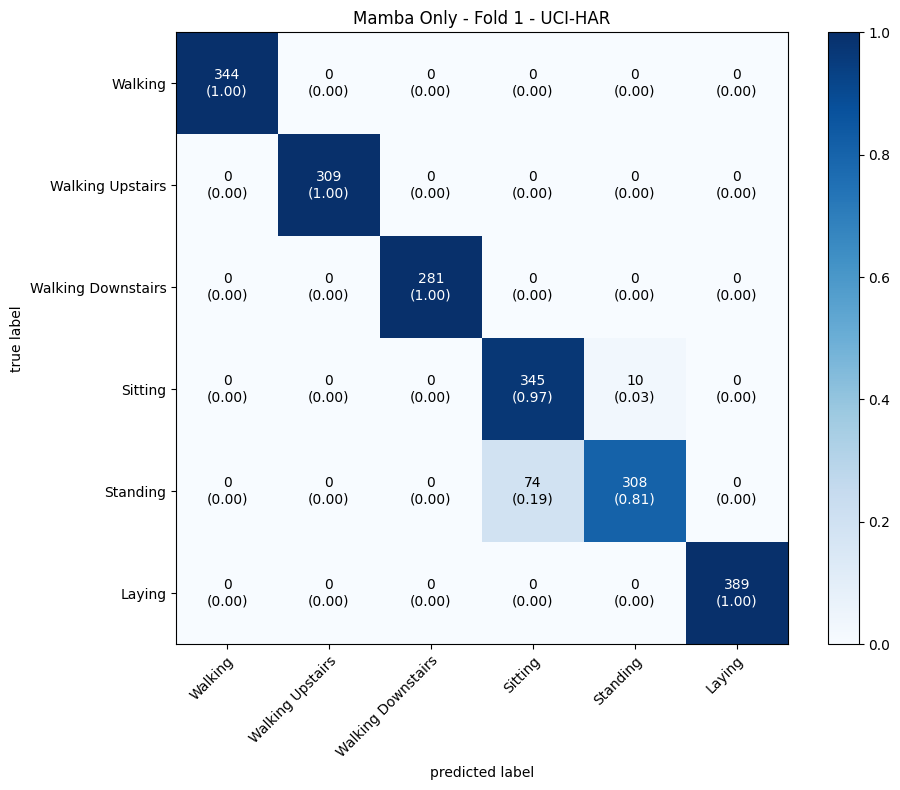


Fold 2/5
Model parameters: 228,510
START
Epoch 1/100 - Train Loss: 1.3179, Train Acc: 0.6713, Val Loss: 1.2985, Val Acc: 0.7238, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8680, Train Acc: 0.8872, Val Loss: 1.0134, Val Acc: 0.7117, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6449, Train Acc: 0.9391, Val Loss: 0.6305, Val Acc: 0.9282, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5700, Train Acc: 0.9482, Val Loss: 0.5929, Val Acc: 0.9112, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5482, Train Acc: 0.9490, Val Loss: 0.5394, Val Acc: 0.9379, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5428, Train Acc: 0.9548, Val Loss: 0.5234, Val Acc: 0.9422, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5366, Train Acc: 0.9566, Val Loss: 0.6065, Val Acc: 0.9005, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5301, Train Acc: 0.9578, Val Loss: 0.6451, Val Acc: 0.8893, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5350, Train Acc: 0.9574, Val Loss: 0.5257, Val Acc: 0.9340, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5312, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

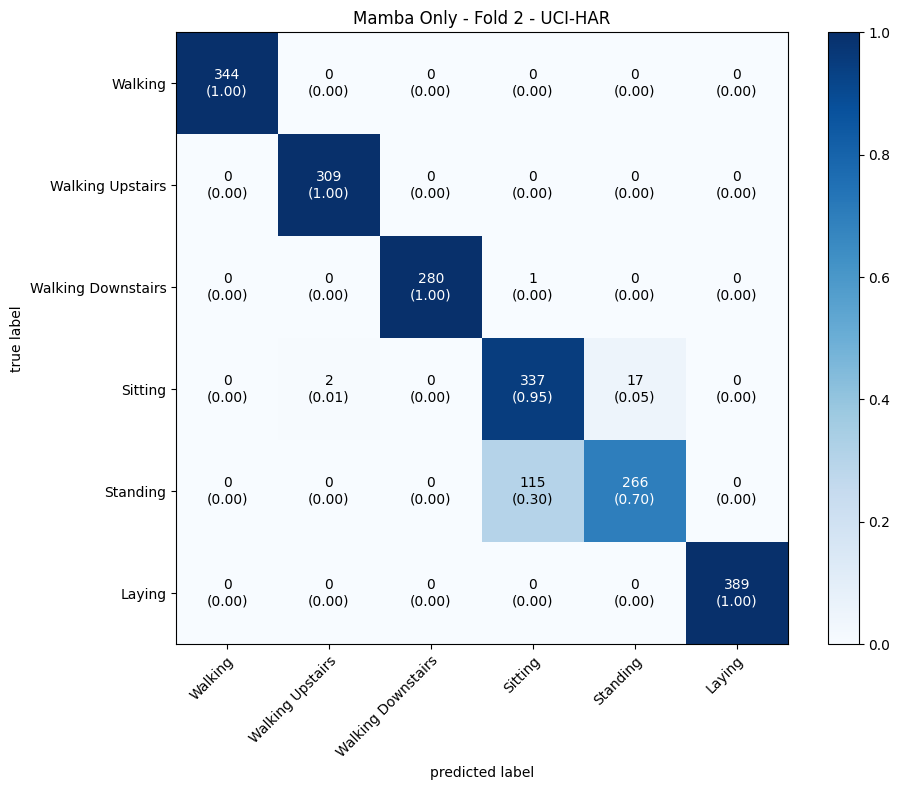


Fold 3/5
Model parameters: 228,510
START
Epoch 1/100 - Train Loss: 1.3517, Train Acc: 0.6834, Val Loss: 1.2688, Val Acc: 0.7791, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8955, Train Acc: 0.8602, Val Loss: 0.8201, Val Acc: 0.8646, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6654, Train Acc: 0.9320, Val Loss: 0.6220, Val Acc: 0.8990, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5842, Train Acc: 0.9447, Val Loss: 0.6510, Val Acc: 0.8782, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5592, Train Acc: 0.9490, Val Loss: 0.5650, Val Acc: 0.9204, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5559, Train Acc: 0.9511, Val Loss: 0.5521, Val Acc: 0.9320, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5393, Train Acc: 0.9563, Val Loss: 0.5220, Val Acc: 0.9442, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5345, Train Acc: 0.9571, Val Loss: 0.5278, Val Acc: 0.9330, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5369, Train Acc: 0.9560, Val Loss: 0.5162, Val Acc: 0.9456, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5294, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

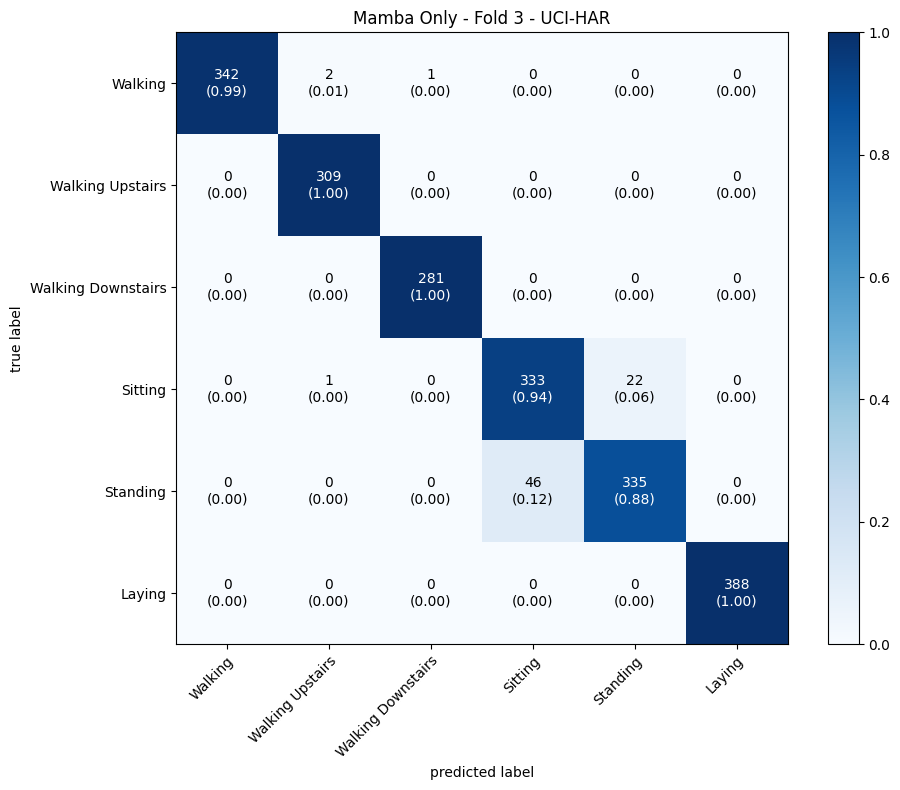


Fold 4/5
Model parameters: 228,510
START
Epoch 1/100 - Train Loss: 1.3476, Train Acc: 0.6653, Val Loss: 1.3141, Val Acc: 0.7102, LR: 0.000994
Epoch 2/100 - Train Loss: 0.9536, Train Acc: 0.8318, Val Loss: 0.8294, Val Acc: 0.8495, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7030, Train Acc: 0.9252, Val Loss: 0.7062, Val Acc: 0.8592, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5951, Train Acc: 0.9440, Val Loss: 0.5556, Val Acc: 0.9383, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5628, Train Acc: 0.9497, Val Loss: 0.5620, Val Acc: 0.9267, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5509, Train Acc: 0.9519, Val Loss: 0.5107, Val Acc: 0.9534, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5404, Train Acc: 0.9548, Val Loss: 0.5175, Val Acc: 0.9476, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5418, Train Acc: 0.9550, Val Loss: 0.5395, Val Acc: 0.9238, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5297, Train Acc: 0.9594, Val Loss: 0.5206, Val Acc: 0.9505, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5307, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

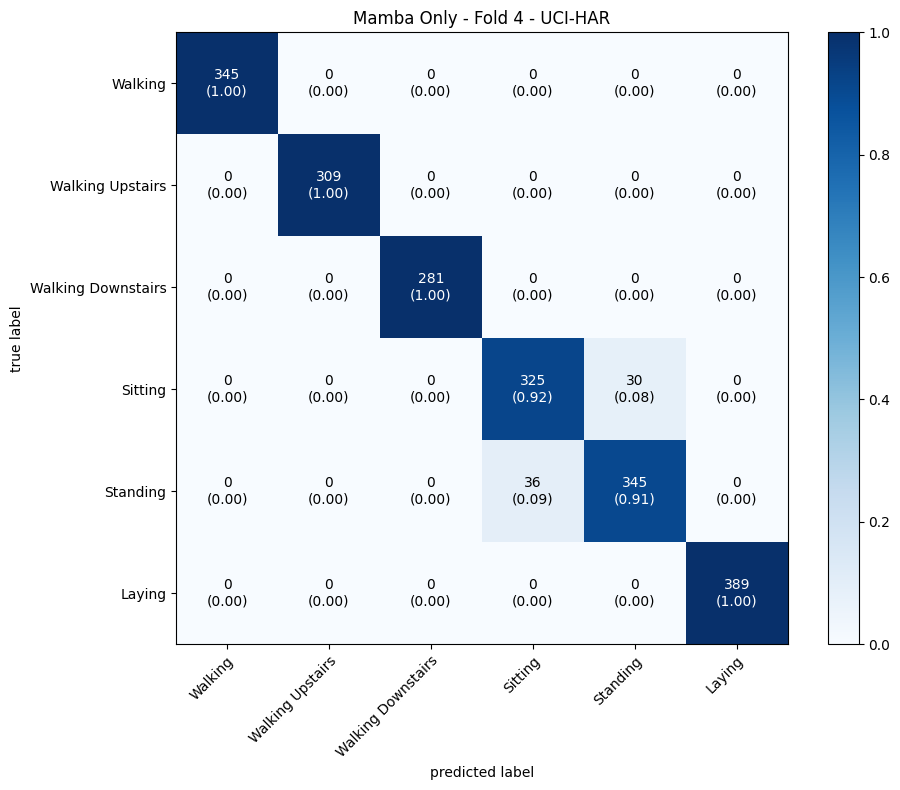


Fold 5/5
Model parameters: 228,510
START
Epoch 1/100 - Train Loss: 1.3235, Train Acc: 0.6924, Val Loss: 1.2507, Val Acc: 0.7655, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8641, Train Acc: 0.8617, Val Loss: 0.8127, Val Acc: 0.8675, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6565, Train Acc: 0.9343, Val Loss: 0.9421, Val Acc: 0.7019, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5777, Train Acc: 0.9451, Val Loss: 0.6117, Val Acc: 0.8976, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5547, Train Acc: 0.9521, Val Loss: 0.5143, Val Acc: 0.9524, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5449, Train Acc: 0.9561, Val Loss: 0.5329, Val Acc: 0.9408, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5477, Train Acc: 0.9508, Val Loss: 0.5378, Val Acc: 0.9330, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5440, Train Acc: 0.9540, Val Loss: 0.5074, Val Acc: 0.9495, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5326, Train Acc: 0.9613, Val Loss: 0.5046, Val Acc: 0.9519, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5319, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

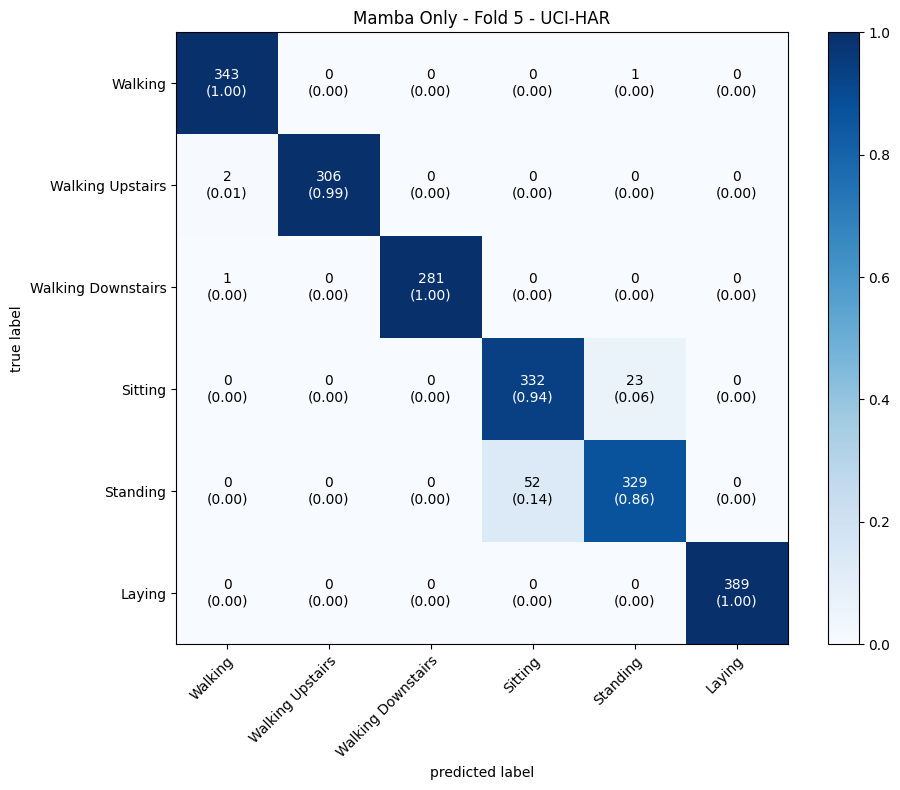


Generating t-SNE for Mamba Only using full training data...
t-SNE input shape: (10299, 288)
Running t-SNE for Mamba Only...


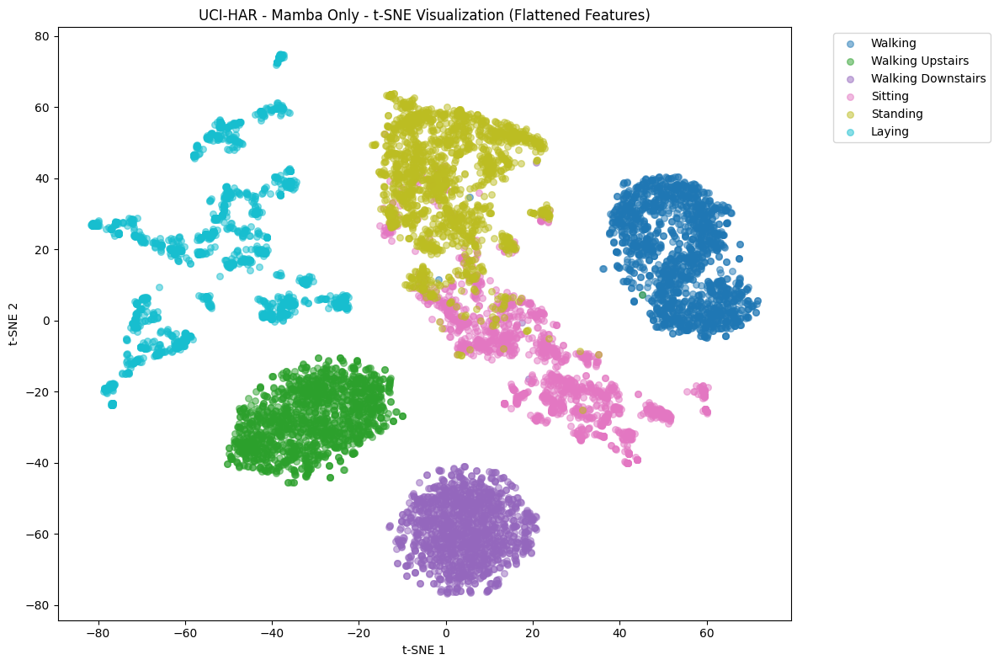


Mamba Only Average Results:
Accuracy: 0.9577, F1: 0.9575
Precision: 0.9607, Recall: 0.9577
Sensitivity: 0.9611, Specificity: 0.9914
Parameters: 228,510

--- CBAM-Patch-Mamba ---

Fold 1/5
Model parameters: 228,561
START
Epoch 1/100 - Train Loss: 1.3275, Train Acc: 0.6867, Val Loss: 1.8974, Val Acc: 0.2908, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8638, Train Acc: 0.8697, Val Loss: 0.9836, Val Acc: 0.7631, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6549, Train Acc: 0.9306, Val Loss: 0.7731, Val Acc: 0.8350, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5740, Train Acc: 0.9443, Val Loss: 0.6006, Val Acc: 0.9000, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5555, Train Acc: 0.9506, Val Loss: 0.5499, Val Acc: 0.9408, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5500, Train Acc: 0.9502, Val Loss: 0.5170, Val Acc: 0.9490, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5432, Train Acc: 0.9513, Val Loss: 0.5135, Val Acc: 0.9495, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5377, Train Acc: 0.9558, Val Loss: 0.5449, V

<Figure size 1000x800 with 0 Axes>

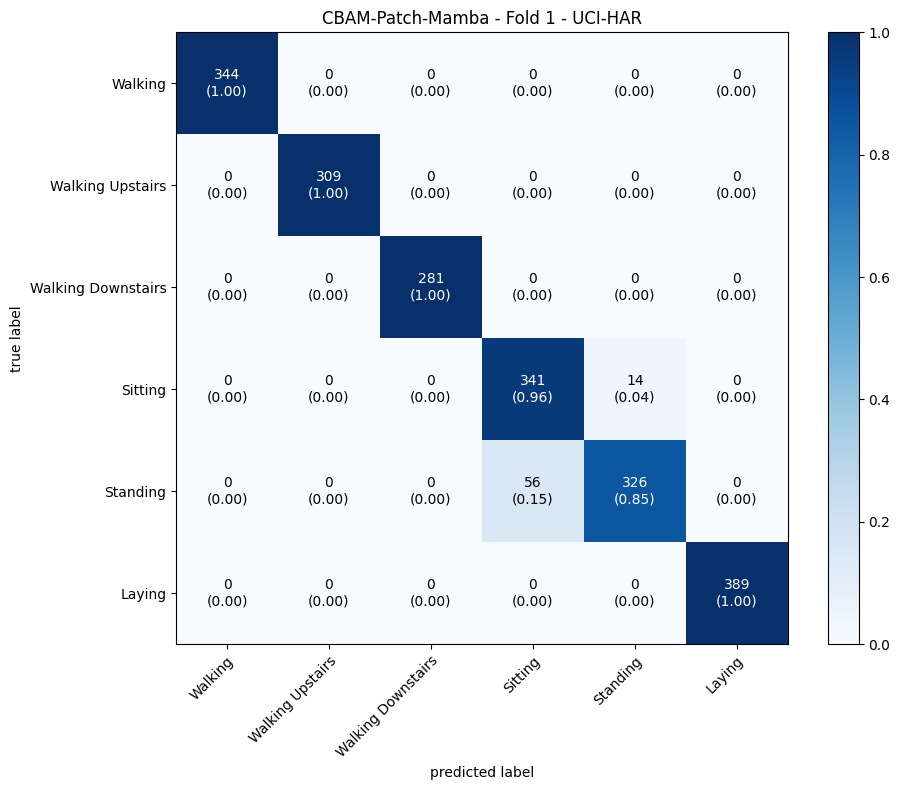


Fold 2/5
Model parameters: 228,561
START
Epoch 1/100 - Train Loss: 1.3567, Train Acc: 0.6833, Val Loss: 1.9039, Val Acc: 0.2733, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8921, Train Acc: 0.8741, Val Loss: 1.2143, Val Acc: 0.5937, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6448, Train Acc: 0.9383, Val Loss: 1.1999, Val Acc: 0.6752, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5785, Train Acc: 0.9463, Val Loss: 0.7711, Val Acc: 0.8165, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5486, Train Acc: 0.9518, Val Loss: 0.5965, Val Acc: 0.9097, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5519, Train Acc: 0.9511, Val Loss: 0.5423, Val Acc: 0.9398, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5395, Train Acc: 0.9524, Val Loss: 0.8153, Val Acc: 0.8063, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5437, Train Acc: 0.9529, Val Loss: 0.5361, Val Acc: 0.9447, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5390, Train Acc: 0.9560, Val Loss: 0.6161, Val Acc: 0.8937, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5362, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

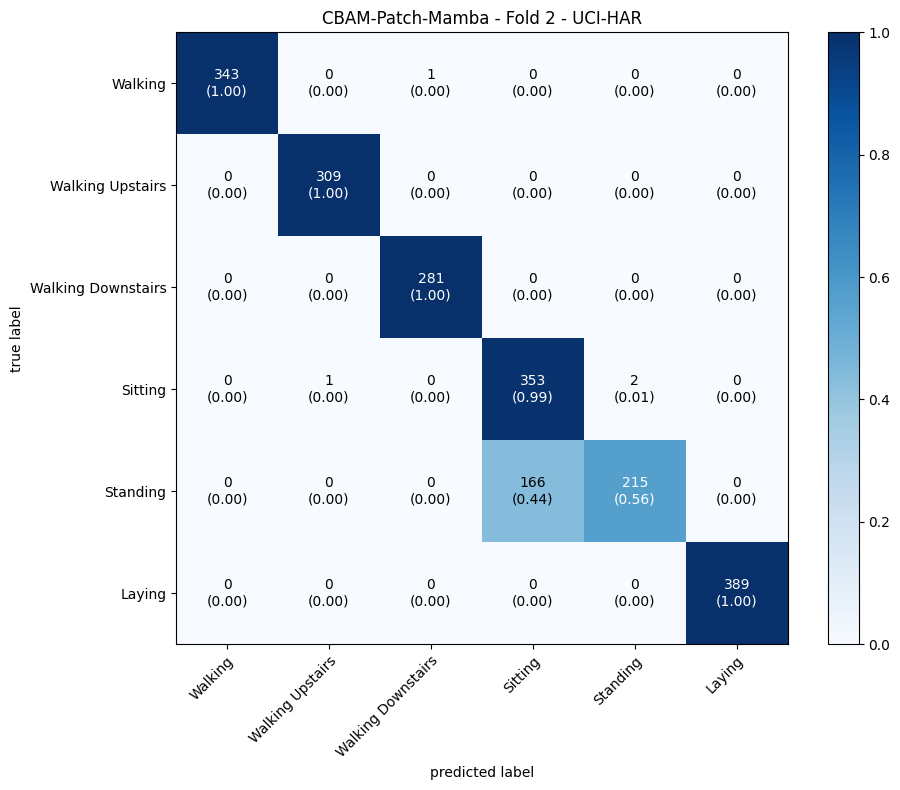


Fold 3/5
Model parameters: 228,561
START
Epoch 1/100 - Train Loss: 1.3465, Train Acc: 0.6825, Val Loss: 1.8801, Val Acc: 0.2796, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8834, Train Acc: 0.8675, Val Loss: 1.1871, Val Acc: 0.6369, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6466, Train Acc: 0.9356, Val Loss: 0.6136, Val Acc: 0.9223, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5750, Train Acc: 0.9459, Val Loss: 0.8301, Val Acc: 0.7738, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5550, Train Acc: 0.9503, Val Loss: 0.6673, Val Acc: 0.8767, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5474, Train Acc: 0.9531, Val Loss: 0.5301, Val Acc: 0.9442, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5407, Train Acc: 0.9527, Val Loss: 0.5671, Val Acc: 0.9214, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5424, Train Acc: 0.9513, Val Loss: 0.5518, Val Acc: 0.9223, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5340, Train Acc: 0.9555, Val Loss: 0.5254, Val Acc: 0.9447, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5368, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

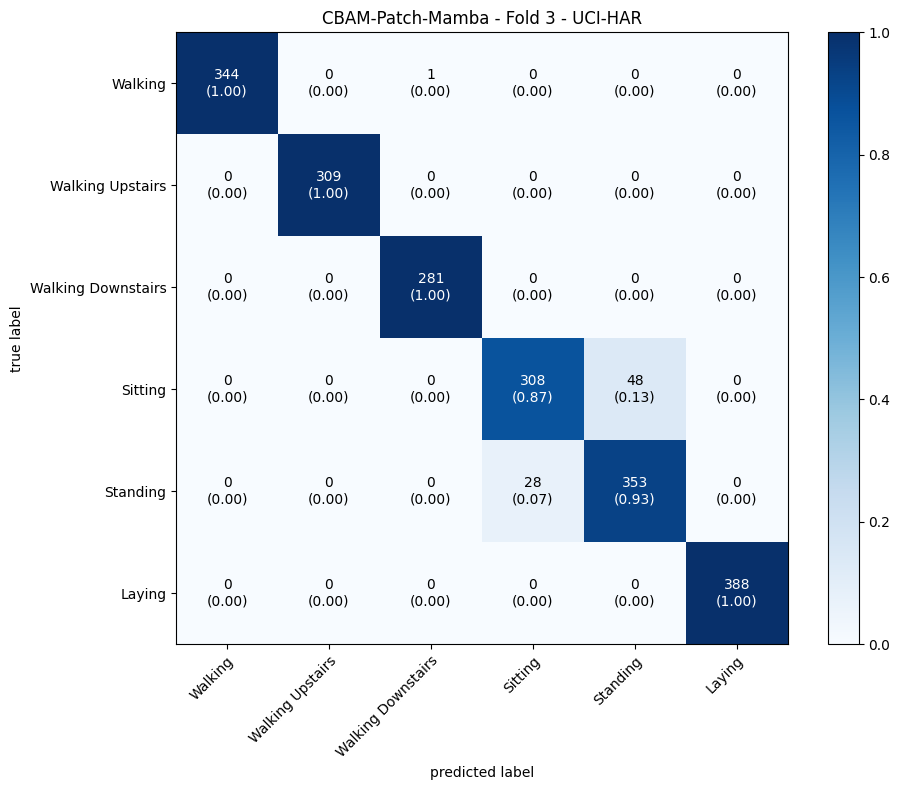


Fold 4/5
Model parameters: 228,561
START
Epoch 1/100 - Train Loss: 1.3602, Train Acc: 0.6815, Val Loss: 1.7990, Val Acc: 0.2995, LR: 0.000994
Epoch 2/100 - Train Loss: 0.9196, Train Acc: 0.8283, Val Loss: 1.0235, Val Acc: 0.7927, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7031, Train Acc: 0.9213, Val Loss: 0.6338, Val Acc: 0.8985, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5975, Train Acc: 0.9427, Val Loss: 0.5569, Val Acc: 0.9252, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5599, Train Acc: 0.9482, Val Loss: 0.5213, Val Acc: 0.9408, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5573, Train Acc: 0.9490, Val Loss: 0.5195, Val Acc: 0.9427, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5477, Train Acc: 0.9547, Val Loss: 0.5102, Val Acc: 0.9529, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5400, Train Acc: 0.9502, Val Loss: 0.5404, Val Acc: 0.9286, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5401, Train Acc: 0.9540, Val Loss: 0.5110, Val Acc: 0.9524, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5297, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

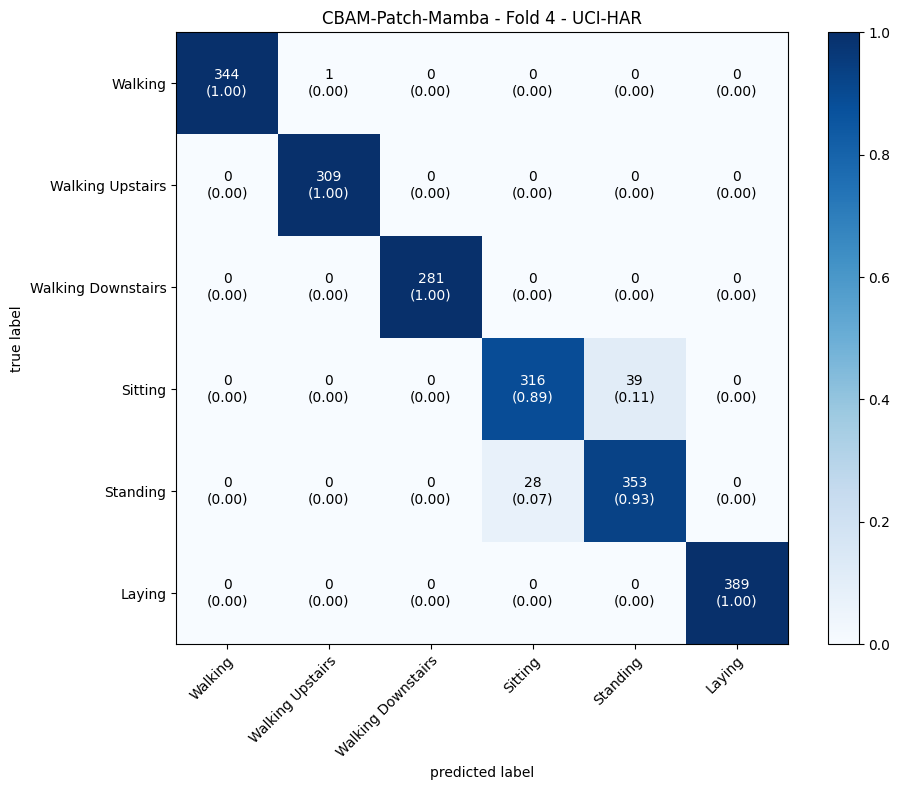


Fold 5/5
Model parameters: 228,561
START
Epoch 1/100 - Train Loss: 1.3283, Train Acc: 0.6856, Val Loss: 1.8122, Val Acc: 0.2481, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8678, Train Acc: 0.8775, Val Loss: 0.9135, Val Acc: 0.8617, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6577, Train Acc: 0.9332, Val Loss: 0.6393, Val Acc: 0.8995, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5789, Train Acc: 0.9463, Val Loss: 0.6329, Val Acc: 0.9141, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5548, Train Acc: 0.9506, Val Loss: 0.5217, Val Acc: 0.9485, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5410, Train Acc: 0.9552, Val Loss: 0.5362, Val Acc: 0.9403, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5449, Train Acc: 0.9508, Val Loss: 0.5155, Val Acc: 0.9485, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5365, Train Acc: 0.9555, Val Loss: 0.5099, Val Acc: 0.9515, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5292, Train Acc: 0.9578, Val Loss: 0.5235, Val Acc: 0.9456, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5252, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

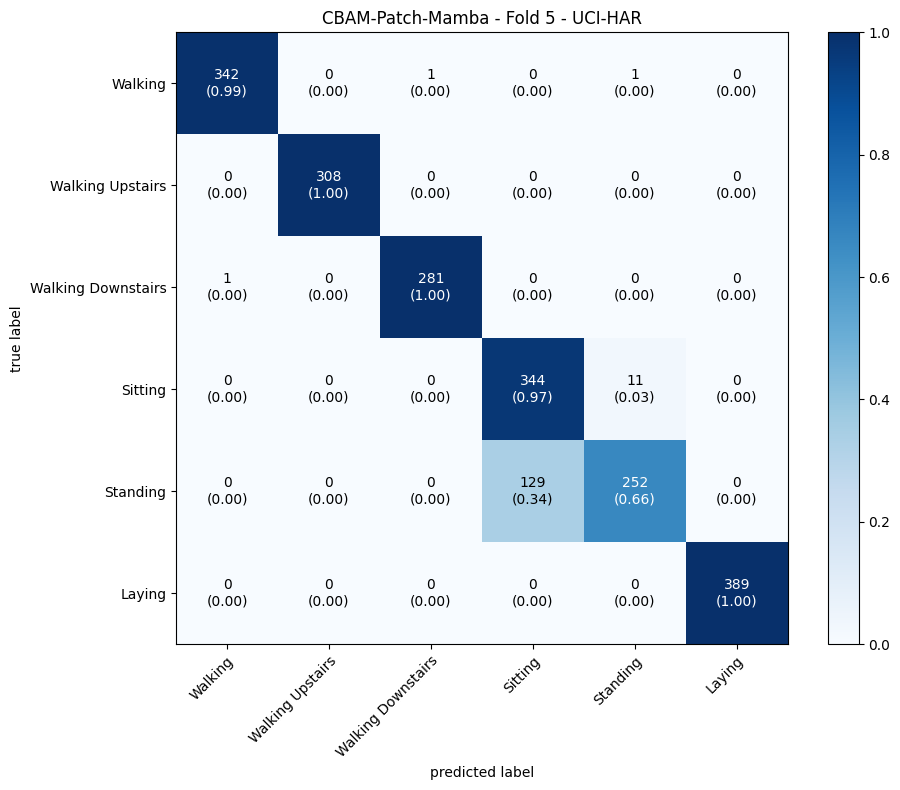


Generating t-SNE for CBAM-Patch-Mamba using full training data...
t-SNE input shape: (10299, 288)
Running t-SNE for CBAM-Patch-Mamba...


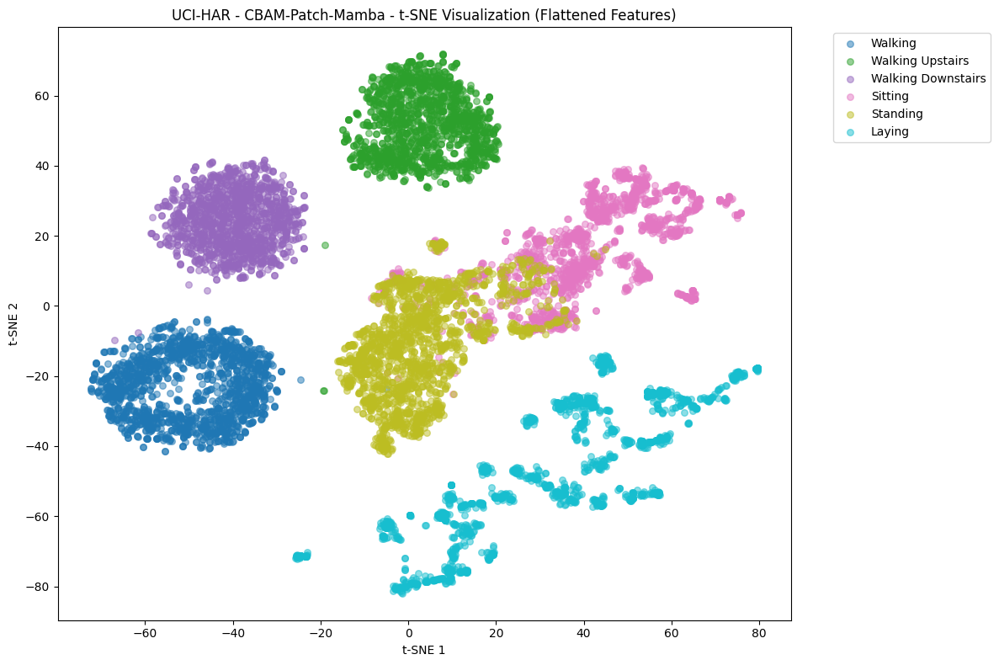


CBAM-Patch-Mamba Average Results:
Accuracy: 0.9487, F1: 0.9477
Precision: 0.9568, Recall: 0.9487
Sensitivity: 0.9530, Specificity: 0.9896
Parameters: 228,561

--- CBAM-Patch-Mamba-ContextAware ---

Fold 1/5
Model parameters: 346,421
START
Epoch 1/100 - Train Loss: 1.0222, Train Acc: 0.7184, Val Loss: 2.3193, Val Acc: 0.2898, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6663, Train Acc: 0.9010, Val Loss: 0.9055, Val Acc: 0.7830, LR: 0.000976
Epoch 3/100 - Train Loss: 0.5761, Train Acc: 0.9379, Val Loss: 0.5780, Val Acc: 0.9257, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5529, Train Acc: 0.9432, Val Loss: 0.5452, Val Acc: 0.9408, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5366, Train Acc: 0.9510, Val Loss: 0.5506, Val Acc: 0.9456, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5328, Train Acc: 0.9514, Val Loss: 0.5440, Val Acc: 0.9374, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5243, Train Acc: 0.9511, Val Loss: 0.5333, Val Acc: 0.9417, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5196, Train Acc: 0.9544, 

<Figure size 1000x800 with 0 Axes>

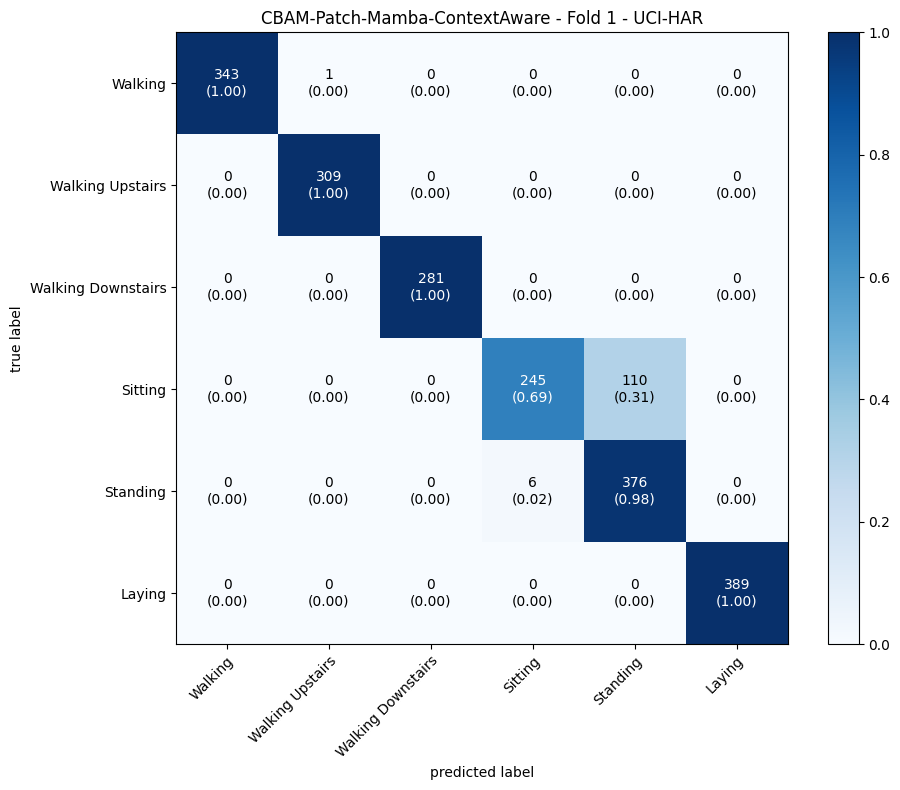


Fold 2/5
Model parameters: 346,421
START
Epoch 1/100 - Train Loss: 1.0283, Train Acc: 0.7087, Val Loss: 2.3138, Val Acc: 0.2951, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6681, Train Acc: 0.9044, Val Loss: 0.9284, Val Acc: 0.7427, LR: 0.000976
Epoch 3/100 - Train Loss: 0.5695, Train Acc: 0.9400, Val Loss: 0.6177, Val Acc: 0.9238, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5423, Train Acc: 0.9479, Val Loss: 0.5497, Val Acc: 0.9461, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5380, Train Acc: 0.9519, Val Loss: 0.5818, Val Acc: 0.9262, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5302, Train Acc: 0.9503, Val Loss: 0.5589, Val Acc: 0.9364, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5245, Train Acc: 0.9553, Val Loss: 0.6621, Val Acc: 0.8966, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5188, Train Acc: 0.9573, Val Loss: 0.5267, Val Acc: 0.9461, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5181, Train Acc: 0.9589, Val Loss: 0.5470, Val Acc: 0.9398, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5130, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

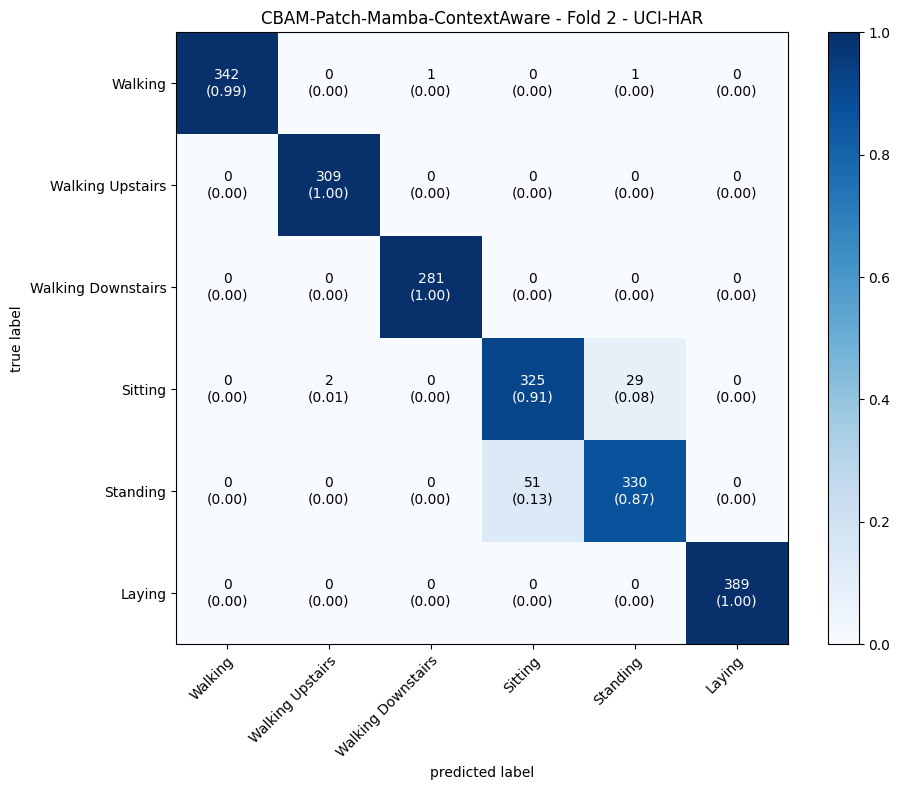


Fold 3/5
Model parameters: 346,421
START
Epoch 1/100 - Train Loss: 1.0117, Train Acc: 0.7262, Val Loss: 1.6293, Val Acc: 0.3971, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6546, Train Acc: 0.9094, Val Loss: 0.7838, Val Acc: 0.8189, LR: 0.000976
Epoch 3/100 - Train Loss: 0.5700, Train Acc: 0.9422, Val Loss: 0.6281, Val Acc: 0.8976, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5457, Train Acc: 0.9502, Val Loss: 0.5552, Val Acc: 0.9379, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5377, Train Acc: 0.9523, Val Loss: 0.5514, Val Acc: 0.9456, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5289, Train Acc: 0.9532, Val Loss: 0.5465, Val Acc: 0.9408, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5194, Train Acc: 0.9573, Val Loss: 0.5361, Val Acc: 0.9359, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5230, Train Acc: 0.9550, Val Loss: 0.5439, Val Acc: 0.9495, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5194, Train Acc: 0.9545, Val Loss: 0.5342, Val Acc: 0.9422, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5129, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

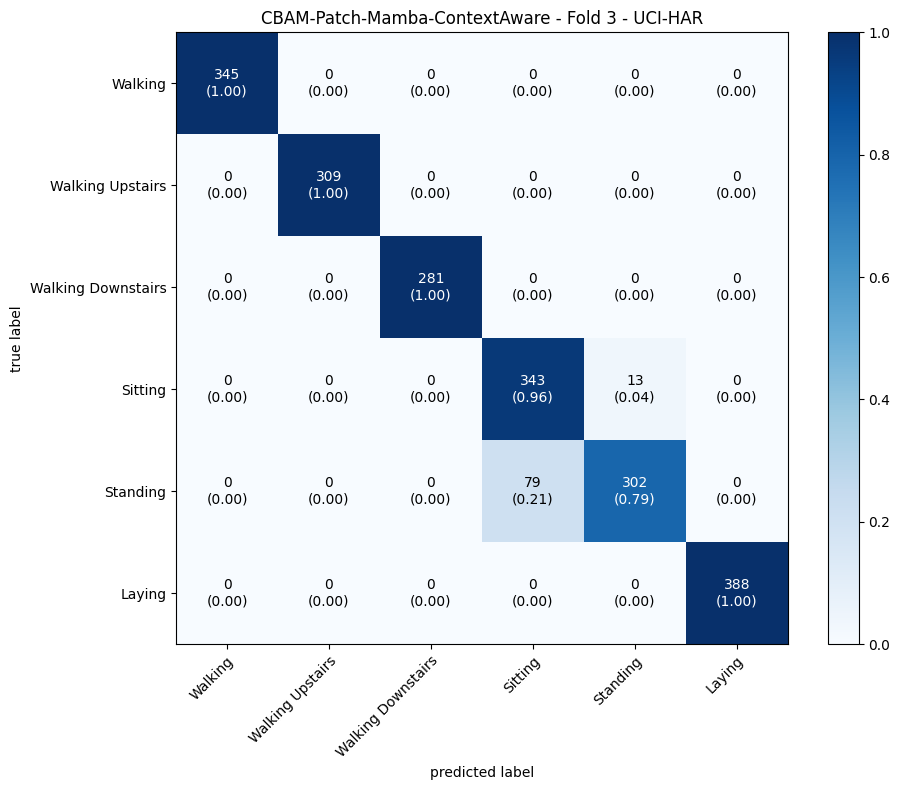


Fold 4/5
Model parameters: 346,421
START
Epoch 1/100 - Train Loss: 1.0018, Train Acc: 0.7365, Val Loss: 2.3269, Val Acc: 0.2563, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6442, Train Acc: 0.9118, Val Loss: 0.9174, Val Acc: 0.7534, LR: 0.000976
Epoch 3/100 - Train Loss: 0.5693, Train Acc: 0.9434, Val Loss: 0.5812, Val Acc: 0.9277, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5446, Train Acc: 0.9495, Val Loss: 0.5625, Val Acc: 0.9432, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5337, Train Acc: 0.9493, Val Loss: 0.5361, Val Acc: 0.9345, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5332, Train Acc: 0.9536, Val Loss: 0.5289, Val Acc: 0.9519, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5282, Train Acc: 0.9527, Val Loss: 0.5280, Val Acc: 0.9500, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5191, Train Acc: 0.9532, Val Loss: 0.5274, Val Acc: 0.9539, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5211, Train Acc: 0.9557, Val Loss: 0.5419, Val Acc: 0.9476, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5151, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

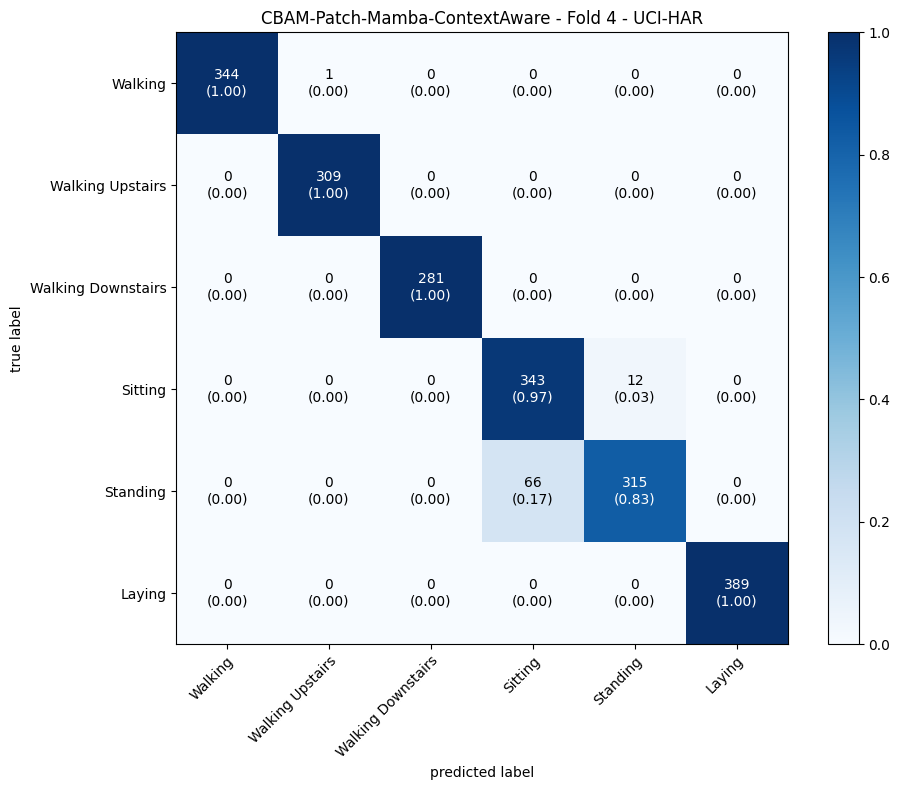


Fold 5/5
Model parameters: 346,421
START
Epoch 1/100 - Train Loss: 1.0298, Train Acc: 0.7168, Val Loss: 2.4004, Val Acc: 0.3073, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6618, Train Acc: 0.9074, Val Loss: 1.0564, Val Acc: 0.6233, LR: 0.000976
Epoch 3/100 - Train Loss: 0.5669, Train Acc: 0.9405, Val Loss: 0.5963, Val Acc: 0.9126, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5388, Train Acc: 0.9532, Val Loss: 0.6242, Val Acc: 0.9141, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5341, Train Acc: 0.9545, Val Loss: 0.5366, Val Acc: 0.9383, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5262, Train Acc: 0.9544, Val Loss: 0.5299, Val Acc: 0.9466, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5201, Train Acc: 0.9557, Val Loss: 0.5470, Val Acc: 0.9437, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5175, Train Acc: 0.9571, Val Loss: 0.5616, Val Acc: 0.9354, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5133, Train Acc: 0.9568, Val Loss: 0.5577, Val Acc: 0.9422, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5161, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

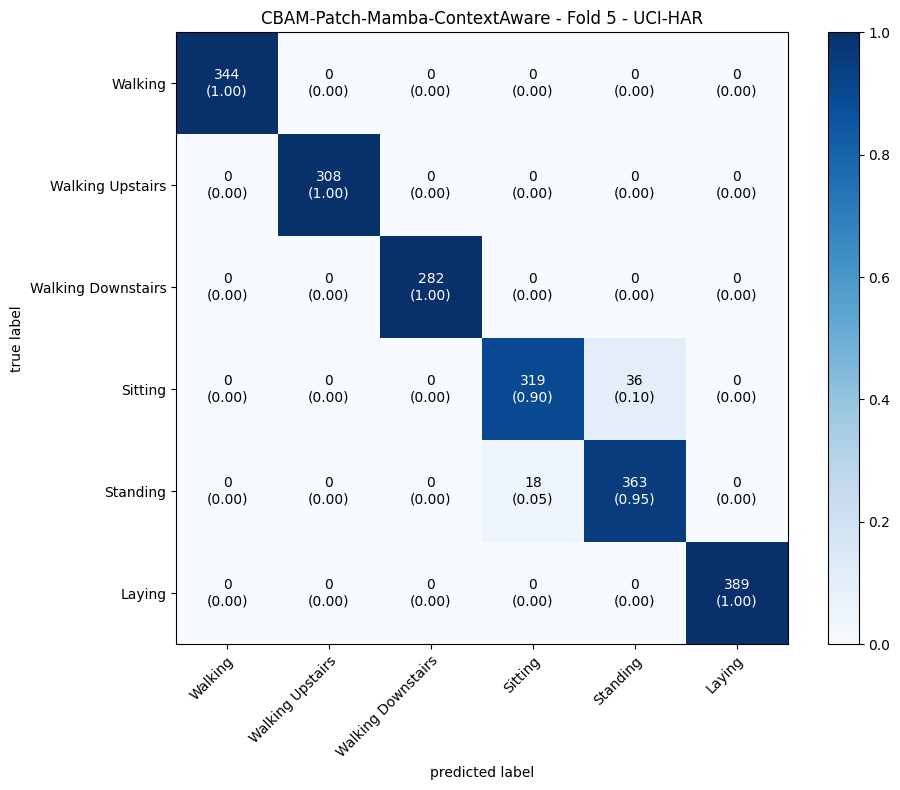


Generating t-SNE for CBAM-Patch-Mamba-ContextAware using full training data...
t-SNE input shape: (10299, 288)
Running t-SNE for CBAM-Patch-Mamba-ContextAware...


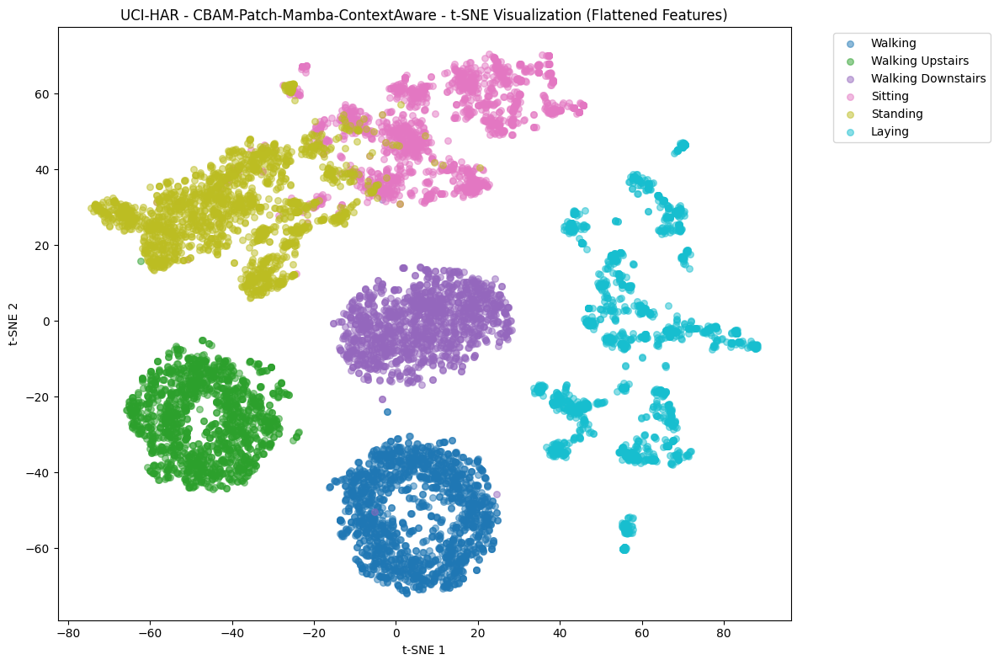


CBAM-Patch-Mamba-ContextAware Average Results:
Accuracy: 0.9586, F1: 0.9583
Precision: 0.9624, Recall: 0.9586
Sensitivity: 0.9614, Specificity: 0.9916
Parameters: 346,421
UCI-HAR ablation study completed!

Processing USC-HAD Dataset

=== Ablation Study for USC-HAD ===
Using device: cuda
Dataset: USC-HAD, Patch size: 20

--- Mamba Only ---

Fold 1/5
Model parameters: 142,385
START
Epoch 1/100 - Train Loss: 1.8158, Train Acc: 0.5059, Val Loss: 1.9461, Val Acc: 0.2921, LR: 0.000994
Epoch 2/100 - Train Loss: 1.2837, Train Acc: 0.6627, Val Loss: 1.8258, Val Acc: 0.3673, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0313, Train Acc: 0.7741, Val Loss: 1.1935, Val Acc: 0.6544, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8937, Train Acc: 0.8591, Val Loss: 0.8958, Val Acc: 0.7920, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8207, Train Acc: 0.8913, Val Loss: 0.7963, Val Acc: 0.8637, LR: 0.000854
Epoch 6/100 - Train Loss: 0.7799, Train Acc: 0.9107, Val Loss: 0.7262, Val Acc: 0.9069, LR: 0.000794
Epoch 7/10

<Figure size 1000x800 with 0 Axes>

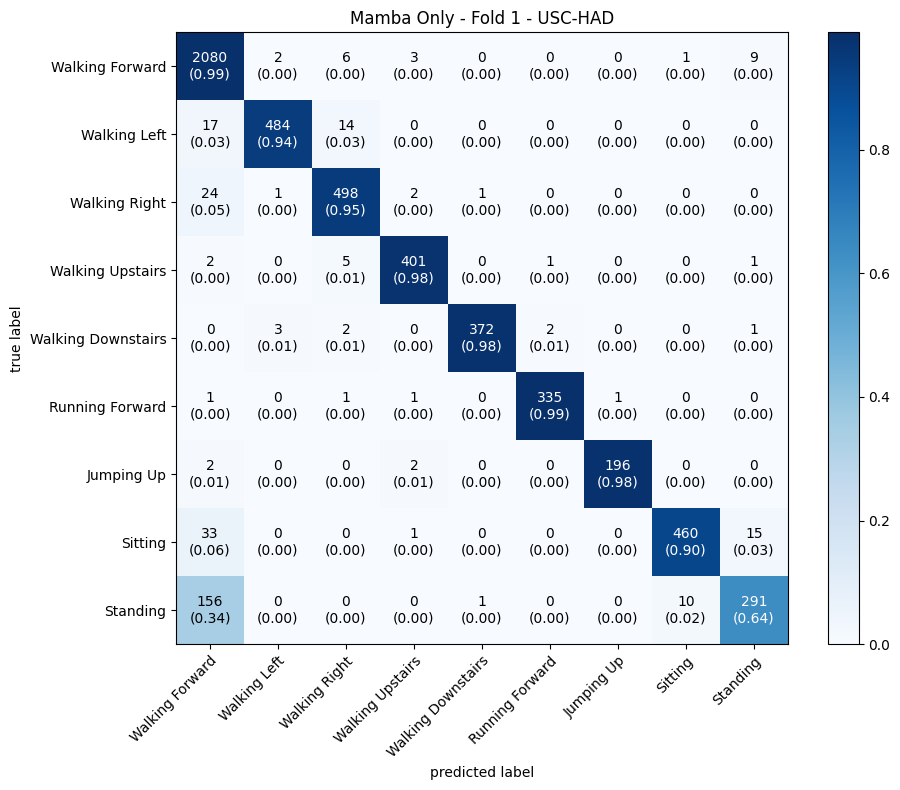


Fold 2/5
Model parameters: 142,385
START
Epoch 1/100 - Train Loss: 1.8007, Train Acc: 0.5145, Val Loss: 1.7884, Val Acc: 0.3637, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3222, Train Acc: 0.6616, Val Loss: 1.2890, Val Acc: 0.6815, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0692, Train Acc: 0.7561, Val Loss: 1.1694, Val Acc: 0.6815, LR: 0.000946
Epoch 4/100 - Train Loss: 0.9183, Train Acc: 0.8470, Val Loss: 1.0133, Val Acc: 0.8099, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8270, Train Acc: 0.8931, Val Loss: 0.7771, Val Acc: 0.8624, LR: 0.000854
Epoch 6/100 - Train Loss: 0.7791, Train Acc: 0.9101, Val Loss: 0.8420, Val Acc: 0.8512, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7501, Train Acc: 0.9228, Val Loss: 0.8204, Val Acc: 0.8547, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7303, Train Acc: 0.9324, Val Loss: 0.6866, Val Acc: 0.9202, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7174, Train Acc: 0.9351, Val Loss: 0.6528, Val Acc: 0.9384, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7018, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

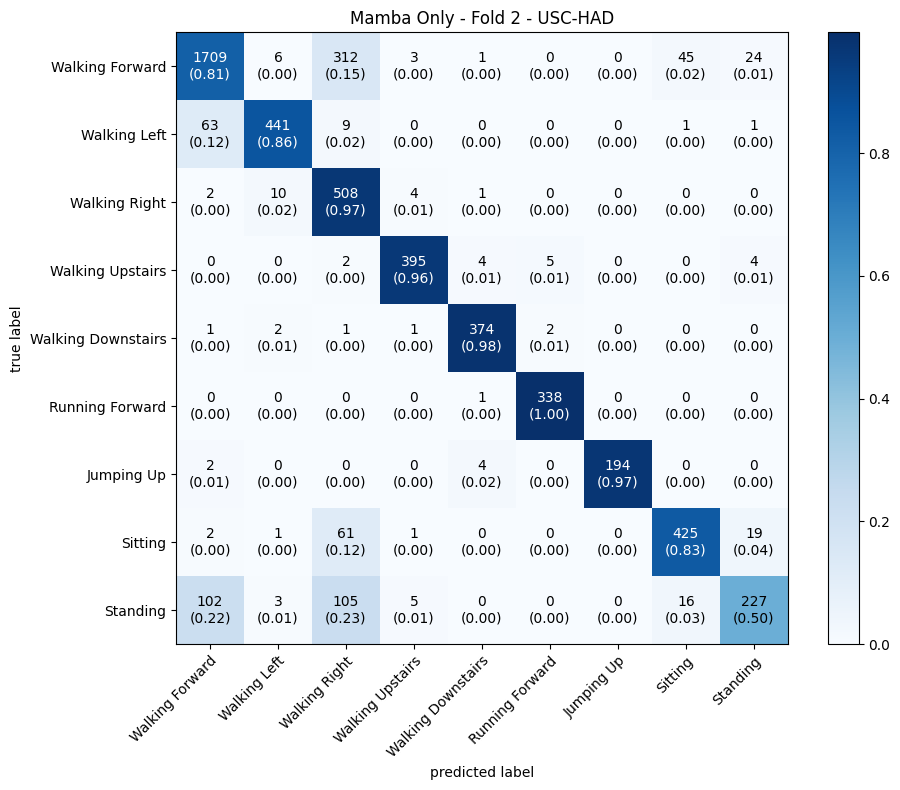


Fold 3/5
Model parameters: 142,385
START
Epoch 1/100 - Train Loss: 1.8226, Train Acc: 0.5212, Val Loss: 1.9311, Val Acc: 0.2819, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3212, Train Acc: 0.6659, Val Loss: 2.0489, Val Acc: 0.3472, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0775, Train Acc: 0.7222, Val Loss: 1.2967, Val Acc: 0.6624, LR: 0.000946
Epoch 4/100 - Train Loss: 0.9697, Train Acc: 0.8084, Val Loss: 1.0655, Val Acc: 0.7639, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8682, Train Acc: 0.8749, Val Loss: 0.8864, Val Acc: 0.8419, LR: 0.000854
Epoch 6/100 - Train Loss: 0.7975, Train Acc: 0.9039, Val Loss: 0.8488, Val Acc: 0.8510, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7658, Train Acc: 0.9160, Val Loss: 0.7556, Val Acc: 0.8882, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7460, Train Acc: 0.9253, Val Loss: 0.7335, Val Acc: 0.8946, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7211, Train Acc: 0.9343, Val Loss: 0.6784, Val Acc: 0.9211, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7160, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

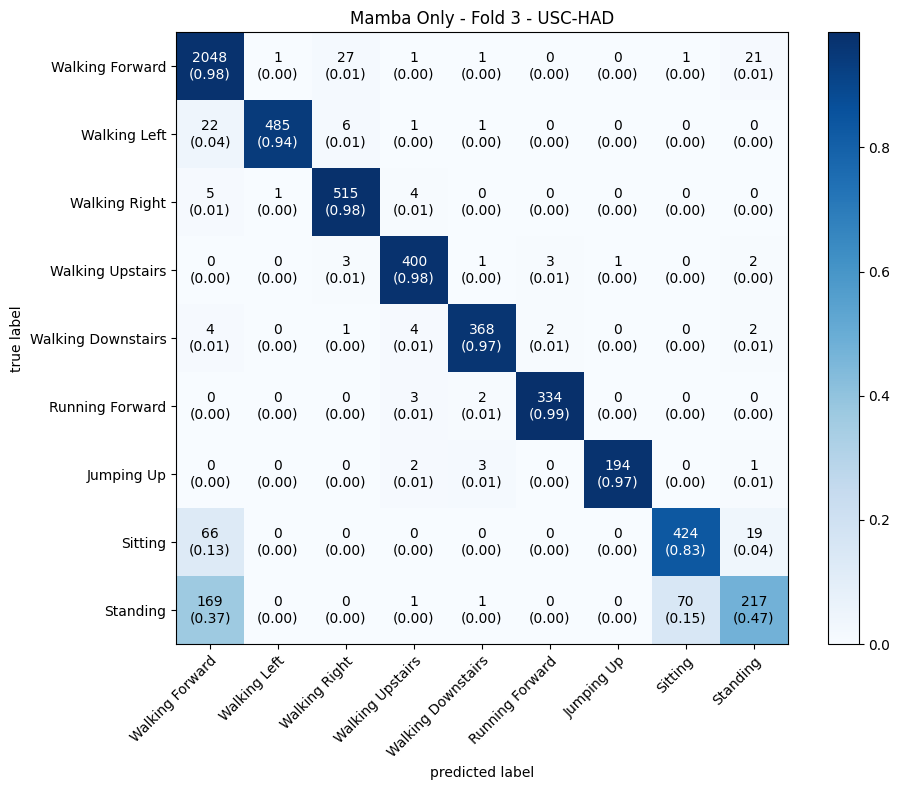


Fold 4/5
Model parameters: 142,385
START
Epoch 1/100 - Train Loss: 1.8086, Train Acc: 0.5159, Val Loss: 1.9953, Val Acc: 0.2997, LR: 0.000994
Epoch 2/100 - Train Loss: 1.2736, Train Acc: 0.6623, Val Loss: 1.5126, Val Acc: 0.4553, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0449, Train Acc: 0.7472, Val Loss: 1.5740, Val Acc: 0.4316, LR: 0.000946
Epoch 4/100 - Train Loss: 0.9281, Train Acc: 0.8256, Val Loss: 1.0751, Val Acc: 0.7194, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8579, Train Acc: 0.8662, Val Loss: 1.0691, Val Acc: 0.7506, LR: 0.000854
Epoch 6/100 - Train Loss: 0.8055, Train Acc: 0.8959, Val Loss: 0.8849, Val Acc: 0.8391, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7714, Train Acc: 0.9128, Val Loss: 0.9264, Val Acc: 0.7894, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7485, Train Acc: 0.9228, Val Loss: 0.8981, Val Acc: 0.7997, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7320, Train Acc: 0.9305, Val Loss: 0.7465, Val Acc: 0.8908, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7145, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

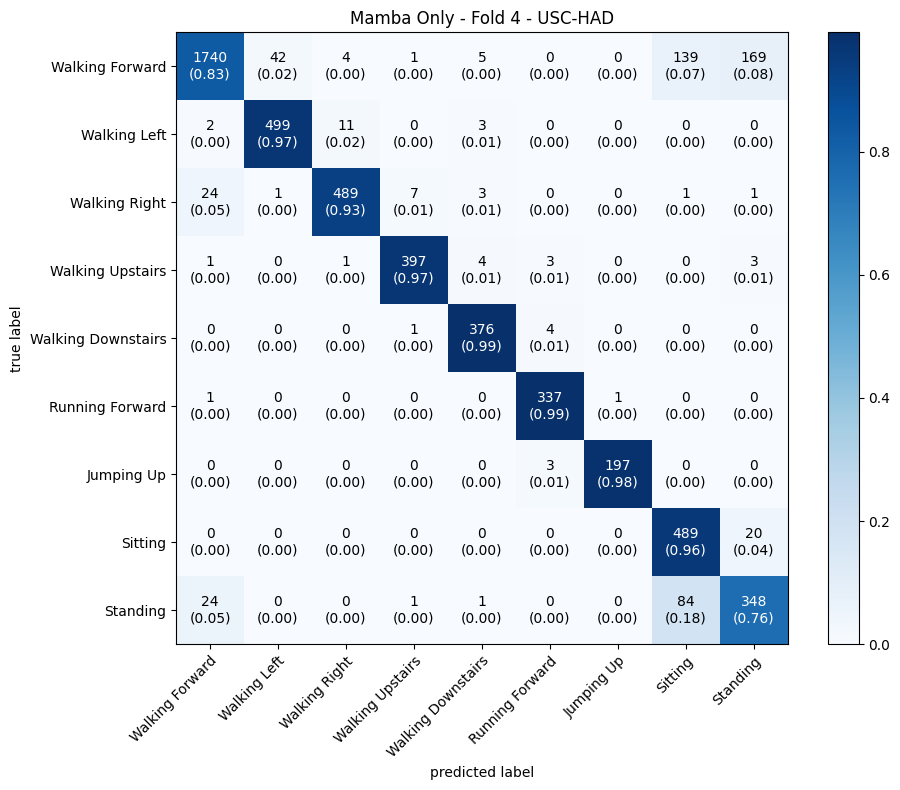


Fold 5/5
Model parameters: 142,385
START
Epoch 1/100 - Train Loss: 1.8304, Train Acc: 0.5132, Val Loss: 1.7896, Val Acc: 0.3946, LR: 0.000994
Epoch 2/100 - Train Loss: 1.2911, Train Acc: 0.6674, Val Loss: 1.6921, Val Acc: 0.4093, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0289, Train Acc: 0.7724, Val Loss: 1.0121, Val Acc: 0.7606, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8985, Train Acc: 0.8532, Val Loss: 0.9850, Val Acc: 0.7791, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8284, Train Acc: 0.8884, Val Loss: 1.0883, Val Acc: 0.7050, LR: 0.000854
Epoch 6/100 - Train Loss: 0.7791, Train Acc: 0.9112, Val Loss: 0.7864, Val Acc: 0.8672, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7547, Train Acc: 0.9195, Val Loss: 0.8666, Val Acc: 0.8496, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7386, Train Acc: 0.9233, Val Loss: 0.7035, Val Acc: 0.9115, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7215, Train Acc: 0.9310, Val Loss: 0.7989, Val Acc: 0.8591, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7087, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

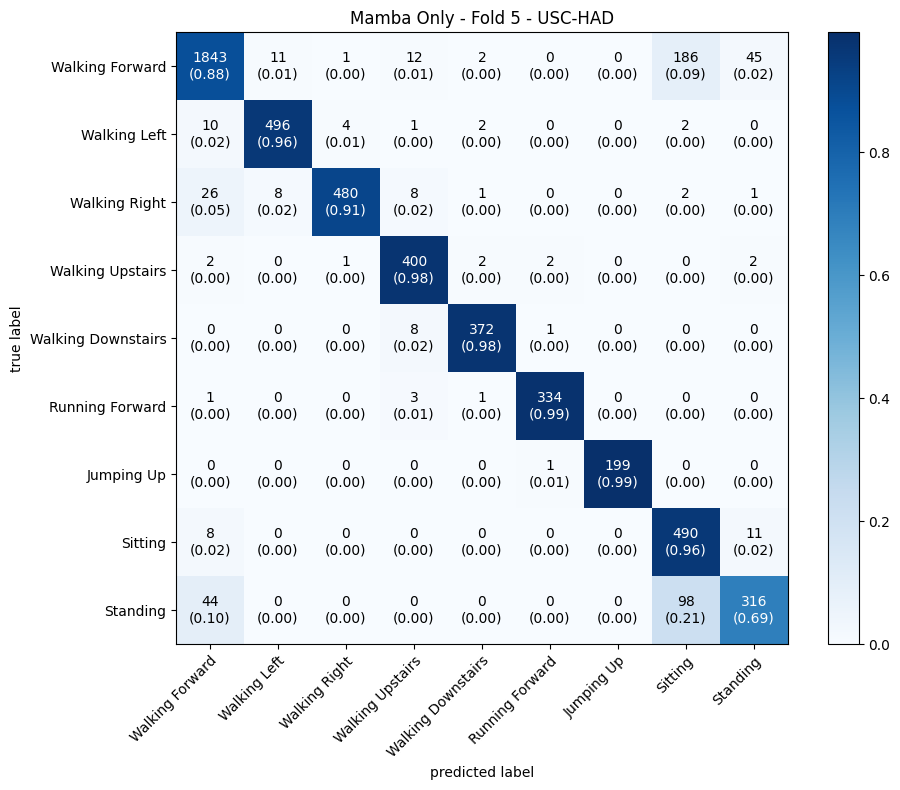


Generating t-SNE for Mamba Only using full training data...
t-SNE input shape: (19685, 120)
Running t-SNE for Mamba Only...


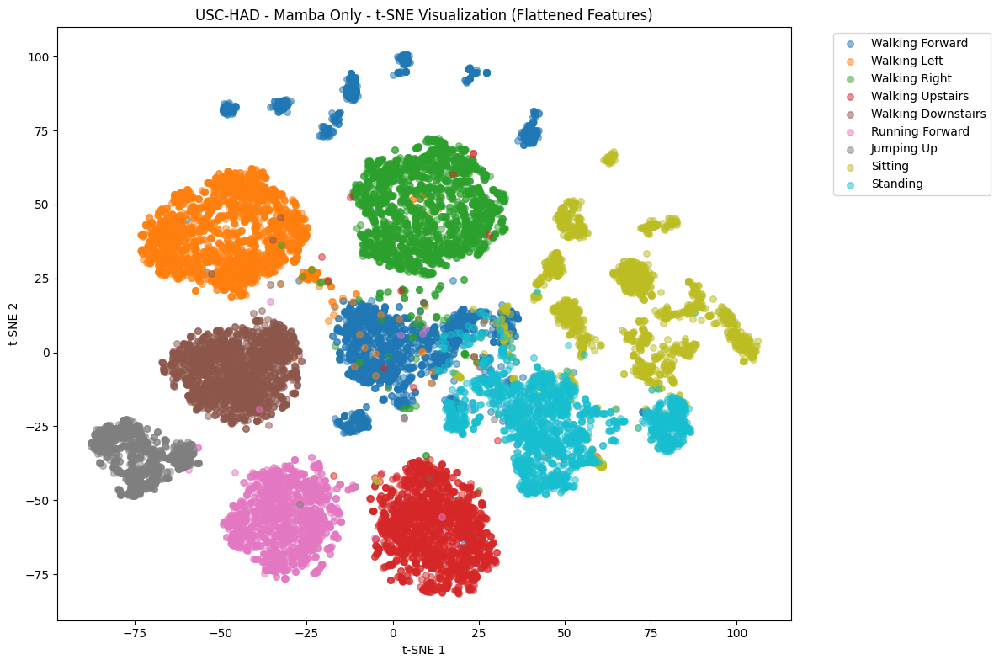


Mamba Only Average Results:
Accuracy: 0.9017, F1: 0.9021
Precision: 0.9143, Recall: 0.9017
Sensitivity: 0.9122, Specificity: 0.9862
Parameters: 142,385

--- CBAM-Patch-Mamba ---

Fold 1/5
Model parameters: 142,412
START
Epoch 1/100 - Train Loss: 1.8216, Train Acc: 0.4962, Val Loss: 2.0056, Val Acc: 0.2924, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3256, Train Acc: 0.6626, Val Loss: 1.7065, Val Acc: 0.4228, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0838, Train Acc: 0.7345, Val Loss: 1.0286, Val Acc: 0.7416, LR: 0.000946
Epoch 4/100 - Train Loss: 0.9622, Train Acc: 0.8053, Val Loss: 1.0400, Val Acc: 0.7795, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8580, Train Acc: 0.8769, Val Loss: 1.1091, Val Acc: 0.6871, LR: 0.000854
Epoch 6/100 - Train Loss: 0.7980, Train Acc: 0.9023, Val Loss: 0.8780, Val Acc: 0.8118, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7667, Train Acc: 0.9131, Val Loss: 0.8468, Val Acc: 0.8120, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7472, Train Acc: 0.9235, Val Loss: 0.6770, V

<Figure size 1000x800 with 0 Axes>

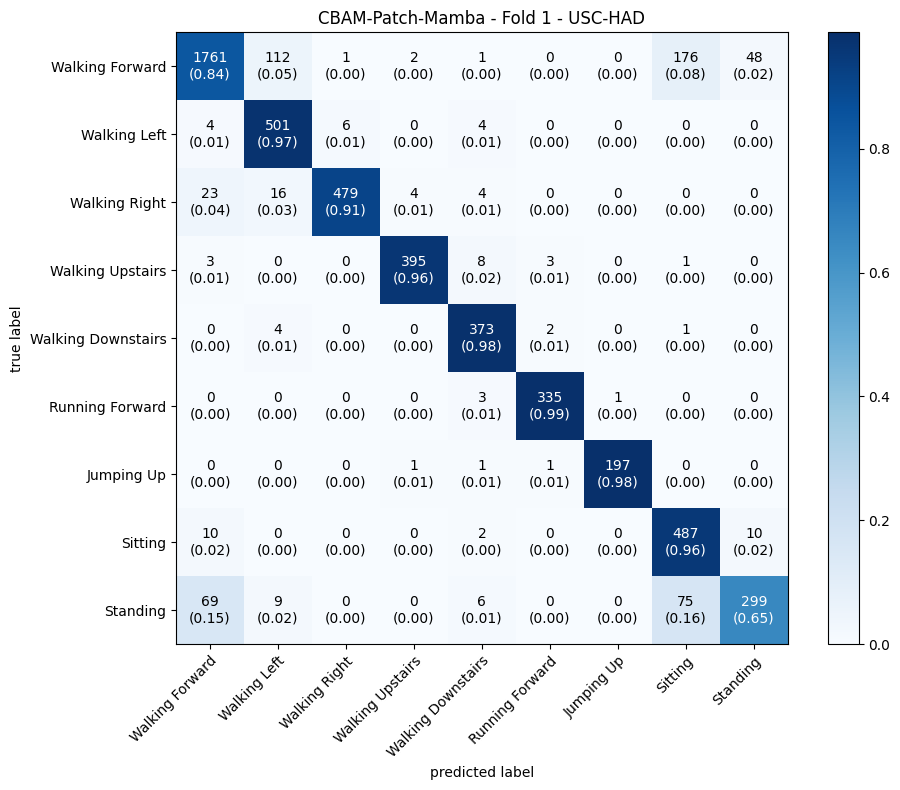


Fold 2/5
Model parameters: 142,412
START
Epoch 1/100 - Train Loss: 1.8236, Train Acc: 0.5401, Val Loss: 2.0348, Val Acc: 0.2523, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3037, Train Acc: 0.6756, Val Loss: 1.4171, Val Acc: 0.6098, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0681, Train Acc: 0.7309, Val Loss: 1.3597, Val Acc: 0.6661, LR: 0.000946
Epoch 4/100 - Train Loss: 0.9554, Train Acc: 0.8072, Val Loss: 1.7601, Val Acc: 0.4195, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8488, Train Acc: 0.8794, Val Loss: 0.8220, Val Acc: 0.8739, LR: 0.000854
Epoch 6/100 - Train Loss: 0.7960, Train Acc: 0.9002, Val Loss: 0.8675, Val Acc: 0.8178, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7665, Train Acc: 0.9158, Val Loss: 0.8861, Val Acc: 0.8323, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7462, Train Acc: 0.9209, Val Loss: 0.7127, Val Acc: 0.9086, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7295, Train Acc: 0.9310, Val Loss: 0.7025, Val Acc: 0.9079, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7126, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

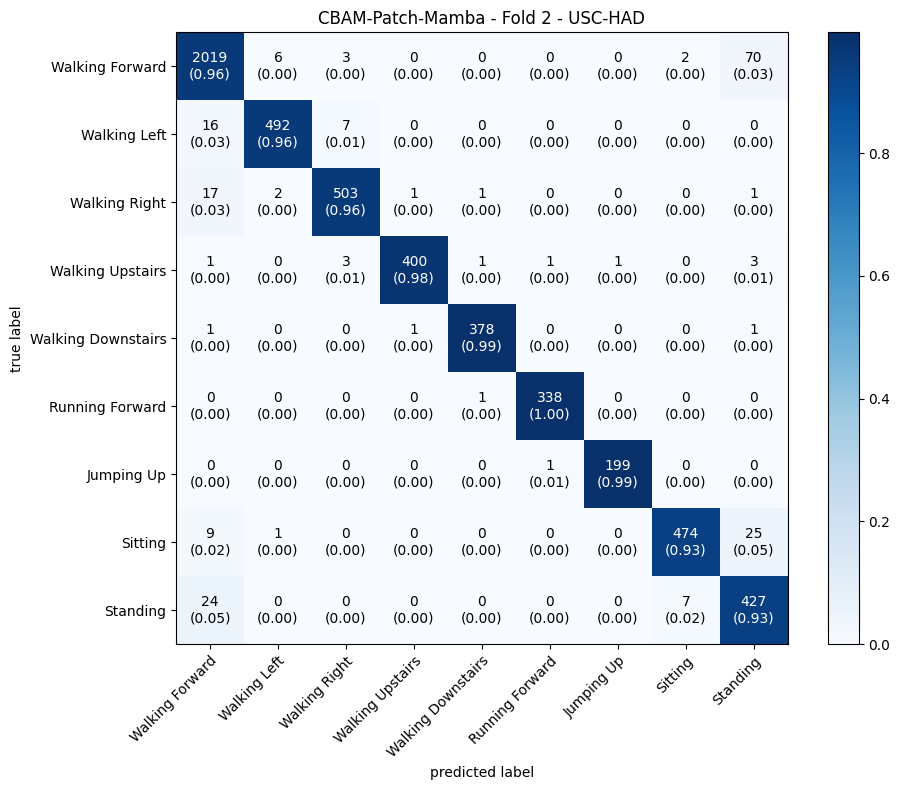


Fold 3/5
Model parameters: 142,412
START
Epoch 1/100 - Train Loss: 1.8322, Train Acc: 0.4968, Val Loss: 1.8947, Val Acc: 0.3045, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3930, Train Acc: 0.6393, Val Loss: 1.7164, Val Acc: 0.3981, LR: 0.000976
Epoch 3/100 - Train Loss: 1.1456, Train Acc: 0.6973, Val Loss: 1.4366, Val Acc: 0.4976, LR: 0.000946
Epoch 4/100 - Train Loss: 1.0033, Train Acc: 0.7817, Val Loss: 1.1410, Val Acc: 0.7087, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8900, Train Acc: 0.8637, Val Loss: 0.9053, Val Acc: 0.8472, LR: 0.000854
Epoch 6/100 - Train Loss: 0.8098, Train Acc: 0.8978, Val Loss: 1.0028, Val Acc: 0.7407, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7692, Train Acc: 0.9170, Val Loss: 0.8038, Val Acc: 0.8700, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7477, Train Acc: 0.9243, Val Loss: 0.9269, Val Acc: 0.8102, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7299, Train Acc: 0.9307, Val Loss: 0.7147, Val Acc: 0.9082, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7194, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

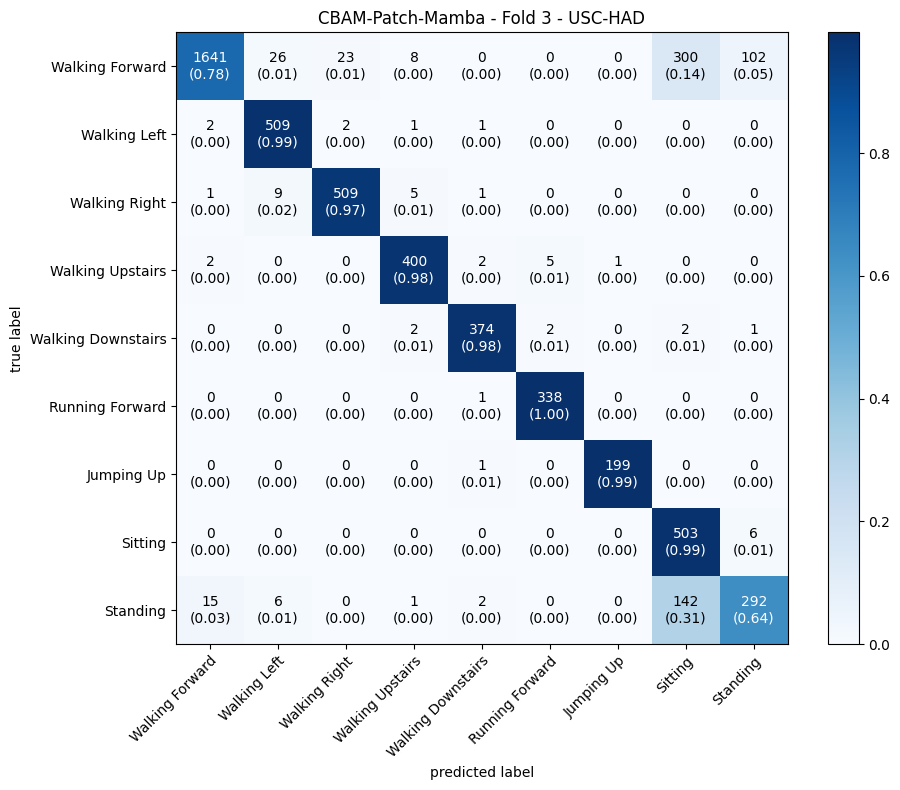


Fold 4/5
Model parameters: 142,412
START
Epoch 1/100 - Train Loss: 1.8571, Train Acc: 0.4865, Val Loss: 1.9596, Val Acc: 0.3119, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3492, Train Acc: 0.6659, Val Loss: 1.7517, Val Acc: 0.3739, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0740, Train Acc: 0.7476, Val Loss: 1.1176, Val Acc: 0.7567, LR: 0.000946
Epoch 4/100 - Train Loss: 0.9313, Train Acc: 0.8334, Val Loss: 0.9020, Val Acc: 0.8259, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8430, Train Acc: 0.8805, Val Loss: 0.9844, Val Acc: 0.7871, LR: 0.000854
Epoch 6/100 - Train Loss: 0.7902, Train Acc: 0.9050, Val Loss: 0.9042, Val Acc: 0.8135, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7674, Train Acc: 0.9169, Val Loss: 0.9824, Val Acc: 0.7652, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7416, Train Acc: 0.9221, Val Loss: 0.7689, Val Acc: 0.8740, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7261, Train Acc: 0.9317, Val Loss: 0.8122, Val Acc: 0.8713, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7118, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

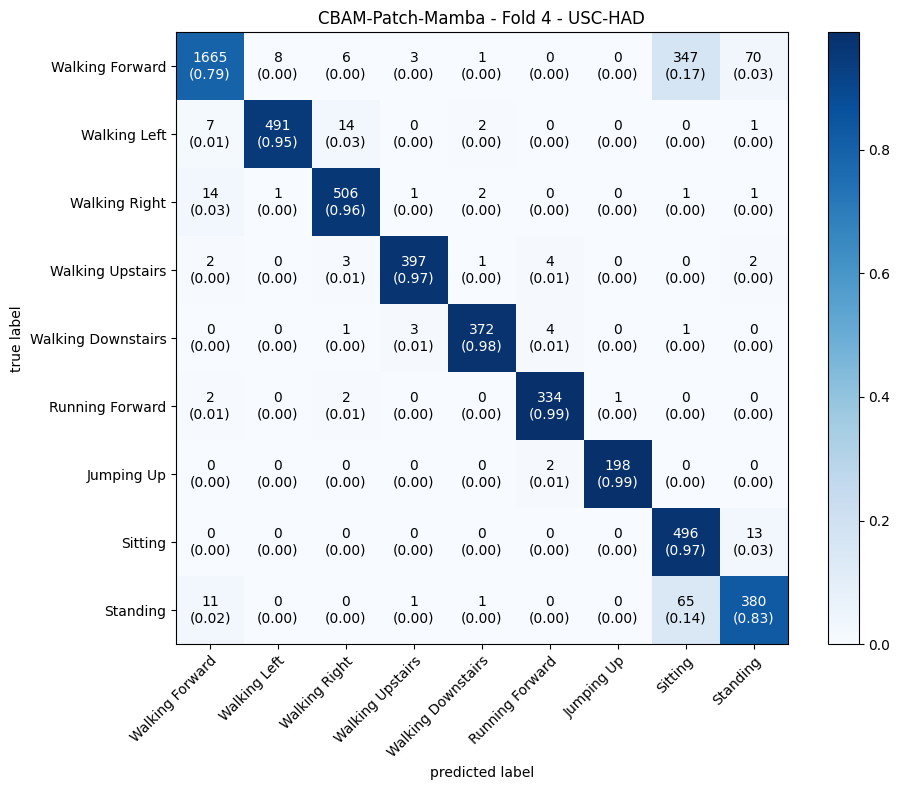


Fold 5/5
Model parameters: 142,412
START
Epoch 1/100 - Train Loss: 1.7959, Train Acc: 0.5292, Val Loss: 1.8758, Val Acc: 0.2940, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3004, Train Acc: 0.6614, Val Loss: 1.6682, Val Acc: 0.4649, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0866, Train Acc: 0.7202, Val Loss: 0.9935, Val Acc: 0.7503, LR: 0.000946
Epoch 4/100 - Train Loss: 0.9687, Train Acc: 0.8000, Val Loss: 0.9122, Val Acc: 0.8045, LR: 0.000905
Epoch 5/100 - Train Loss: 0.8805, Train Acc: 0.8492, Val Loss: 1.2141, Val Acc: 0.6565, LR: 0.000854
Epoch 6/100 - Train Loss: 0.8267, Train Acc: 0.8755, Val Loss: 0.9973, Val Acc: 0.7670, LR: 0.000794
Epoch 7/100 - Train Loss: 0.7830, Train Acc: 0.9068, Val Loss: 0.7931, Val Acc: 0.8911, LR: 0.000727
Epoch 8/100 - Train Loss: 0.7549, Train Acc: 0.9214, Val Loss: 0.8766, Val Acc: 0.8172, LR: 0.000655
Epoch 9/100 - Train Loss: 0.7341, Train Acc: 0.9289, Val Loss: 0.7366, Val Acc: 0.8915, LR: 0.000579
Epoch 10/100 - Train Loss: 0.7203, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

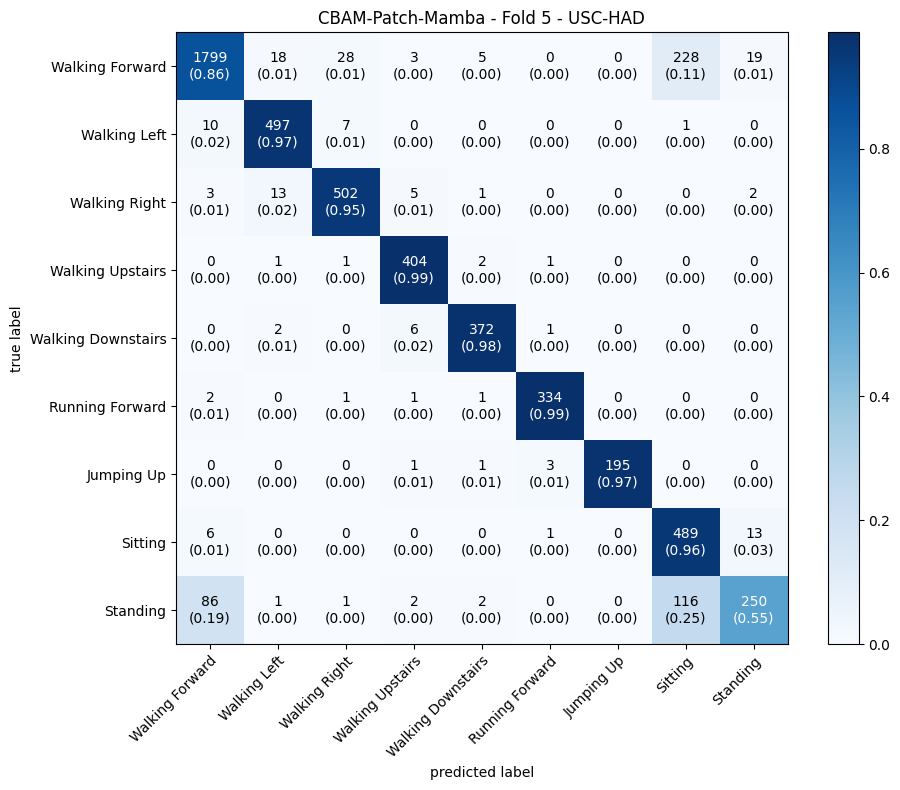


Generating t-SNE for CBAM-Patch-Mamba using full training data...
t-SNE input shape: (19685, 120)
Running t-SNE for CBAM-Patch-Mamba...


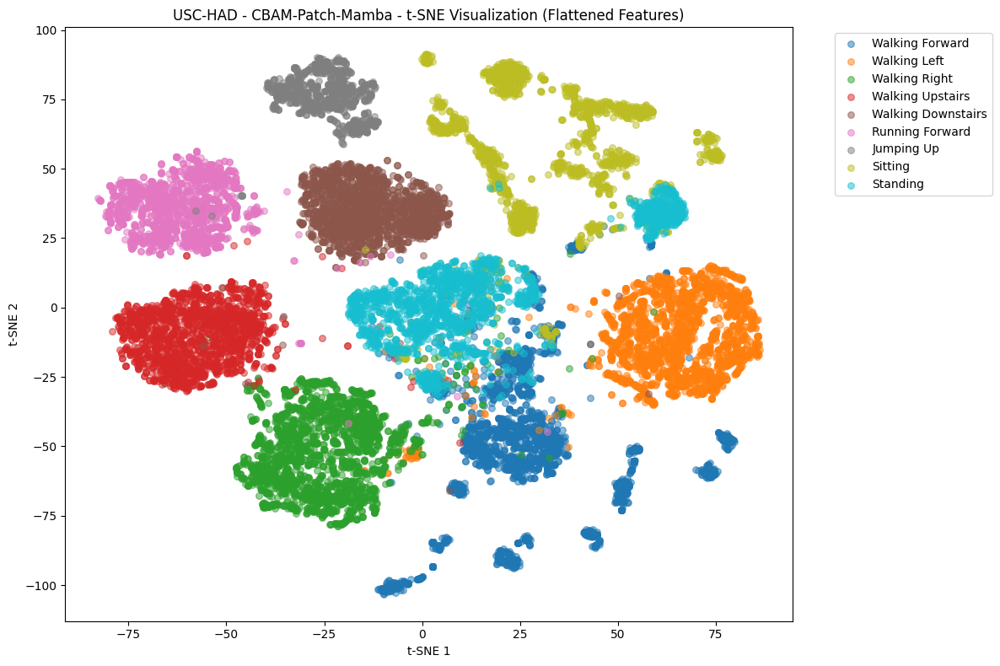


CBAM-Patch-Mamba Average Results:
Accuracy: 0.9013, F1: 0.9044
Precision: 0.9219, Recall: 0.9013
Sensitivity: 0.9312, Specificity: 0.9872
Parameters: 142,412

--- CBAM-Patch-Mamba-ContextAware ---

Fold 1/5
Model parameters: 163,661
START
Epoch 1/100 - Train Loss: 1.4131, Train Acc: 0.5882, Val Loss: 1.5595, Val Acc: 0.4631, LR: 0.000994
Epoch 2/100 - Train Loss: 0.9756, Train Acc: 0.8115, Val Loss: 1.9102, Val Acc: 0.5100, LR: 0.000976
Epoch 3/100 - Train Loss: 0.8224, Train Acc: 0.8829, Val Loss: 1.7854, Val Acc: 0.6417, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7373, Train Acc: 0.9120, Val Loss: 1.0487, Val Acc: 0.8415, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6844, Train Acc: 0.9278, Val Loss: 0.9879, Val Acc: 0.7762, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6607, Train Acc: 0.9365, Val Loss: 0.7942, Val Acc: 0.8941, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6405, Train Acc: 0.9451, Val Loss: 0.6973, Val Acc: 0.9169, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6269, Train Acc: 0.9496, 

<Figure size 1000x800 with 0 Axes>

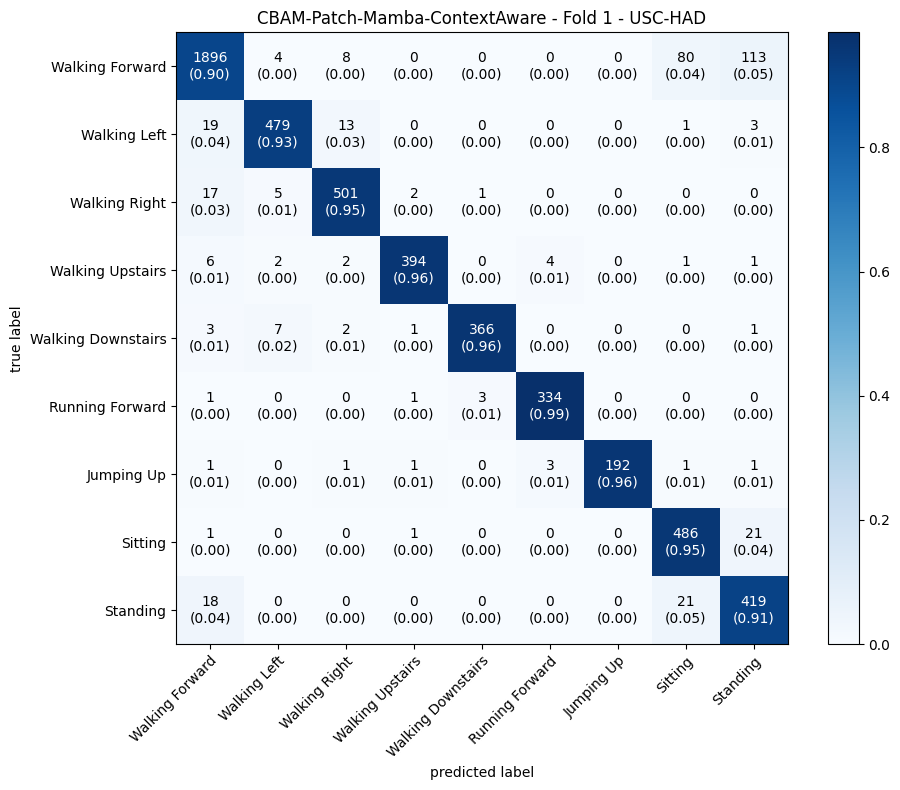


Fold 2/5
Model parameters: 163,661
START
Epoch 1/100 - Train Loss: 1.4288, Train Acc: 0.5845, Val Loss: 2.6502, Val Acc: 0.2957, LR: 0.000994
Epoch 2/100 - Train Loss: 0.9924, Train Acc: 0.8017, Val Loss: 1.3965, Val Acc: 0.5761, LR: 0.000976
Epoch 3/100 - Train Loss: 0.8136, Train Acc: 0.8894, Val Loss: 1.5449, Val Acc: 0.6456, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7319, Train Acc: 0.9178, Val Loss: 0.7973, Val Acc: 0.8551, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6840, Train Acc: 0.9317, Val Loss: 0.8070, Val Acc: 0.8887, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6592, Train Acc: 0.9396, Val Loss: 0.7434, Val Acc: 0.9001, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6440, Train Acc: 0.9440, Val Loss: 0.6953, Val Acc: 0.9281, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6245, Train Acc: 0.9518, Val Loss: 0.7511, Val Acc: 0.8970, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6142, Train Acc: 0.9544, Val Loss: 0.7010, Val Acc: 0.9283, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6062, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

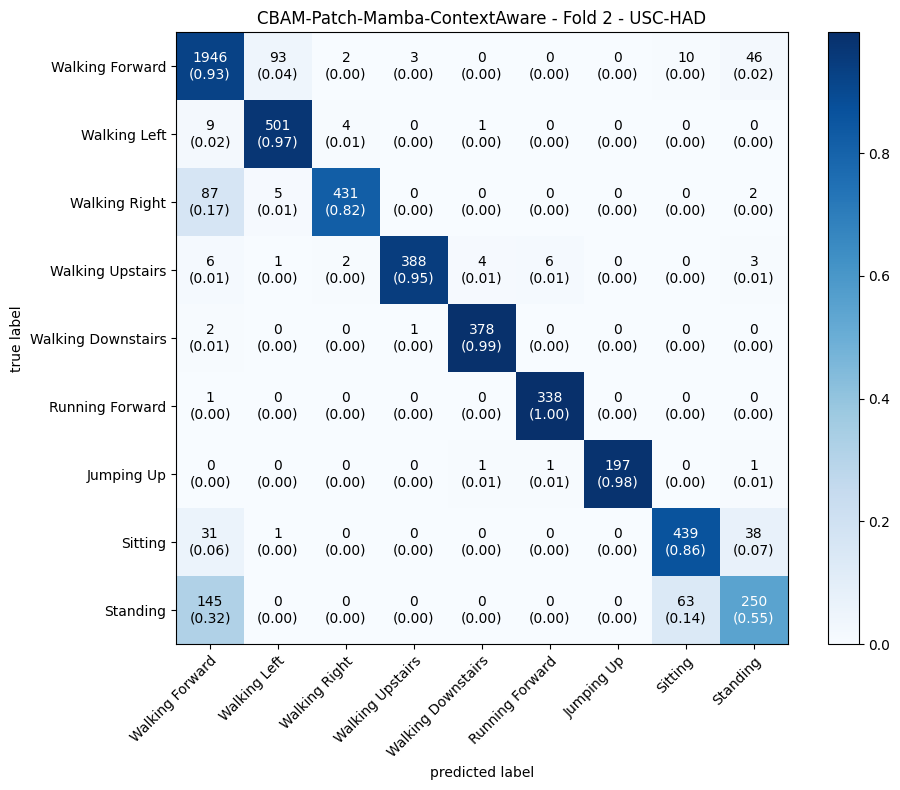


Fold 3/5
Model parameters: 163,661
START
Epoch 1/100 - Train Loss: 1.4252, Train Acc: 0.5798, Val Loss: 1.9386, Val Acc: 0.2731, LR: 0.000994
Epoch 2/100 - Train Loss: 0.9938, Train Acc: 0.7995, Val Loss: 1.4357, Val Acc: 0.5686, LR: 0.000976
Epoch 3/100 - Train Loss: 0.8405, Train Acc: 0.8737, Val Loss: 0.9689, Val Acc: 0.8108, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7309, Train Acc: 0.9156, Val Loss: 0.9936, Val Acc: 0.7790, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6941, Train Acc: 0.9269, Val Loss: 0.7968, Val Acc: 0.8790, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6693, Train Acc: 0.9365, Val Loss: 1.0189, Val Acc: 0.7718, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6547, Train Acc: 0.9395, Val Loss: 0.8293, Val Acc: 0.8463, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6421, Train Acc: 0.9458, Val Loss: 0.7552, Val Acc: 0.8963, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6249, Train Acc: 0.9519, Val Loss: 0.7408, Val Acc: 0.9003, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6178, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

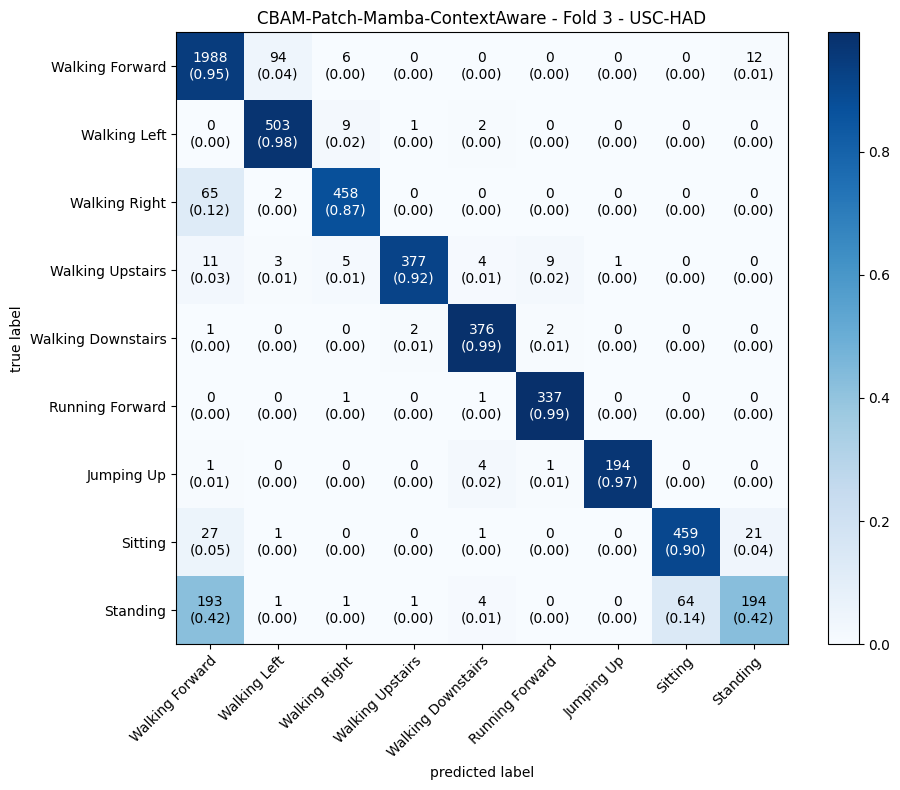


Fold 4/5
Model parameters: 163,661
START
Epoch 1/100 - Train Loss: 1.4113, Train Acc: 0.5908, Val Loss: 2.8274, Val Acc: 0.3152, LR: 0.000994
Epoch 2/100 - Train Loss: 0.9481, Train Acc: 0.8247, Val Loss: 1.0448, Val Acc: 0.7617, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7829, Train Acc: 0.9009, Val Loss: 0.8039, Val Acc: 0.8932, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7071, Train Acc: 0.9239, Val Loss: 1.7913, Val Acc: 0.5855, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6692, Train Acc: 0.9361, Val Loss: 0.7113, Val Acc: 0.9121, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6485, Train Acc: 0.9415, Val Loss: 0.6952, Val Acc: 0.9117, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6330, Train Acc: 0.9475, Val Loss: 0.6802, Val Acc: 0.9250, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6250, Train Acc: 0.9502, Val Loss: 0.6746, Val Acc: 0.9294, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6120, Train Acc: 0.9560, Val Loss: 0.7042, Val Acc: 0.9025, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6018, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

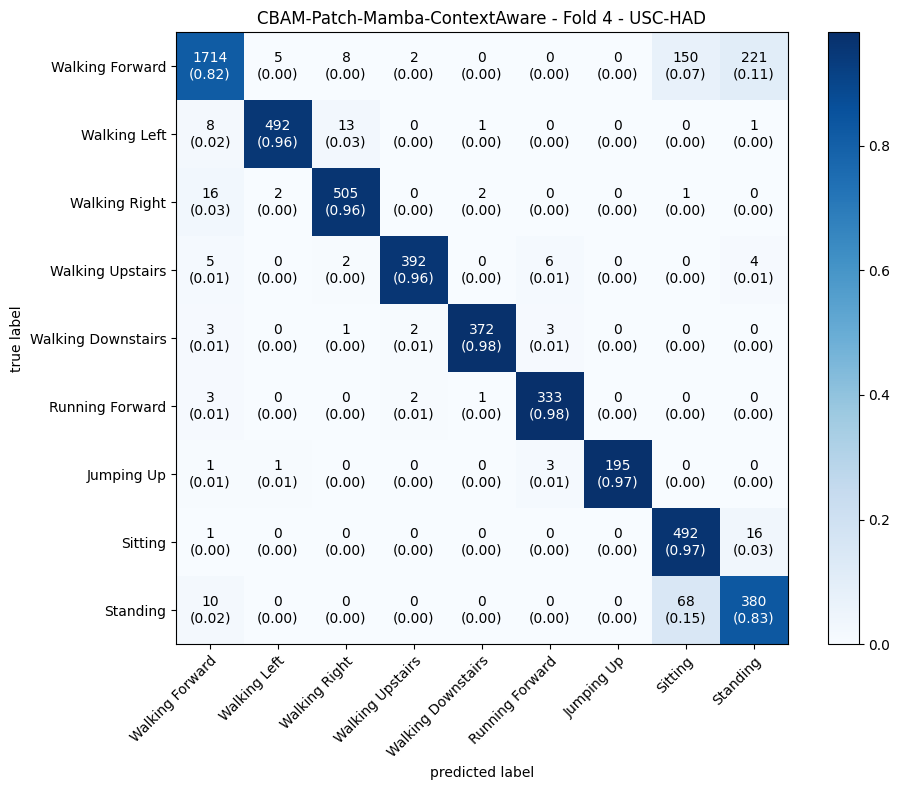


Fold 5/5
Model parameters: 163,661
START
Epoch 1/100 - Train Loss: 1.4158, Train Acc: 0.5807, Val Loss: 2.1793, Val Acc: 0.2738, LR: 0.000994
Epoch 2/100 - Train Loss: 0.9589, Train Acc: 0.8267, Val Loss: 1.0863, Val Acc: 0.7335, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7824, Train Acc: 0.9017, Val Loss: 1.2894, Val Acc: 0.6236, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7075, Train Acc: 0.9251, Val Loss: 0.8264, Val Acc: 0.8597, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6718, Train Acc: 0.9357, Val Loss: 0.7570, Val Acc: 0.8950, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6512, Train Acc: 0.9441, Val Loss: 0.9240, Val Acc: 0.8553, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6366, Train Acc: 0.9451, Val Loss: 0.9450, Val Acc: 0.8499, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6284, Train Acc: 0.9492, Val Loss: 0.6755, Val Acc: 0.9226, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6164, Train Acc: 0.9546, Val Loss: 0.7543, Val Acc: 0.8805, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6072, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

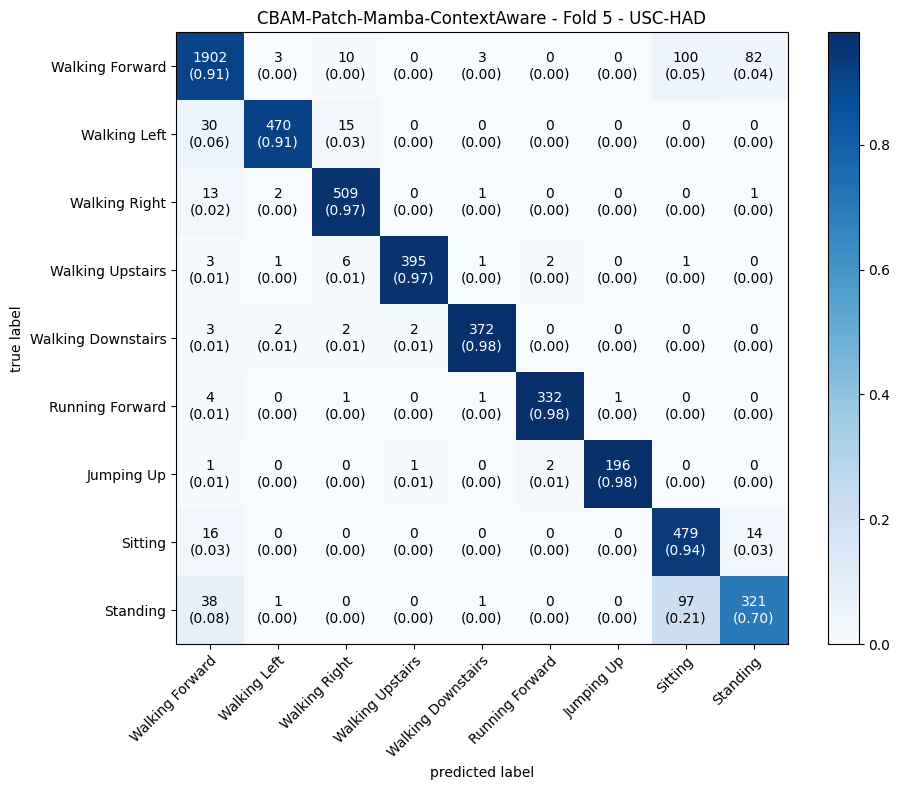


Generating t-SNE for CBAM-Patch-Mamba-ContextAware using full training data...
t-SNE input shape: (19685, 120)
Running t-SNE for CBAM-Patch-Mamba-ContextAware...


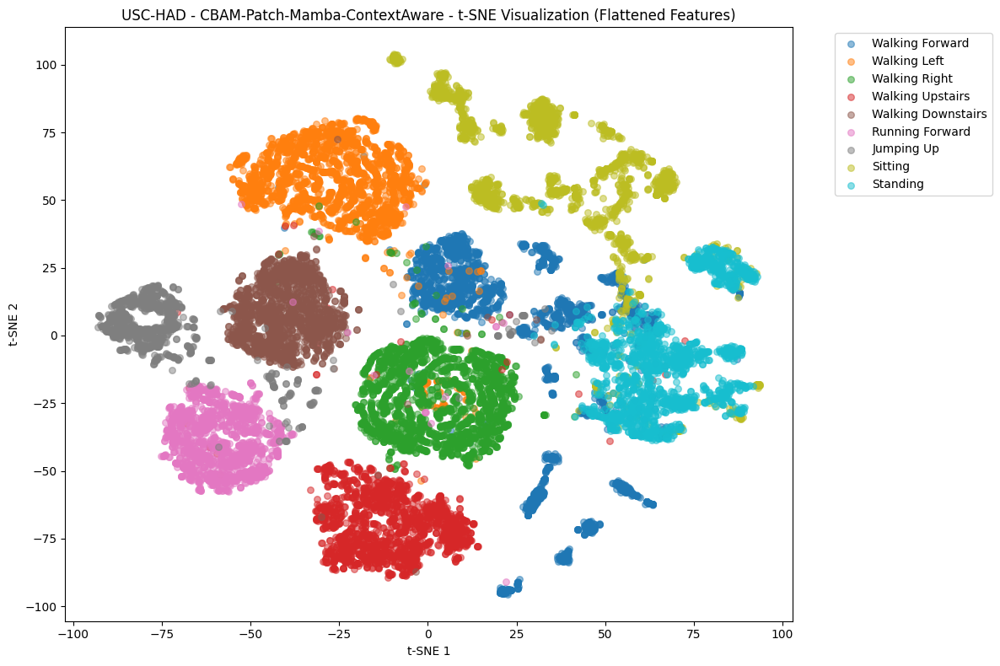


CBAM-Patch-Mamba-ContextAware Average Results:
Accuracy: 0.9075, F1: 0.9070
Precision: 0.9145, Recall: 0.9075
Sensitivity: 0.9181, Specificity: 0.9870
Parameters: 163,661
USC-HAD ablation study completed!

Processing WISDM Dataset

=== Ablation Study for WISDM ===
Using device: cuda
Dataset: WISDM, Patch size: 4

--- Mamba Only ---

Fold 1/5
Model parameters: 107,402
START
Epoch 1/100 - Train Loss: 1.0241, Train Acc: 0.7354, Val Loss: 0.7970, Val Acc: 0.7985, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7810, Train Acc: 0.8187, Val Loss: 0.7031, Val Acc: 0.8725, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7088, Train Acc: 0.8703, Val Loss: 0.6392, Val Acc: 0.8900, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6711, Train Acc: 0.8952, Val Loss: 0.6114, Val Acc: 0.9149, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6448, Train Acc: 0.9163, Val Loss: 0.5906, Val Acc: 0.9231, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6173, Train Acc: 0.9331, Val Loss: 0.5617, Val Acc: 0.9393, LR: 0.000794
Epoch 7/100 - Tra

<Figure size 1000x800 with 0 Axes>

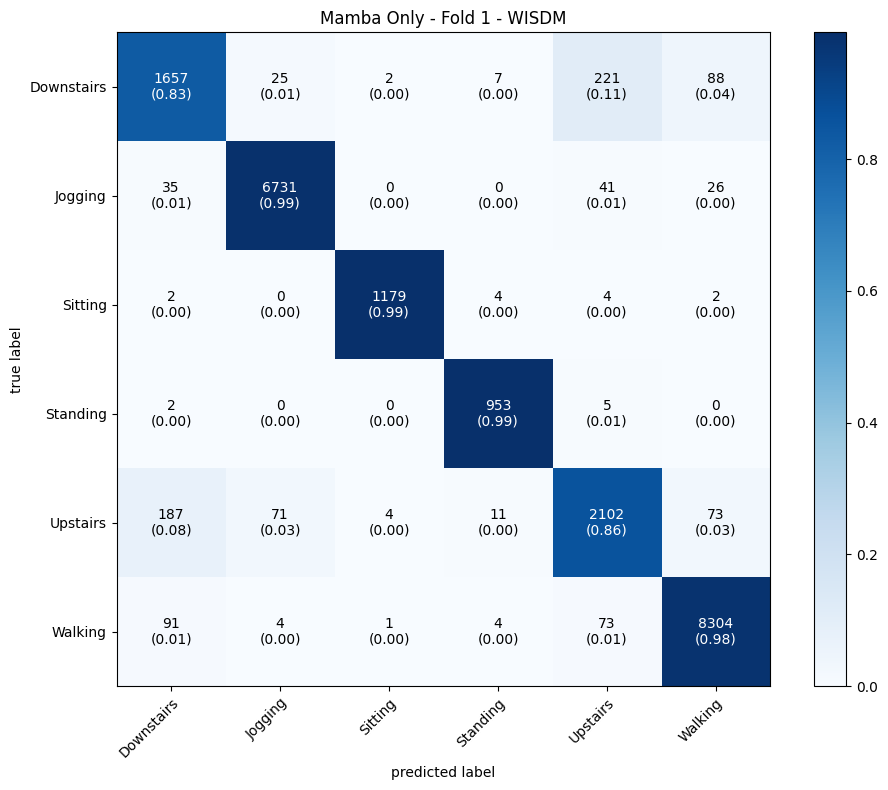


Fold 2/5
Model parameters: 107,402
START
Epoch 1/100 - Train Loss: 1.0273, Train Acc: 0.7430, Val Loss: 0.7480, Val Acc: 0.8416, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7400, Train Acc: 0.8512, Val Loss: 0.6653, Val Acc: 0.8738, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6869, Train Acc: 0.8806, Val Loss: 0.6340, Val Acc: 0.9027, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6543, Train Acc: 0.9040, Val Loss: 0.5957, Val Acc: 0.9242, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6244, Train Acc: 0.9252, Val Loss: 0.5713, Val Acc: 0.9346, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6042, Train Acc: 0.9380, Val Loss: 0.5642, Val Acc: 0.9373, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5902, Train Acc: 0.9444, Val Loss: 0.5529, Val Acc: 0.9413, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5744, Train Acc: 0.9513, Val Loss: 0.5538, Val Acc: 0.9428, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5607, Train Acc: 0.9589, Val Loss: 0.5442, Val Acc: 0.9470, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5521, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

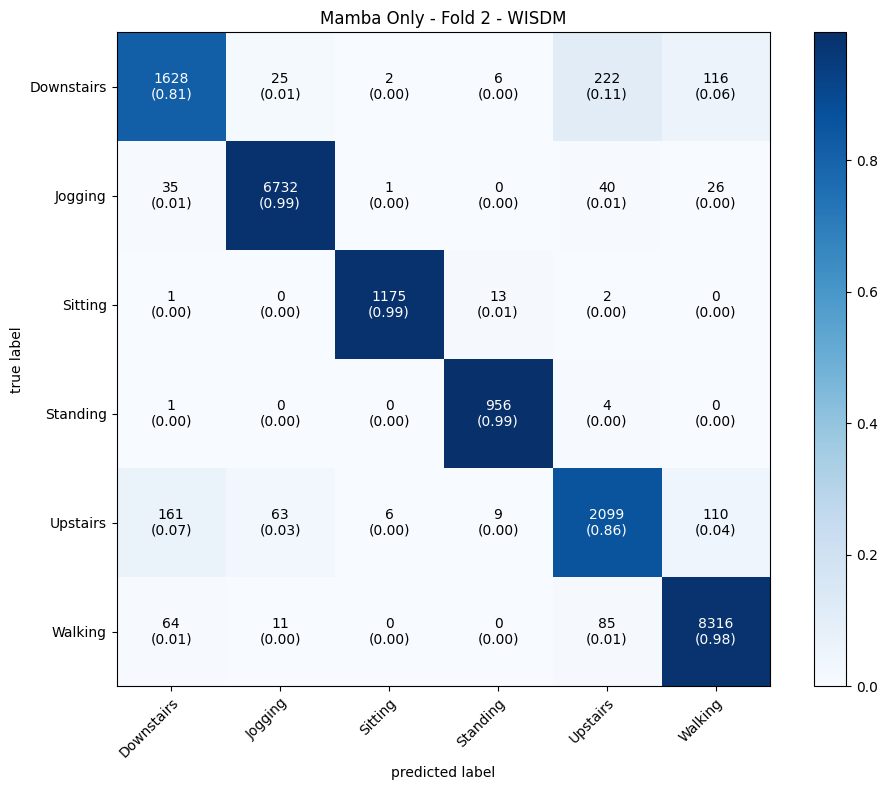


Fold 3/5
Model parameters: 107,402
START
Epoch 1/100 - Train Loss: 1.0347, Train Acc: 0.7280, Val Loss: 0.7894, Val Acc: 0.8390, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7665, Train Acc: 0.8300, Val Loss: 0.6895, Val Acc: 0.8668, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7146, Train Acc: 0.8527, Val Loss: 0.6485, Val Acc: 0.8990, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6810, Train Acc: 0.8892, Val Loss: 0.6285, Val Acc: 0.9076, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6412, Train Acc: 0.9197, Val Loss: 0.5757, Val Acc: 0.9347, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6161, Train Acc: 0.9332, Val Loss: 0.5692, Val Acc: 0.9356, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5990, Train Acc: 0.9413, Val Loss: 0.5555, Val Acc: 0.9428, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5822, Train Acc: 0.9500, Val Loss: 0.5464, Val Acc: 0.9476, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5696, Train Acc: 0.9560, Val Loss: 0.5469, Val Acc: 0.9451, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5533, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

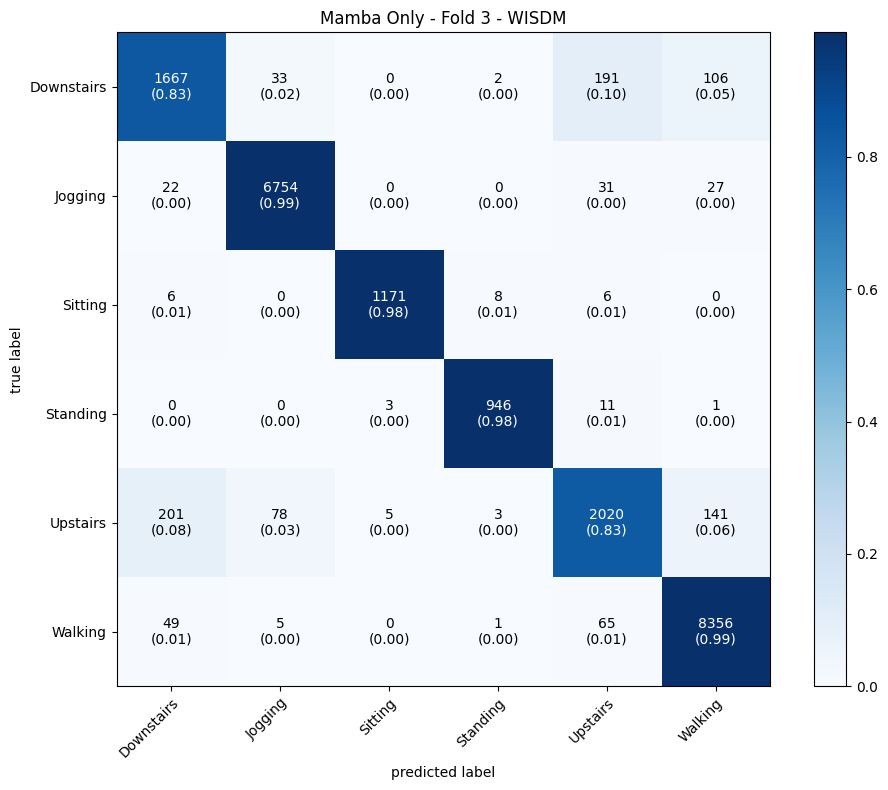


Fold 4/5
Model parameters: 107,402
START
Epoch 1/100 - Train Loss: 1.0172, Train Acc: 0.7314, Val Loss: 0.7640, Val Acc: 0.8103, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7776, Train Acc: 0.8311, Val Loss: 0.6961, Val Acc: 0.8847, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7227, Train Acc: 0.8688, Val Loss: 0.6702, Val Acc: 0.8842, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6722, Train Acc: 0.8953, Val Loss: 0.6187, Val Acc: 0.9122, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6378, Train Acc: 0.9215, Val Loss: 0.5778, Val Acc: 0.9335, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6095, Train Acc: 0.9371, Val Loss: 0.5612, Val Acc: 0.9396, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5921, Train Acc: 0.9452, Val Loss: 0.5541, Val Acc: 0.9428, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5755, Train Acc: 0.9525, Val Loss: 0.5472, Val Acc: 0.9453, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5650, Train Acc: 0.9575, Val Loss: 0.5460, Val Acc: 0.9444, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5524, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

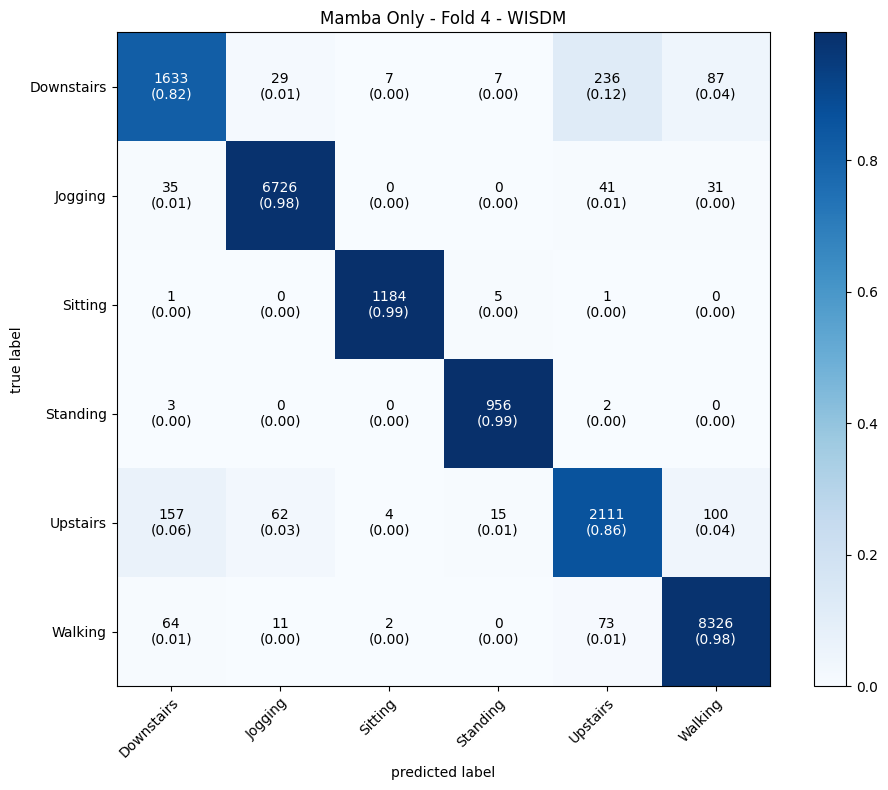


Fold 5/5
Model parameters: 107,402
START
Epoch 1/100 - Train Loss: 1.0200, Train Acc: 0.7364, Val Loss: 0.8148, Val Acc: 0.8135, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7699, Train Acc: 0.8339, Val Loss: 0.6685, Val Acc: 0.8794, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6949, Train Acc: 0.8797, Val Loss: 0.6277, Val Acc: 0.9060, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6564, Train Acc: 0.9096, Val Loss: 0.5870, Val Acc: 0.9267, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6283, Train Acc: 0.9255, Val Loss: 0.5863, Val Acc: 0.9294, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6051, Train Acc: 0.9373, Val Loss: 0.5584, Val Acc: 0.9419, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5880, Train Acc: 0.9455, Val Loss: 0.5502, Val Acc: 0.9433, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5739, Train Acc: 0.9537, Val Loss: 0.5407, Val Acc: 0.9475, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5626, Train Acc: 0.9584, Val Loss: 0.5374, Val Acc: 0.9483, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5519, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

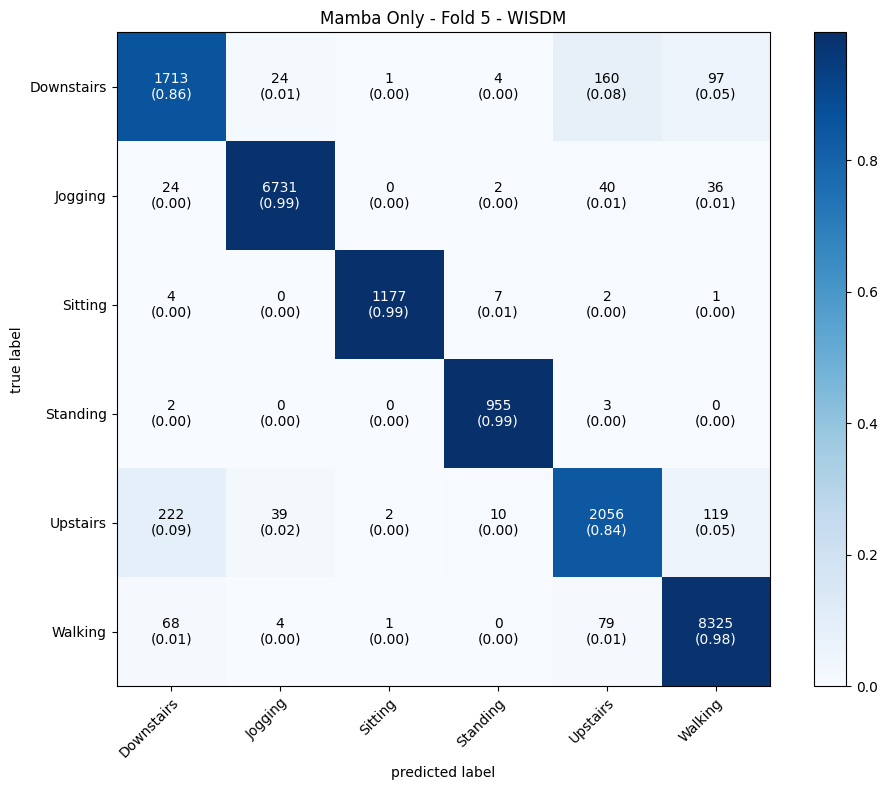


Generating t-SNE for Mamba Only using full training data...
t-SNE input shape: (18000, 12)
Running t-SNE for Mamba Only...


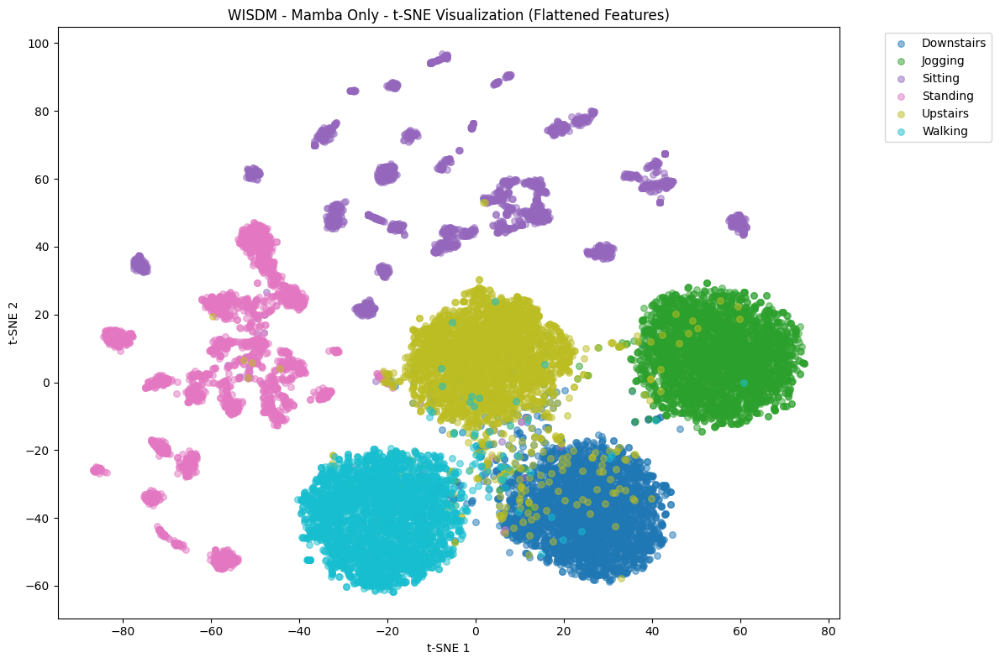


Mamba Only Average Results:
Accuracy: 0.9552, F1: 0.9549
Precision: 0.9548, Recall: 0.9552
Sensitivity: 0.9379, Specificity: 0.9905
Parameters: 107,402

--- CBAM-Patch-Mamba ---

Fold 1/5
Model parameters: 107,417
START
Epoch 1/100 - Train Loss: 1.0217, Train Acc: 0.7307, Val Loss: 0.7461, Val Acc: 0.8538, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7421, Train Acc: 0.8439, Val Loss: 0.6569, Val Acc: 0.8778, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6950, Train Acc: 0.8739, Val Loss: 0.6305, Val Acc: 0.8973, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6689, Train Acc: 0.8908, Val Loss: 0.6588, Val Acc: 0.8851, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6351, Train Acc: 0.9164, Val Loss: 0.5845, Val Acc: 0.9303, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6092, Train Acc: 0.9331, Val Loss: 0.5645, Val Acc: 0.9366, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5897, Train Acc: 0.9433, Val Loss: 0.5586, Val Acc: 0.9396, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5757, Train Acc: 0.9495, Val Loss: 0.5580, V

<Figure size 1000x800 with 0 Axes>

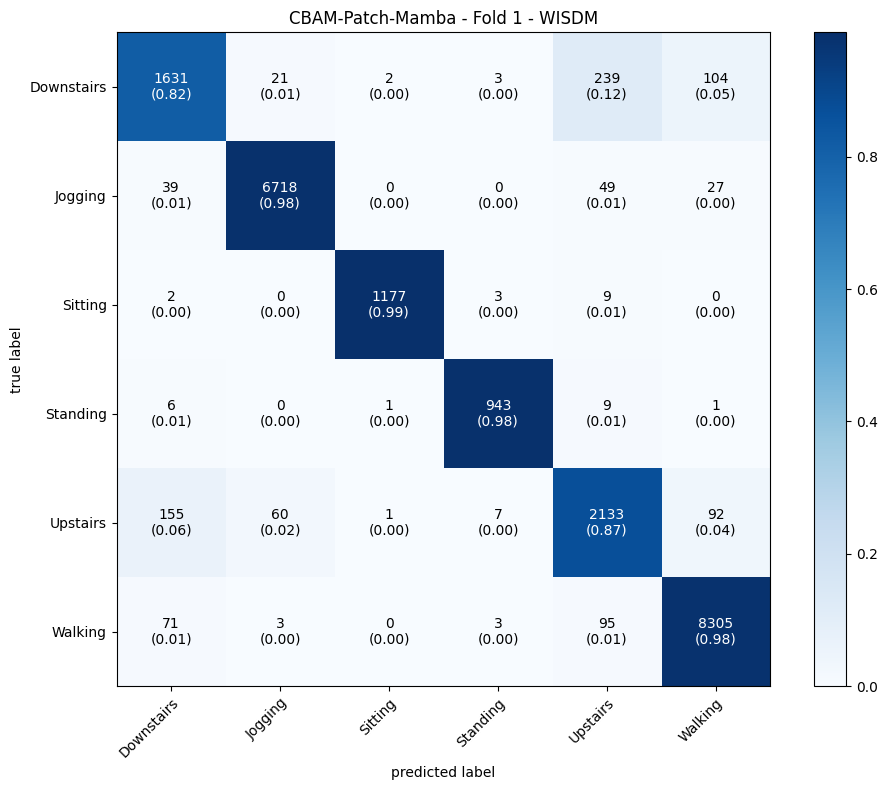


Fold 2/5
Model parameters: 107,417
START
Epoch 1/100 - Train Loss: 1.0304, Train Acc: 0.7276, Val Loss: 0.7735, Val Acc: 0.8351, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7547, Train Acc: 0.8427, Val Loss: 0.6654, Val Acc: 0.8800, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7009, Train Acc: 0.8663, Val Loss: 0.6400, Val Acc: 0.8932, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6683, Train Acc: 0.8931, Val Loss: 0.6250, Val Acc: 0.9068, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6422, Train Acc: 0.9132, Val Loss: 0.5962, Val Acc: 0.9206, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6157, Train Acc: 0.9280, Val Loss: 0.5834, Val Acc: 0.9283, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5986, Train Acc: 0.9375, Val Loss: 0.5621, Val Acc: 0.9369, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5798, Train Acc: 0.9464, Val Loss: 0.5623, Val Acc: 0.9371, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5671, Train Acc: 0.9527, Val Loss: 0.5495, Val Acc: 0.9420, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5545, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

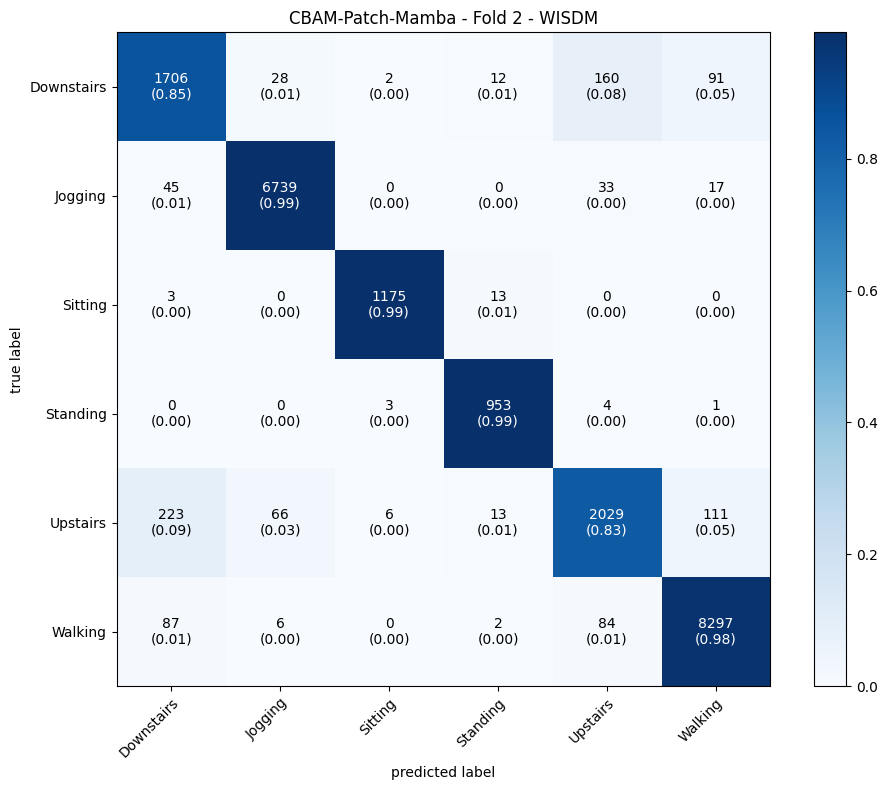


Fold 3/5
Model parameters: 107,417
START
Epoch 1/100 - Train Loss: 1.0835, Train Acc: 0.6801, Val Loss: 0.8748, Val Acc: 0.7466, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8376, Train Acc: 0.8046, Val Loss: 0.7596, Val Acc: 0.8446, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7754, Train Acc: 0.8458, Val Loss: 0.7194, Val Acc: 0.8692, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7308, Train Acc: 0.8708, Val Loss: 0.6845, Val Acc: 0.8800, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6915, Train Acc: 0.8886, Val Loss: 0.6427, Val Acc: 0.8958, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6644, Train Acc: 0.8985, Val Loss: 0.6345, Val Acc: 0.8974, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6451, Train Acc: 0.9059, Val Loss: 0.6146, Val Acc: 0.9038, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6268, Train Acc: 0.9129, Val Loss: 0.6065, Val Acc: 0.9060, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6118, Train Acc: 0.9190, Val Loss: 0.5997, Val Acc: 0.9082, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5879, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

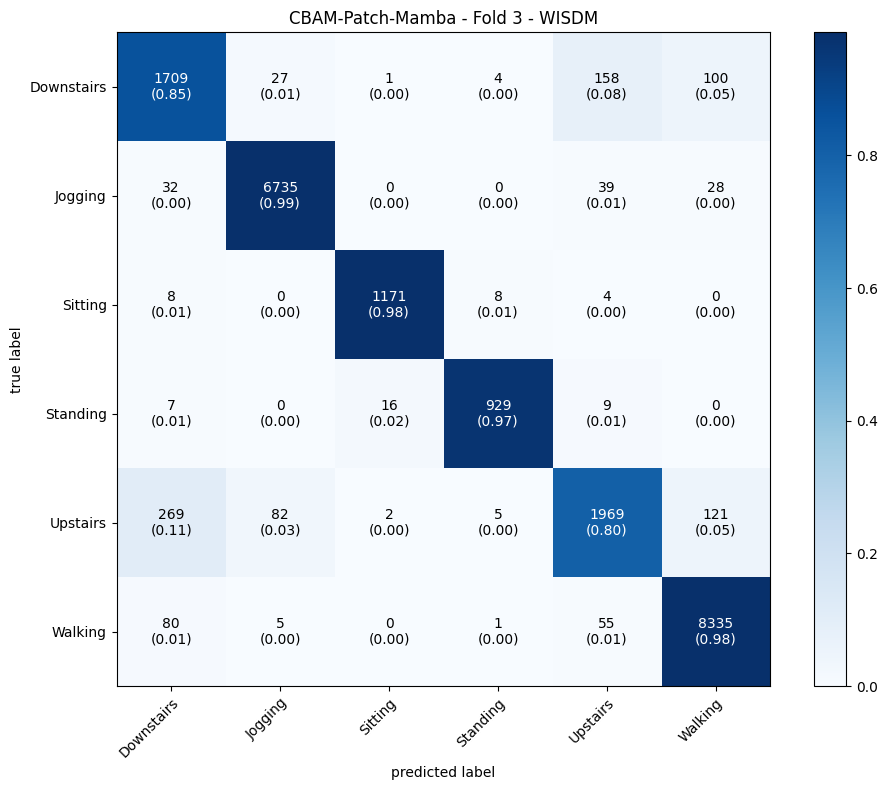


Fold 4/5
Model parameters: 107,417
START
Epoch 1/100 - Train Loss: 1.0257, Train Acc: 0.7464, Val Loss: 0.7699, Val Acc: 0.8424, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7469, Train Acc: 0.8513, Val Loss: 0.6726, Val Acc: 0.8712, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6917, Train Acc: 0.8804, Val Loss: 0.6246, Val Acc: 0.9099, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6512, Train Acc: 0.9095, Val Loss: 0.6124, Val Acc: 0.9147, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6226, Train Acc: 0.9256, Val Loss: 0.5839, Val Acc: 0.9280, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6004, Train Acc: 0.9387, Val Loss: 0.5971, Val Acc: 0.9237, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5847, Train Acc: 0.9468, Val Loss: 0.5560, Val Acc: 0.9404, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5724, Train Acc: 0.9513, Val Loss: 0.5502, Val Acc: 0.9435, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5608, Train Acc: 0.9569, Val Loss: 0.5504, Val Acc: 0.9436, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5497, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

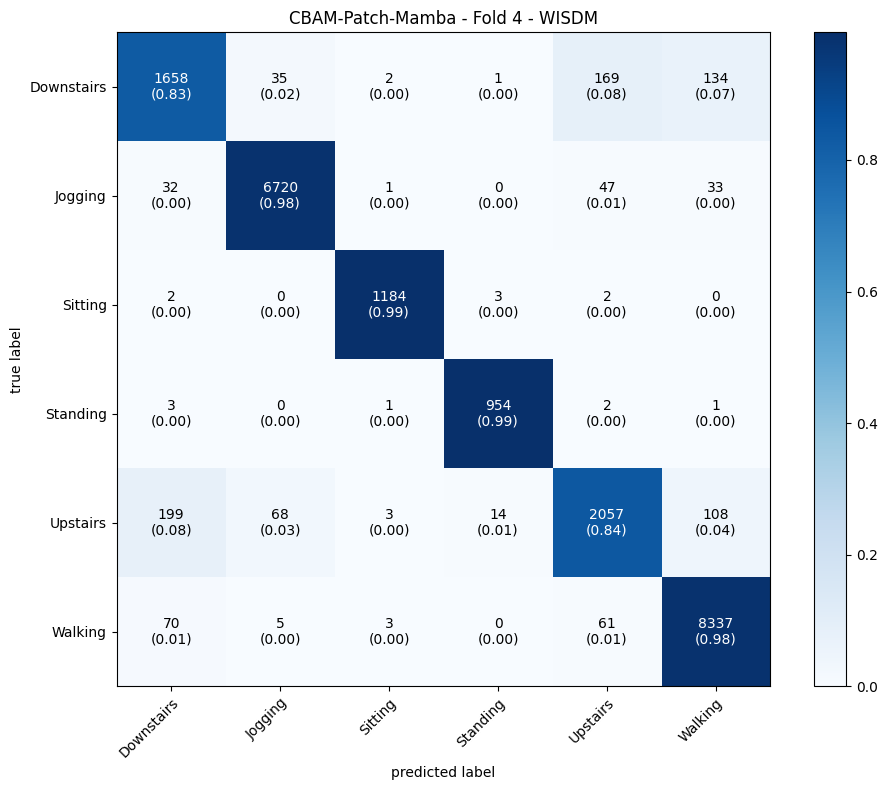


Fold 5/5
Model parameters: 107,417
START
Epoch 1/100 - Train Loss: 1.0398, Train Acc: 0.7239, Val Loss: 0.7955, Val Acc: 0.8082, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7890, Train Acc: 0.8223, Val Loss: 0.7084, Val Acc: 0.8791, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7335, Train Acc: 0.8701, Val Loss: 0.6767, Val Acc: 0.8933, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6973, Train Acc: 0.8916, Val Loss: 0.6344, Val Acc: 0.9027, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6507, Train Acc: 0.9133, Val Loss: 0.6091, Val Acc: 0.9177, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6238, Train Acc: 0.9285, Val Loss: 0.5715, Val Acc: 0.9366, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6016, Train Acc: 0.9383, Val Loss: 0.5668, Val Acc: 0.9355, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5835, Train Acc: 0.9480, Val Loss: 0.5518, Val Acc: 0.9440, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5684, Train Acc: 0.9557, Val Loss: 0.5430, Val Acc: 0.9473, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5595, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

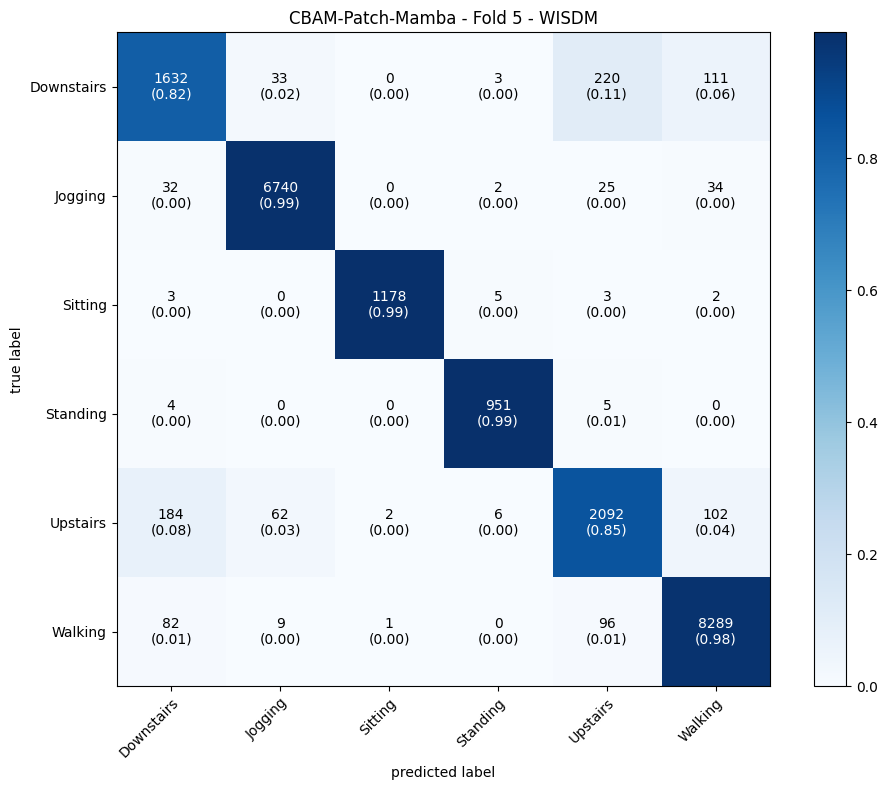


Generating t-SNE for CBAM-Patch-Mamba using full training data...
t-SNE input shape: (18000, 12)
Running t-SNE for CBAM-Patch-Mamba...


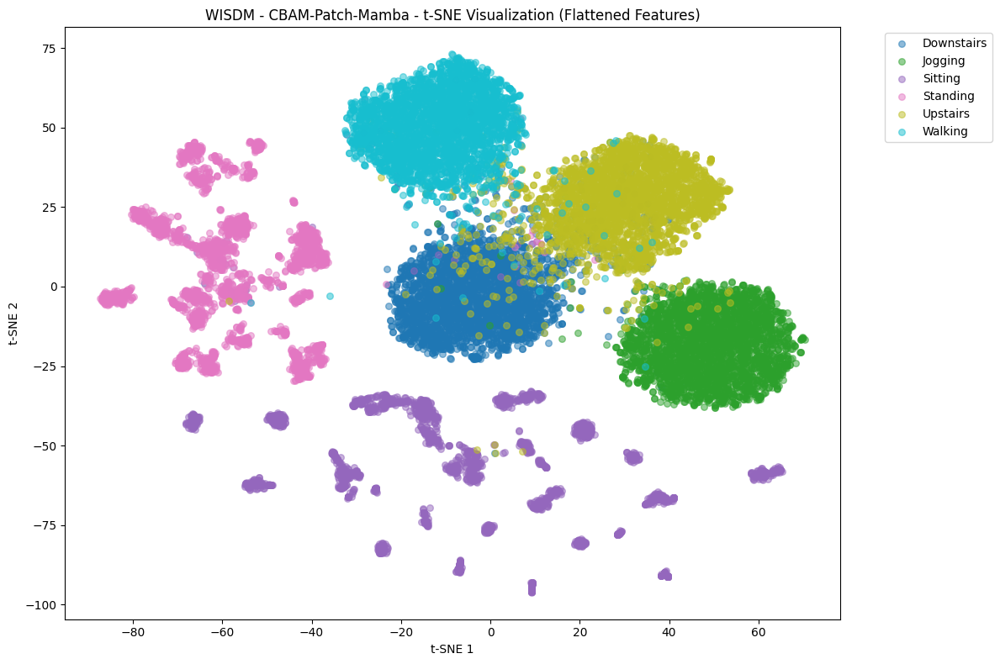


CBAM-Patch-Mamba Average Results:
Accuracy: 0.9535, F1: 0.9532
Precision: 0.9532, Recall: 0.9535
Sensitivity: 0.9354, Specificity: 0.9902
Parameters: 107,417

--- CBAM-Patch-Mamba-ContextAware ---

Fold 1/5
Model parameters: 104,609
START
Epoch 1/100 - Train Loss: 0.9980, Train Acc: 0.7592, Val Loss: 0.7260, Val Acc: 0.8597, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6826, Train Acc: 0.8784, Val Loss: 0.6562, Val Acc: 0.9017, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6213, Train Acc: 0.9139, Val Loss: 0.6150, Val Acc: 0.9162, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5885, Train Acc: 0.9305, Val Loss: 0.5939, Val Acc: 0.9282, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5666, Train Acc: 0.9418, Val Loss: 0.6069, Val Acc: 0.9259, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5518, Train Acc: 0.9494, Val Loss: 0.5754, Val Acc: 0.9356, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5385, Train Acc: 0.9562, Val Loss: 0.5712, Val Acc: 0.9396, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5268, Train Acc: 0.9614, 

<Figure size 1000x800 with 0 Axes>

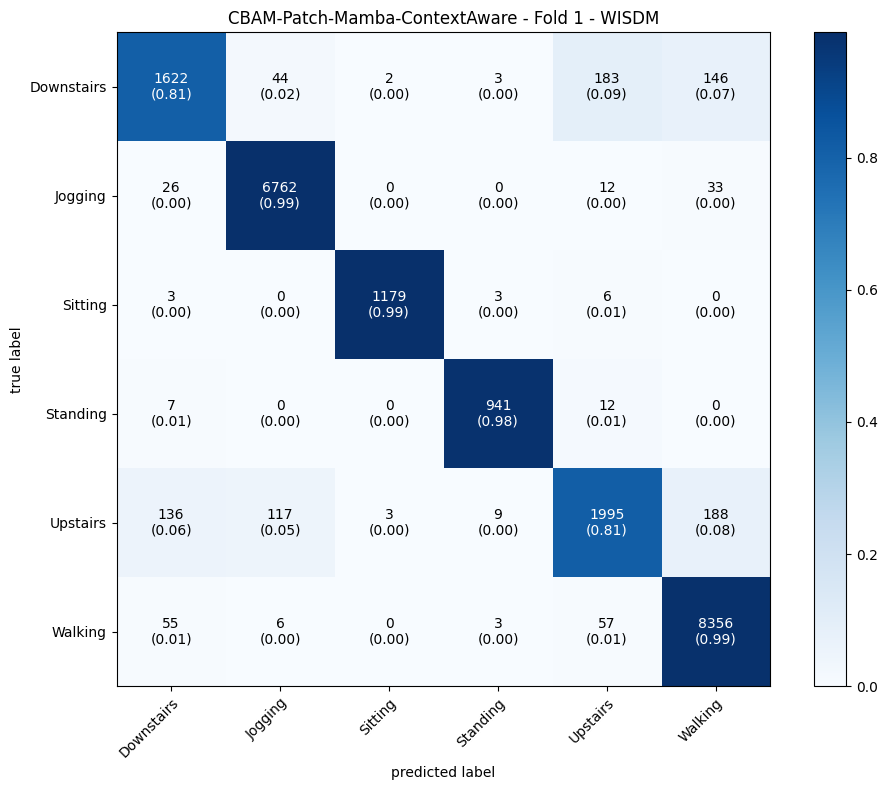


Fold 2/5
Model parameters: 104,609
START
Epoch 1/100 - Train Loss: 1.0458, Train Acc: 0.7334, Val Loss: 0.7681, Val Acc: 0.8415, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7059, Train Acc: 0.8701, Val Loss: 0.6657, Val Acc: 0.8970, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6313, Train Acc: 0.9098, Val Loss: 0.6306, Val Acc: 0.9104, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5971, Train Acc: 0.9272, Val Loss: 0.6060, Val Acc: 0.9253, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5739, Train Acc: 0.9387, Val Loss: 0.5870, Val Acc: 0.9334, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5584, Train Acc: 0.9455, Val Loss: 0.5847, Val Acc: 0.9323, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5443, Train Acc: 0.9531, Val Loss: 0.5836, Val Acc: 0.9341, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5346, Train Acc: 0.9579, Val Loss: 0.5724, Val Acc: 0.9382, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5246, Train Acc: 0.9631, Val Loss: 0.5623, Val Acc: 0.9430, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5175, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

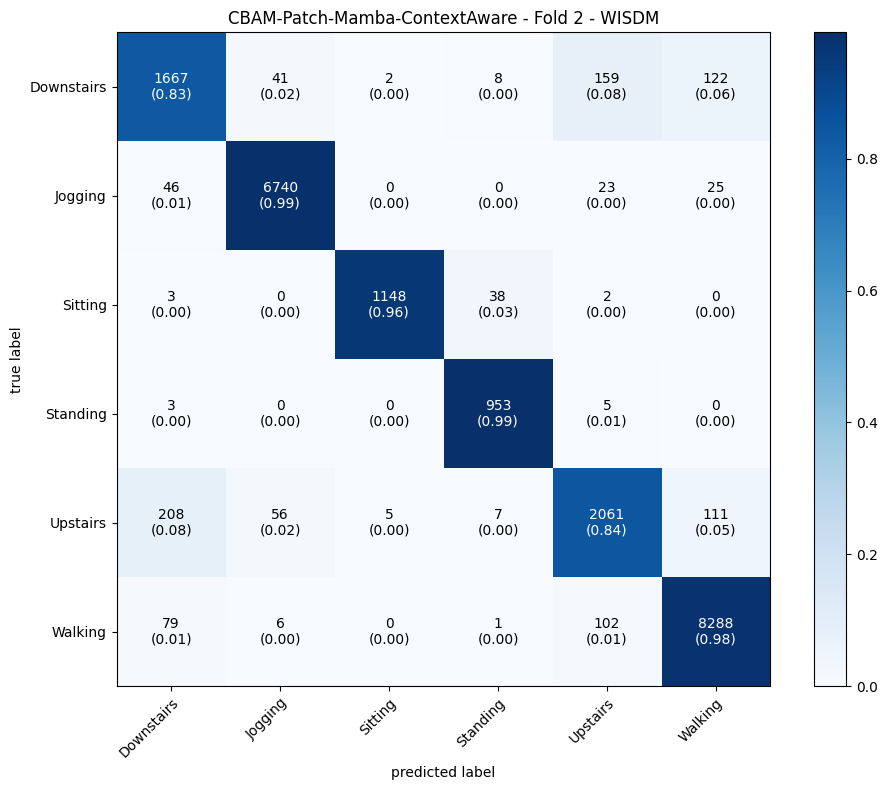


Fold 3/5
Model parameters: 104,609
START
Epoch 1/100 - Train Loss: 1.0235, Train Acc: 0.7598, Val Loss: 0.7967, Val Acc: 0.8152, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6843, Train Acc: 0.8813, Val Loss: 0.6423, Val Acc: 0.9026, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6173, Train Acc: 0.9167, Val Loss: 0.6285, Val Acc: 0.9159, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5867, Train Acc: 0.9313, Val Loss: 0.5900, Val Acc: 0.9258, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5662, Train Acc: 0.9420, Val Loss: 0.5768, Val Acc: 0.9348, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5495, Train Acc: 0.9495, Val Loss: 0.5776, Val Acc: 0.9377, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5369, Train Acc: 0.9560, Val Loss: 0.5620, Val Acc: 0.9434, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5269, Train Acc: 0.9616, Val Loss: 0.5580, Val Acc: 0.9408, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5182, Train Acc: 0.9656, Val Loss: 0.5508, Val Acc: 0.9466, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5108, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

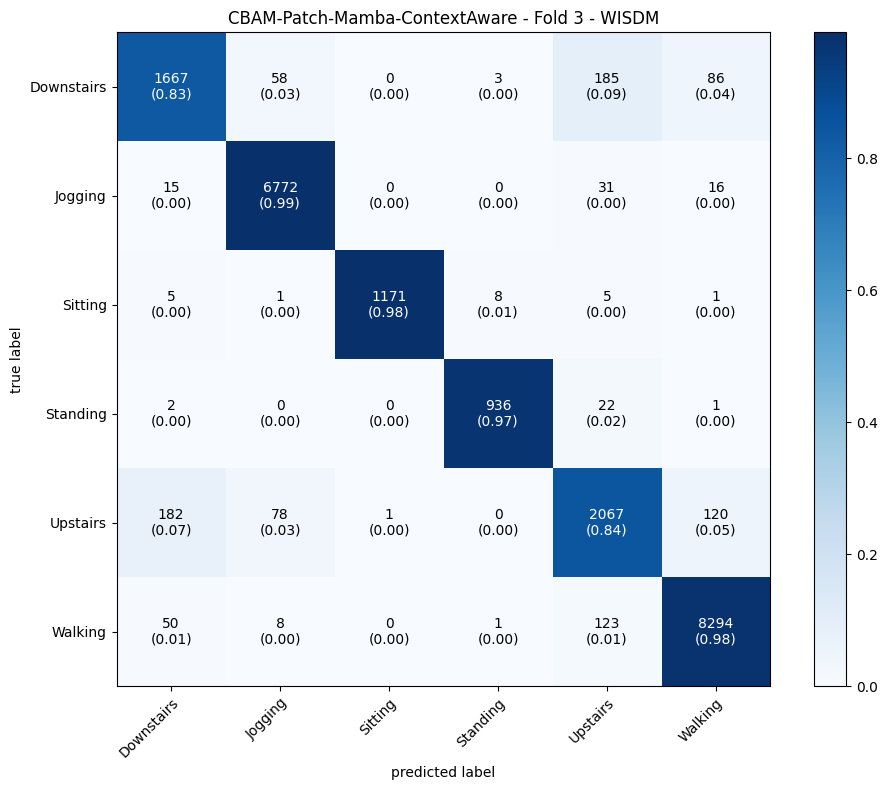


Fold 4/5
Model parameters: 104,609
START
Epoch 1/100 - Train Loss: 0.9907, Train Acc: 0.7645, Val Loss: 0.8077, Val Acc: 0.8225, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6742, Train Acc: 0.8859, Val Loss: 0.6578, Val Acc: 0.9042, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6157, Train Acc: 0.9175, Val Loss: 0.6071, Val Acc: 0.9254, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5839, Train Acc: 0.9334, Val Loss: 0.5945, Val Acc: 0.9266, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5656, Train Acc: 0.9424, Val Loss: 0.5754, Val Acc: 0.9359, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5507, Train Acc: 0.9496, Val Loss: 0.5763, Val Acc: 0.9339, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5372, Train Acc: 0.9568, Val Loss: 0.5768, Val Acc: 0.9330, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5274, Train Acc: 0.9615, Val Loss: 0.5685, Val Acc: 0.9419, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5187, Train Acc: 0.9666, Val Loss: 0.5600, Val Acc: 0.9434, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5114, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

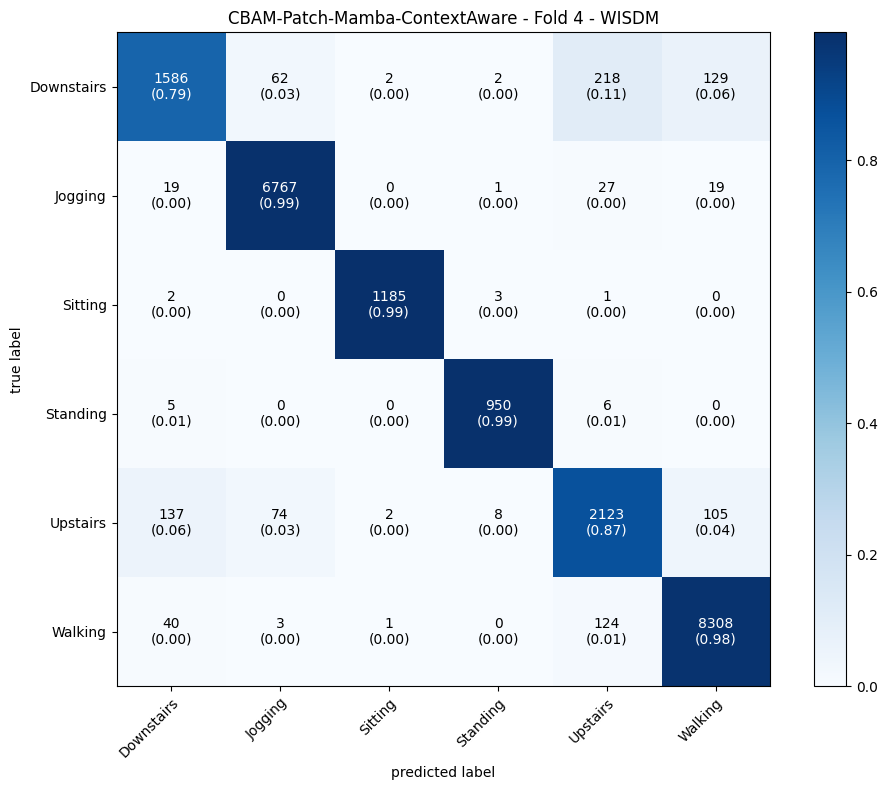


Fold 5/5
Model parameters: 104,609
START
Epoch 1/100 - Train Loss: 0.9968, Train Acc: 0.7492, Val Loss: 0.7358, Val Acc: 0.8465, LR: 0.000994
Epoch 2/100 - Train Loss: 0.6879, Train Acc: 0.8781, Val Loss: 0.6603, Val Acc: 0.8966, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6301, Train Acc: 0.9111, Val Loss: 0.6249, Val Acc: 0.9097, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5991, Train Acc: 0.9275, Val Loss: 0.6146, Val Acc: 0.9188, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5778, Train Acc: 0.9370, Val Loss: 0.5903, Val Acc: 0.9308, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5609, Train Acc: 0.9462, Val Loss: 0.5899, Val Acc: 0.9269, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5474, Train Acc: 0.9524, Val Loss: 0.5735, Val Acc: 0.9387, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5354, Train Acc: 0.9577, Val Loss: 0.5636, Val Acc: 0.9408, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5274, Train Acc: 0.9624, Val Loss: 0.5655, Val Acc: 0.9420, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5188, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

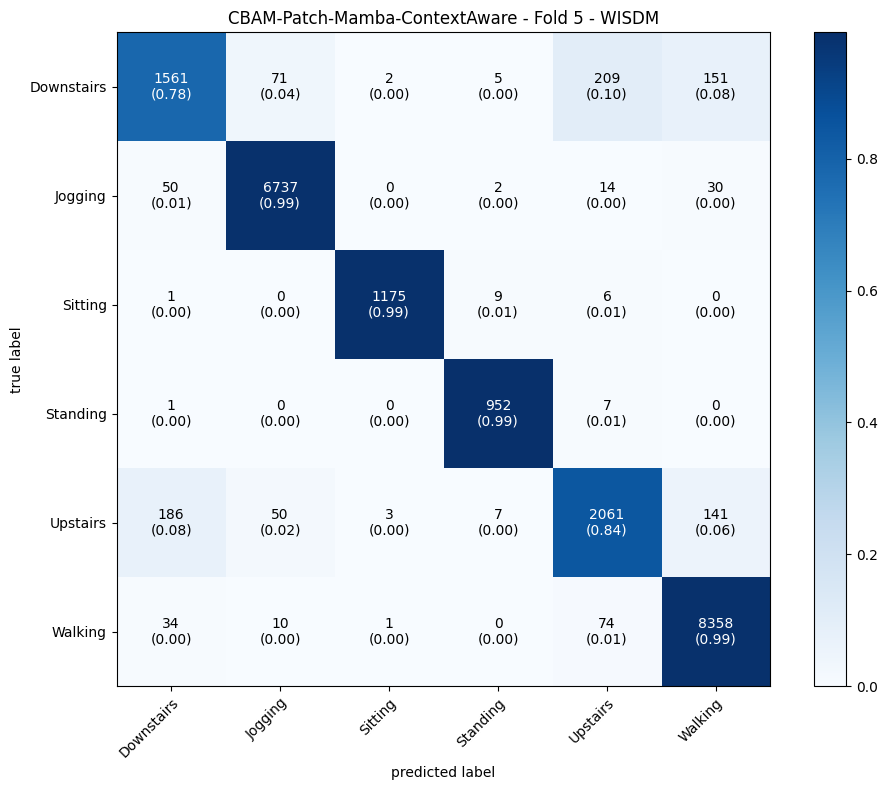


Generating t-SNE for CBAM-Patch-Mamba-ContextAware using full training data...
t-SNE input shape: (18000, 12)
Running t-SNE for CBAM-Patch-Mamba-ContextAware...


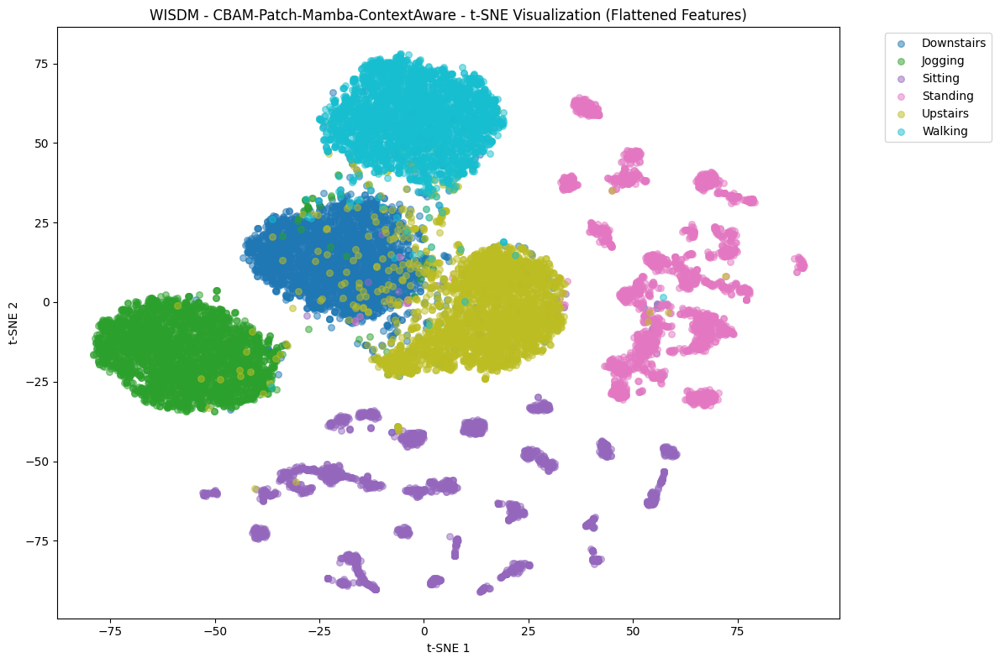


CBAM-Patch-Mamba-ContextAware Average Results:
Accuracy: 0.9529, F1: 0.9523
Precision: 0.9521, Recall: 0.9529
Sensitivity: 0.9320, Specificity: 0.9898
Parameters: 104,609
WISDM ablation study completed!

Processing PAMAP2 Dataset

=== Ablation Study for PAMAP2 ===
Using device: cuda
Dataset: PAMAP2, Patch size: 20

--- Mamba Only ---

Fold 1/5
Model parameters: 425,949
START
Epoch 1/100 - Train Loss: 1.2436, Train Acc: 0.7615, Val Loss: 1.9682, Val Acc: 0.5540, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8031, Train Acc: 0.9131, Val Loss: 1.0765, Val Acc: 0.7635, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7402, Train Acc: 0.9348, Val Loss: 0.8320, Val Acc: 0.8880, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6963, Train Acc: 0.9484, Val Loss: 0.8739, Val Acc: 0.8733, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6804, Train Acc: 0.9566, Val Loss: 1.0128, Val Acc: 0.8284, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6554, Train Acc: 0.9629, Val Loss: 1.1737, Val Acc: 0.7682, LR: 0.000794
Epoch 7/100 - T

<Figure size 1000x800 with 0 Axes>

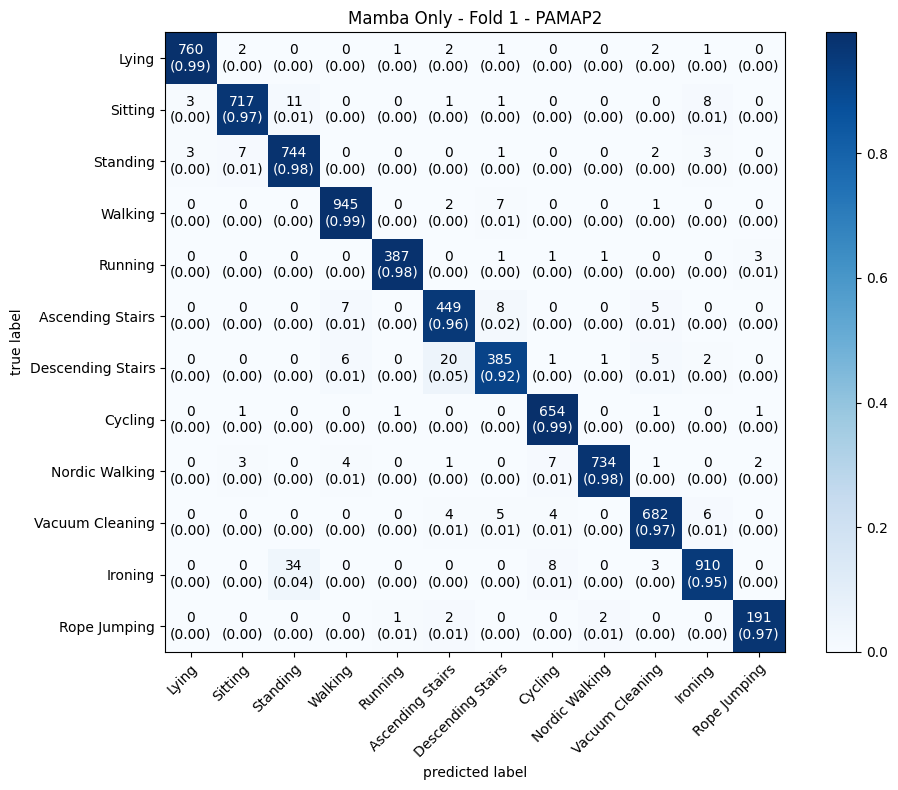


Fold 2/5
Model parameters: 425,949
START
Epoch 1/100 - Train Loss: 1.2532, Train Acc: 0.7539, Val Loss: 1.5690, Val Acc: 0.6056, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8023, Train Acc: 0.9134, Val Loss: 1.3909, Val Acc: 0.6659, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7303, Train Acc: 0.9371, Val Loss: 1.1345, Val Acc: 0.7924, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6899, Train Acc: 0.9499, Val Loss: 1.0062, Val Acc: 0.8226, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6683, Train Acc: 0.9584, Val Loss: 0.7719, Val Acc: 0.8996, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6459, Train Acc: 0.9648, Val Loss: 0.8830, Val Acc: 0.8594, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6430, Train Acc: 0.9704, Val Loss: 0.6475, Val Acc: 0.9502, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6227, Train Acc: 0.9757, Val Loss: 0.7218, Val Acc: 0.9301, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6077, Train Acc: 0.9791, Val Loss: 0.6602, Val Acc: 0.9458, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6090, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

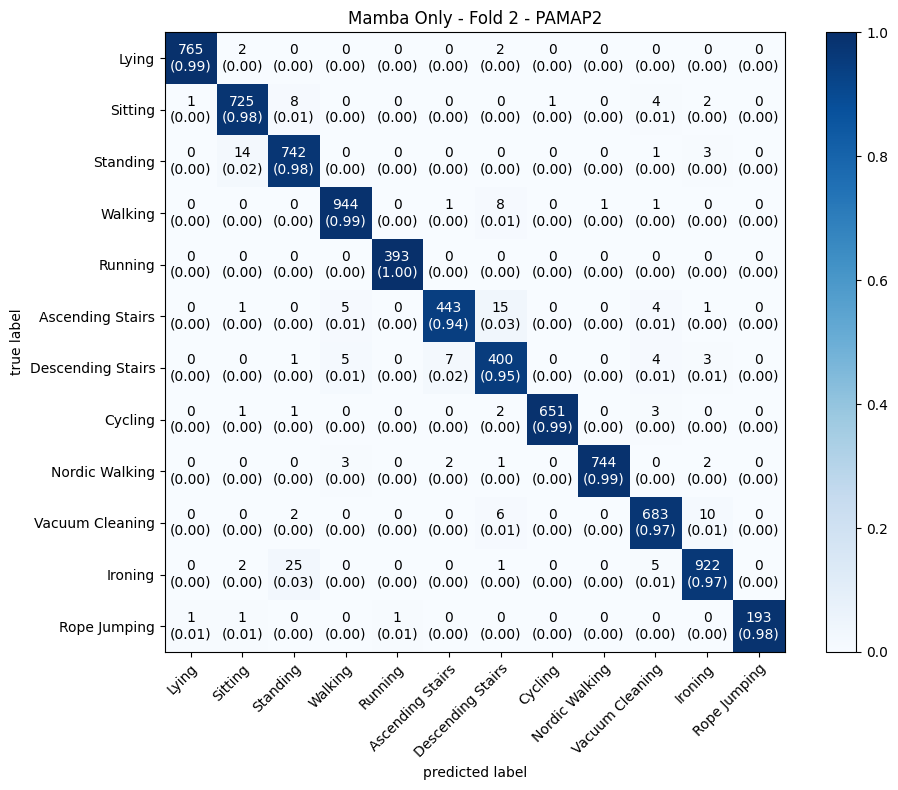


Fold 3/5
Model parameters: 425,949
START
Epoch 1/100 - Train Loss: 1.2544, Train Acc: 0.7610, Val Loss: 1.0723, Val Acc: 0.8016, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8119, Train Acc: 0.9114, Val Loss: 1.1658, Val Acc: 0.7487, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7456, Train Acc: 0.9353, Val Loss: 0.9074, Val Acc: 0.8427, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6986, Train Acc: 0.9470, Val Loss: 1.1550, Val Acc: 0.7893, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6730, Train Acc: 0.9564, Val Loss: 1.0335, Val Acc: 0.7895, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6557, Train Acc: 0.9634, Val Loss: 0.8253, Val Acc: 0.8863, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6387, Train Acc: 0.9691, Val Loss: 0.7311, Val Acc: 0.9181, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6318, Train Acc: 0.9740, Val Loss: 0.7230, Val Acc: 0.9300, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6127, Train Acc: 0.9779, Val Loss: 0.7305, Val Acc: 0.9239, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6033, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

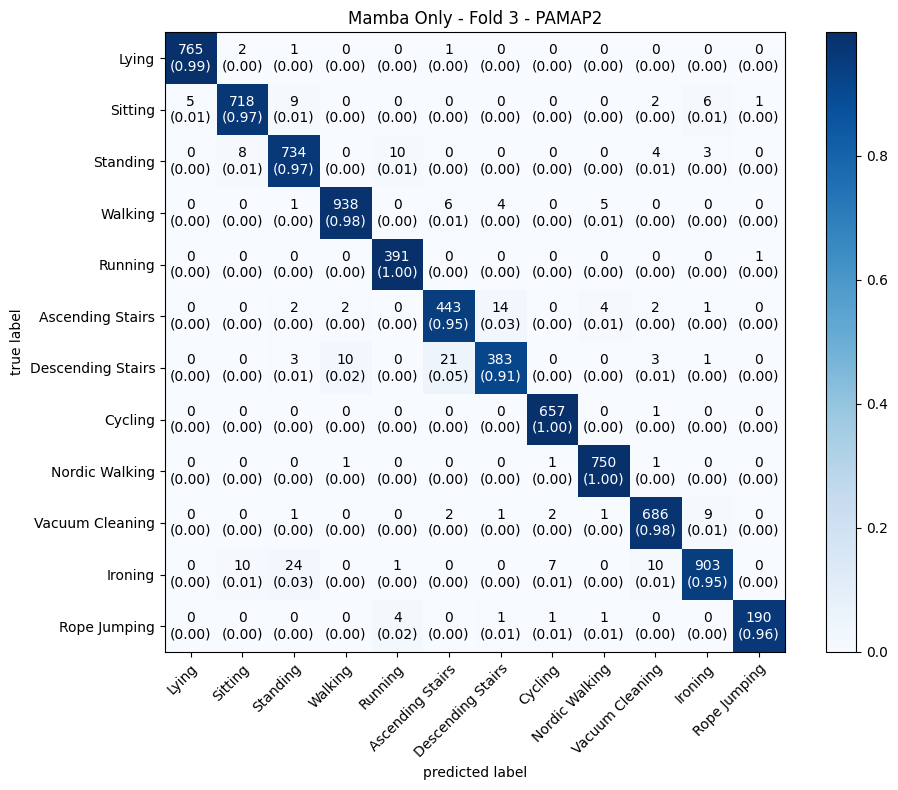


Fold 4/5
Model parameters: 425,949
START
Epoch 1/100 - Train Loss: 1.2382, Train Acc: 0.7644, Val Loss: 1.4326, Val Acc: 0.6292, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8056, Train Acc: 0.9113, Val Loss: 1.2153, Val Acc: 0.7105, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7362, Train Acc: 0.9338, Val Loss: 1.0439, Val Acc: 0.7924, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7029, Train Acc: 0.9489, Val Loss: 0.8872, Val Acc: 0.8637, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6703, Train Acc: 0.9566, Val Loss: 0.9455, Val Acc: 0.8143, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6605, Train Acc: 0.9631, Val Loss: 0.9458, Val Acc: 0.8401, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6332, Train Acc: 0.9708, Val Loss: 0.7347, Val Acc: 0.9215, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6237, Train Acc: 0.9754, Val Loss: 0.6749, Val Acc: 0.9462, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6214, Train Acc: 0.9788, Val Loss: 0.6638, Val Acc: 0.9465, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6062, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

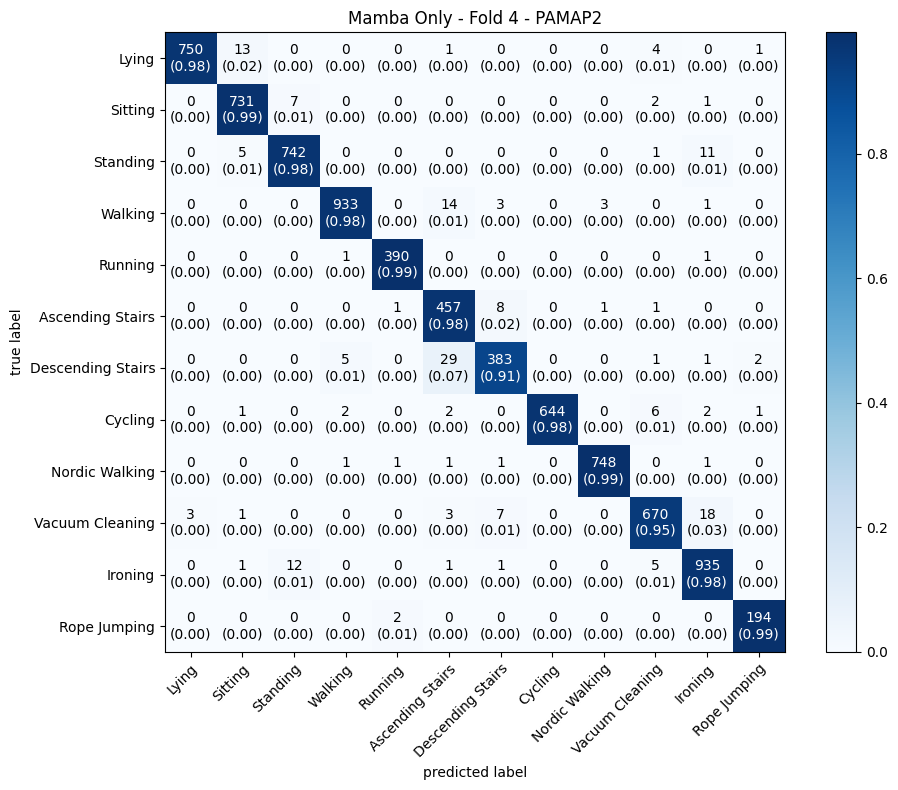


Fold 5/5
Model parameters: 425,949
START
Epoch 1/100 - Train Loss: 1.2641, Train Acc: 0.7488, Val Loss: 1.2237, Val Acc: 0.6997, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8181, Train Acc: 0.9101, Val Loss: 1.6601, Val Acc: 0.5979, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7401, Train Acc: 0.9347, Val Loss: 1.0175, Val Acc: 0.8225, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6996, Train Acc: 0.9469, Val Loss: 0.8640, Val Acc: 0.8645, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6676, Train Acc: 0.9589, Val Loss: 0.9503, Val Acc: 0.8521, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6551, Train Acc: 0.9645, Val Loss: 1.3295, Val Acc: 0.6908, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6328, Train Acc: 0.9713, Val Loss: 0.8908, Val Acc: 0.8610, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6310, Train Acc: 0.9752, Val Loss: 0.6549, Val Acc: 0.9534, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6133, Train Acc: 0.9805, Val Loss: 0.8251, Val Acc: 0.8853, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6033, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

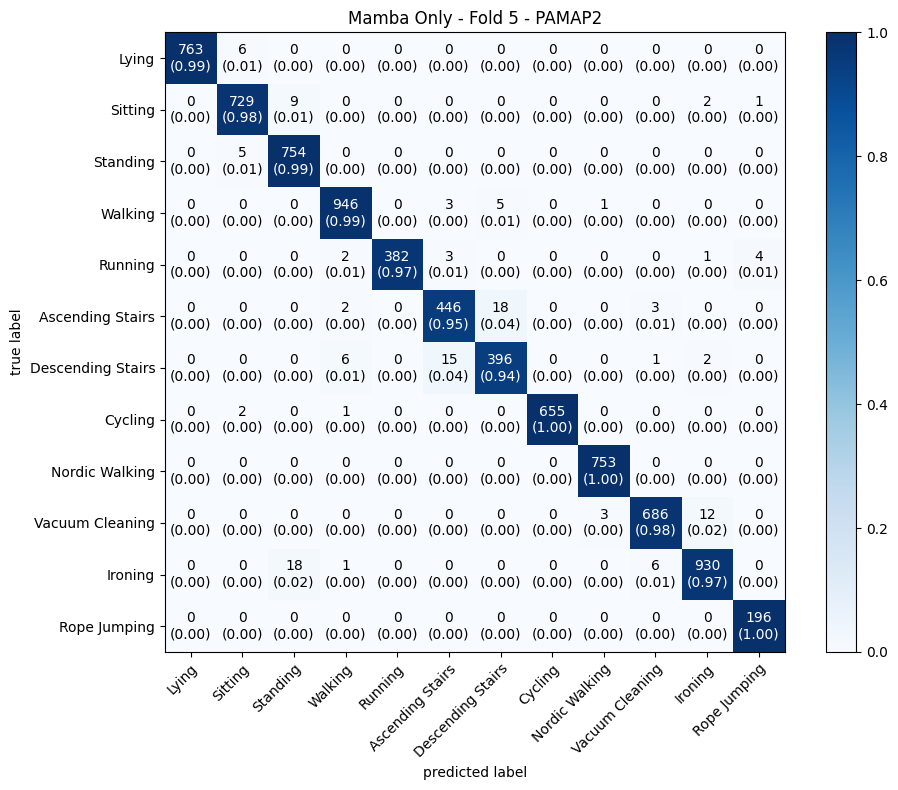


Generating t-SNE for Mamba Only using full training data...
t-SNE input shape: (31388, 540)
Running t-SNE for Mamba Only...


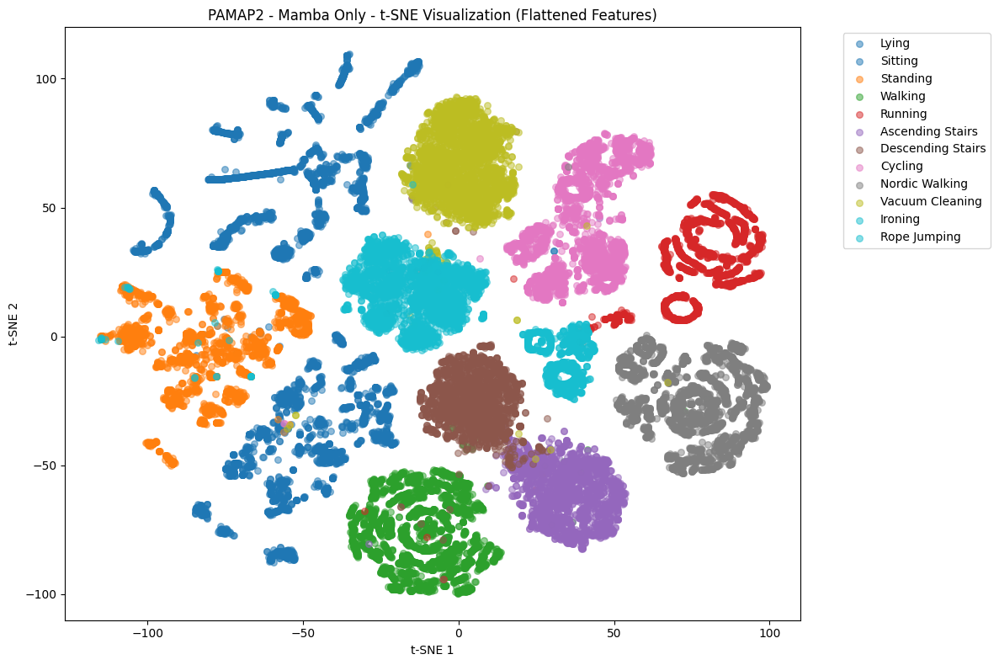


Mamba Only Average Results:
Accuracy: 0.9766, F1: 0.9766
Precision: 0.9768, Recall: 0.9766
Sensitivity: 0.9752, Specificity: 0.9979
Parameters: 425,949

--- CBAM-Patch-Mamba ---

Fold 1/5
Model parameters: 426,288
START
Epoch 1/100 - Train Loss: 1.2633, Train Acc: 0.7539, Val Loss: 1.1698, Val Acc: 0.7421, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7976, Train Acc: 0.9139, Val Loss: 0.9984, Val Acc: 0.8127, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7300, Train Acc: 0.9368, Val Loss: 1.1739, Val Acc: 0.7302, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6934, Train Acc: 0.9478, Val Loss: 1.2831, Val Acc: 0.7296, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6667, Train Acc: 0.9599, Val Loss: 0.8189, Val Acc: 0.8887, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6494, Train Acc: 0.9640, Val Loss: 0.8658, Val Acc: 0.8643, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6363, Train Acc: 0.9690, Val Loss: 0.8696, Val Acc: 0.8618, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6253, Train Acc: 0.9749, Val Loss: 0.7560, V

<Figure size 1000x800 with 0 Axes>

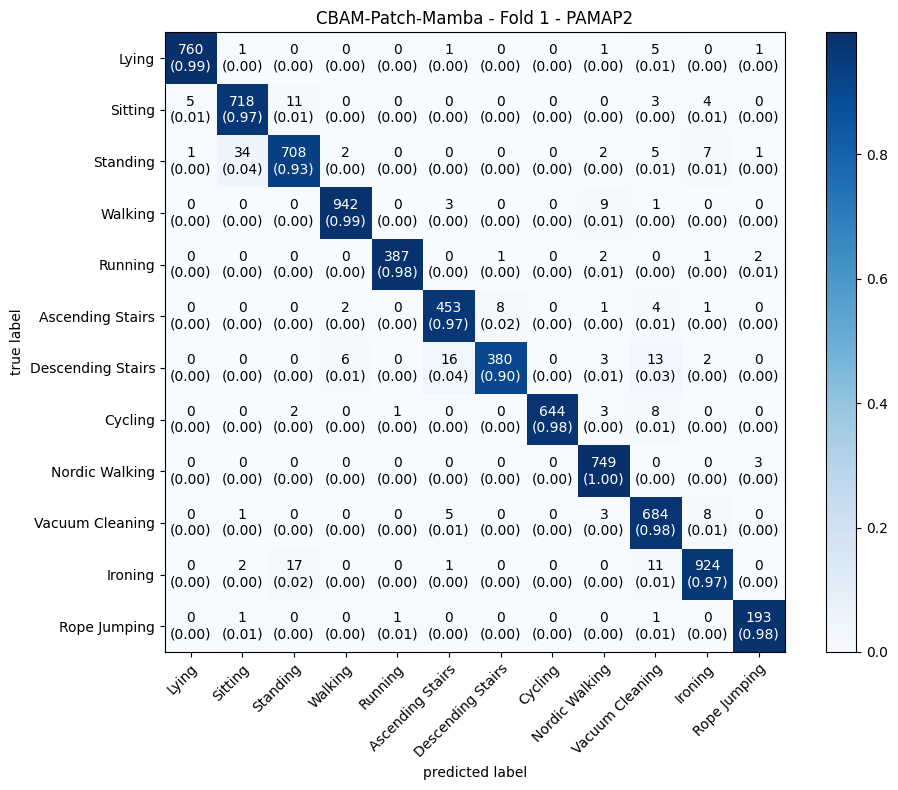


Fold 2/5
Model parameters: 426,288
START
Epoch 1/100 - Train Loss: 1.2503, Train Acc: 0.7609, Val Loss: 2.1639, Val Acc: 0.4661, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7990, Train Acc: 0.9130, Val Loss: 1.0528, Val Acc: 0.8033, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7308, Train Acc: 0.9346, Val Loss: 0.8950, Val Acc: 0.8547, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7100, Train Acc: 0.9446, Val Loss: 0.8891, Val Acc: 0.8597, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6749, Train Acc: 0.9541, Val Loss: 0.7791, Val Acc: 0.9067, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6614, Train Acc: 0.9616, Val Loss: 0.7793, Val Acc: 0.8932, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6407, Train Acc: 0.9683, Val Loss: 0.7254, Val Acc: 0.9289, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6256, Train Acc: 0.9730, Val Loss: 0.6737, Val Acc: 0.9400, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6180, Train Acc: 0.9771, Val Loss: 0.6908, Val Acc: 0.9408, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6061, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

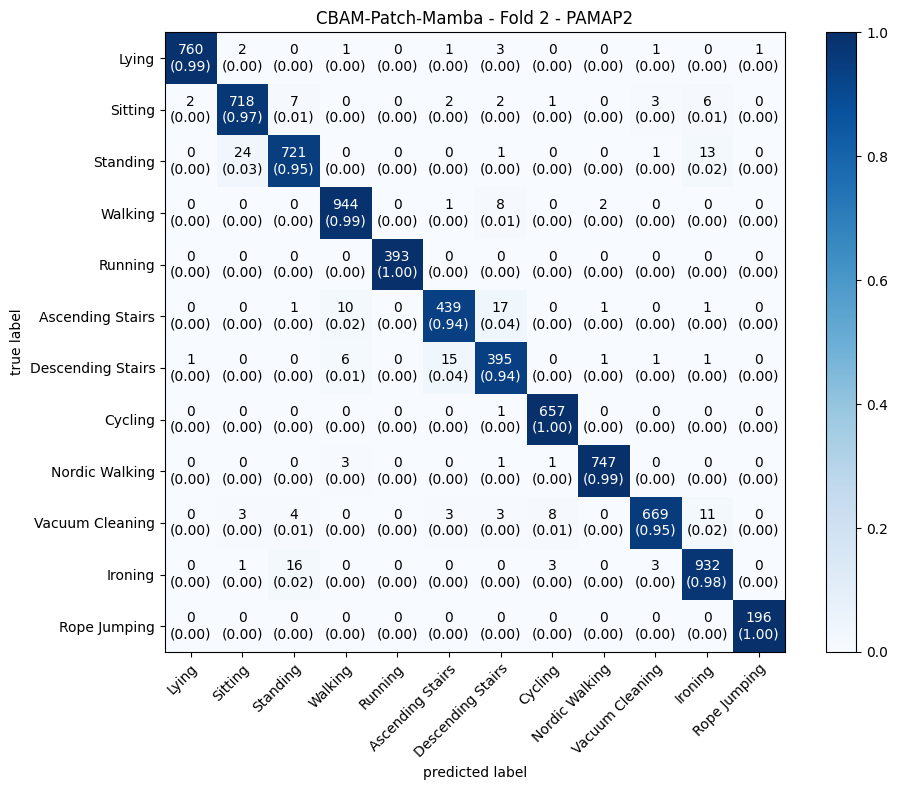


Fold 3/5
Model parameters: 426,288
START
Epoch 1/100 - Train Loss: 1.2435, Train Acc: 0.7607, Val Loss: 1.5094, Val Acc: 0.6326, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8116, Train Acc: 0.9111, Val Loss: 1.6886, Val Acc: 0.6195, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7384, Train Acc: 0.9340, Val Loss: 0.8514, Val Acc: 0.8757, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7044, Train Acc: 0.9478, Val Loss: 1.4409, Val Acc: 0.6548, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6803, Train Acc: 0.9557, Val Loss: 0.7842, Val Acc: 0.8992, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6619, Train Acc: 0.9631, Val Loss: 0.7988, Val Acc: 0.8978, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6353, Train Acc: 0.9697, Val Loss: 1.0909, Val Acc: 0.7948, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6247, Train Acc: 0.9750, Val Loss: 1.0710, Val Acc: 0.7839, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6160, Train Acc: 0.9785, Val Loss: 0.6559, Val Acc: 0.9516, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6023, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

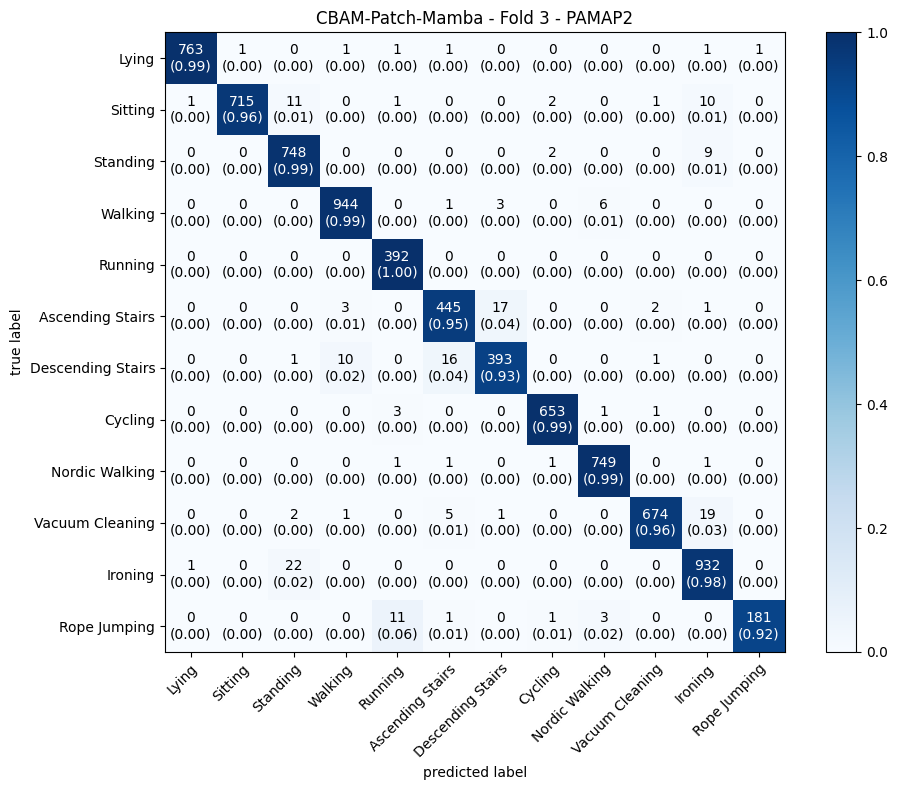


Fold 4/5
Model parameters: 426,288
START
Epoch 1/100 - Train Loss: 1.2794, Train Acc: 0.7473, Val Loss: 2.9039, Val Acc: 0.2358, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8143, Train Acc: 0.9099, Val Loss: 2.2004, Val Acc: 0.4434, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7349, Train Acc: 0.9350, Val Loss: 1.2854, Val Acc: 0.6985, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6959, Train Acc: 0.9504, Val Loss: 0.9238, Val Acc: 0.8516, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6640, Train Acc: 0.9601, Val Loss: 1.2064, Val Acc: 0.7052, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6466, Train Acc: 0.9666, Val Loss: 1.0320, Val Acc: 0.8062, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6281, Train Acc: 0.9733, Val Loss: 1.0442, Val Acc: 0.7998, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6209, Train Acc: 0.9776, Val Loss: 1.0877, Val Acc: 0.7898, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6054, Train Acc: 0.9812, Val Loss: 0.6731, Val Acc: 0.9416, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6039, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

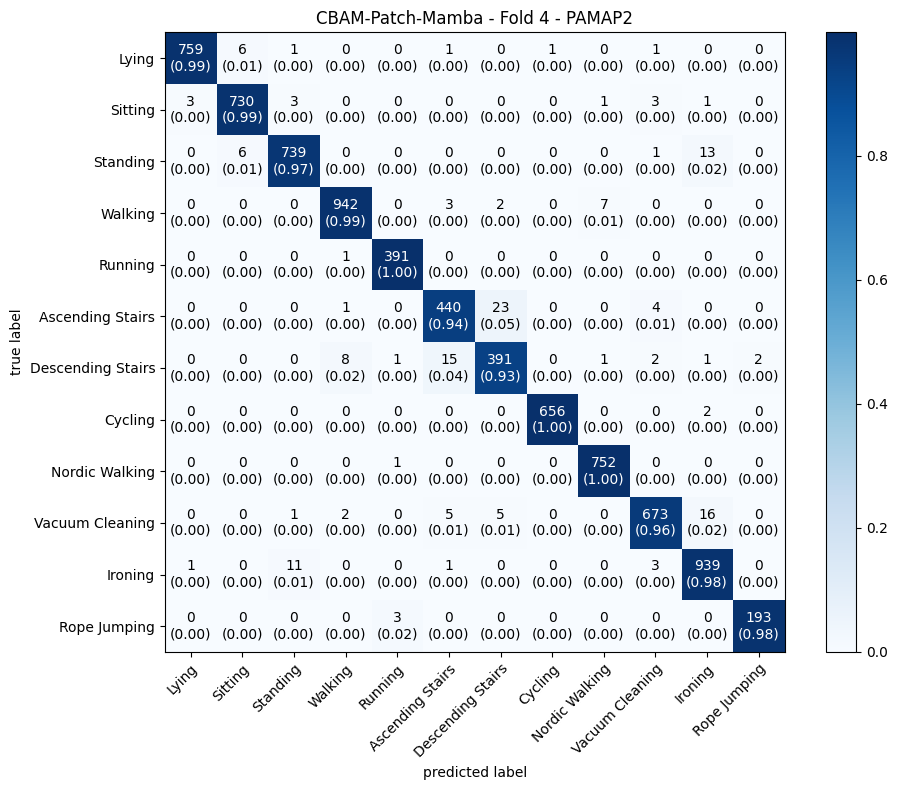


Fold 5/5
Model parameters: 426,288
START
Epoch 1/100 - Train Loss: 1.2601, Train Acc: 0.7609, Val Loss: 1.6349, Val Acc: 0.5711, LR: 0.000994
Epoch 2/100 - Train Loss: 0.8054, Train Acc: 0.9110, Val Loss: 1.0730, Val Acc: 0.7916, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7317, Train Acc: 0.9351, Val Loss: 1.1283, Val Acc: 0.7727, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6985, Train Acc: 0.9462, Val Loss: 0.9895, Val Acc: 0.8166, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6704, Train Acc: 0.9577, Val Loss: 1.1022, Val Acc: 0.7660, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6502, Train Acc: 0.9645, Val Loss: 0.8644, Val Acc: 0.8677, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6328, Train Acc: 0.9717, Val Loss: 0.6935, Val Acc: 0.9408, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6242, Train Acc: 0.9742, Val Loss: 0.7273, Val Acc: 0.9282, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6127, Train Acc: 0.9794, Val Loss: 0.6877, Val Acc: 0.9383, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6033, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

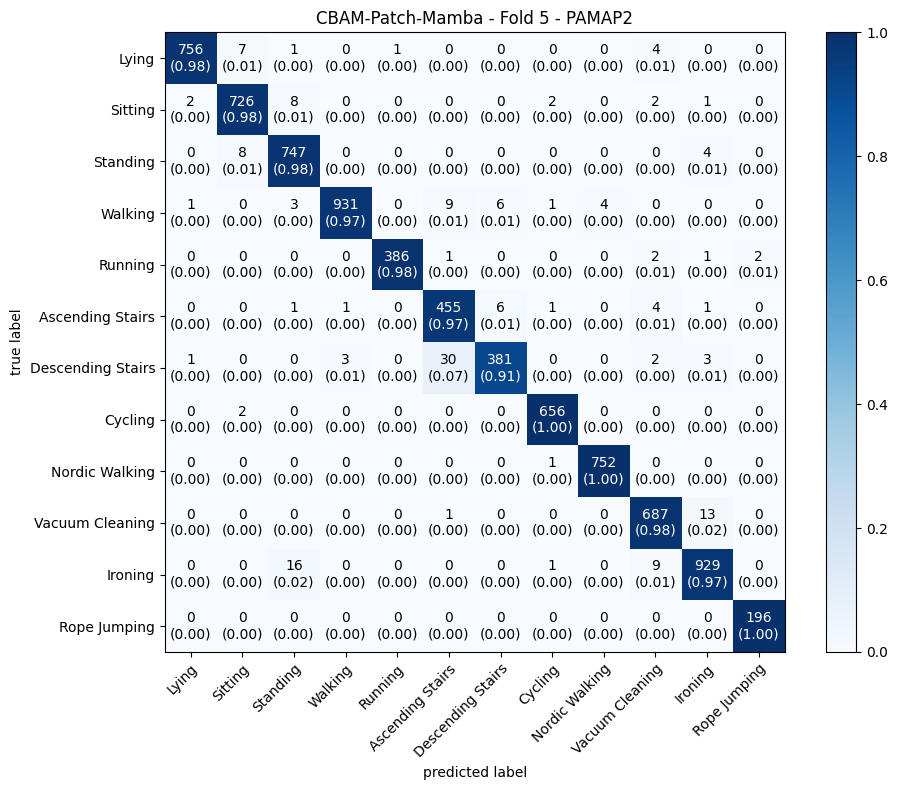


Generating t-SNE for CBAM-Patch-Mamba using full training data...
t-SNE input shape: (31388, 540)
Running t-SNE for CBAM-Patch-Mamba...


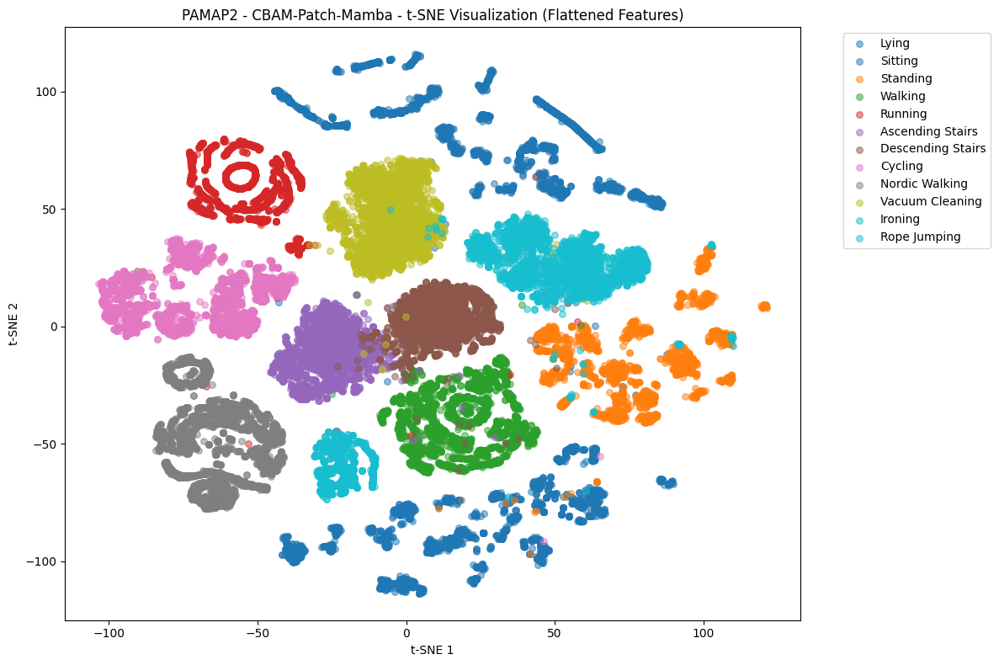


CBAM-Patch-Mamba Average Results:
Accuracy: 0.9760, F1: 0.9759
Precision: 0.9762, Recall: 0.9760
Sensitivity: 0.9740, Specificity: 0.9978
Parameters: 426,288

--- CBAM-Patch-Mamba-ContextAware ---

Fold 1/5
Model parameters: 840,053
START
Epoch 1/100 - Train Loss: 1.1341, Train Acc: 0.7892, Val Loss: 1.3198, Val Acc: 0.7269, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7775, Train Acc: 0.9242, Val Loss: 0.8648, Val Acc: 0.8754, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7111, Train Acc: 0.9451, Val Loss: 0.8340, Val Acc: 0.9072, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6776, Train Acc: 0.9579, Val Loss: 1.0872, Val Acc: 0.8033, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6481, Train Acc: 0.9677, Val Loss: 1.0096, Val Acc: 0.8481, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6292, Train Acc: 0.9749, Val Loss: 0.7607, Val Acc: 0.9363, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6181, Train Acc: 0.9794, Val Loss: 0.8702, Val Acc: 0.8753, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6059, Train Acc: 0.9830, 

<Figure size 1000x800 with 0 Axes>

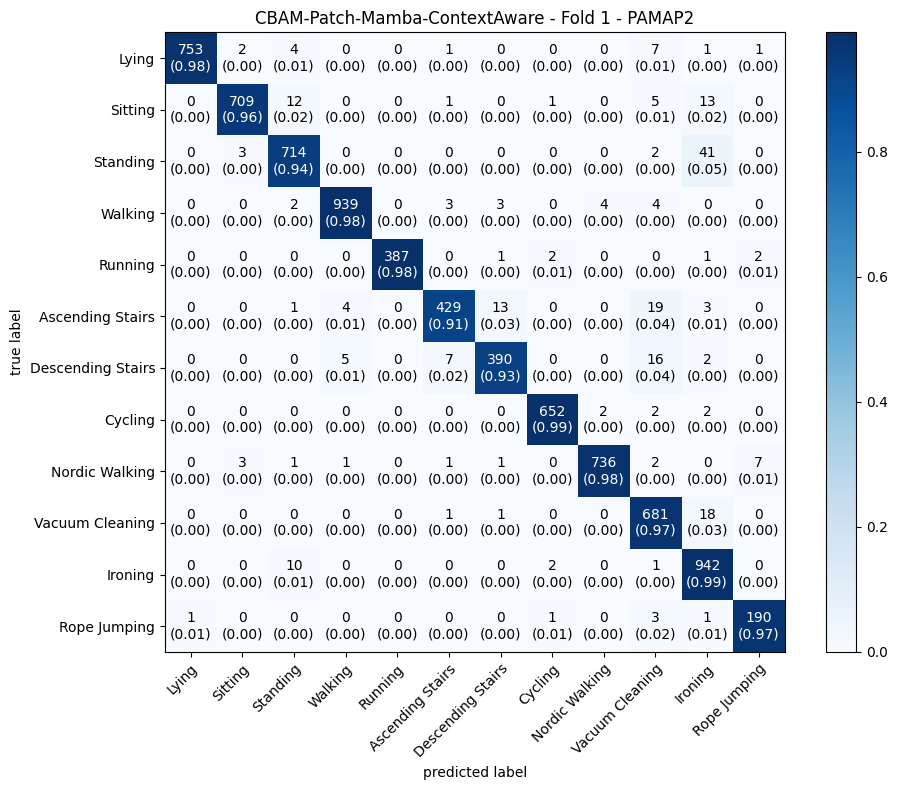


Fold 2/5
Model parameters: 840,053
START
Epoch 1/100 - Train Loss: 1.1280, Train Acc: 0.7901, Val Loss: 1.4261, Val Acc: 0.6577, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7741, Train Acc: 0.9269, Val Loss: 1.0123, Val Acc: 0.8395, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7058, Train Acc: 0.9467, Val Loss: 0.7999, Val Acc: 0.9148, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6673, Train Acc: 0.9599, Val Loss: 1.0826, Val Acc: 0.8009, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6441, Train Acc: 0.9676, Val Loss: 0.7959, Val Acc: 0.9176, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6266, Train Acc: 0.9748, Val Loss: 0.7343, Val Acc: 0.9301, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6139, Train Acc: 0.9801, Val Loss: 0.7239, Val Acc: 0.9426, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6007, Train Acc: 0.9843, Val Loss: 0.6360, Val Acc: 0.9681, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5965, Train Acc: 0.9863, Val Loss: 0.6408, Val Acc: 0.9669, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5908, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

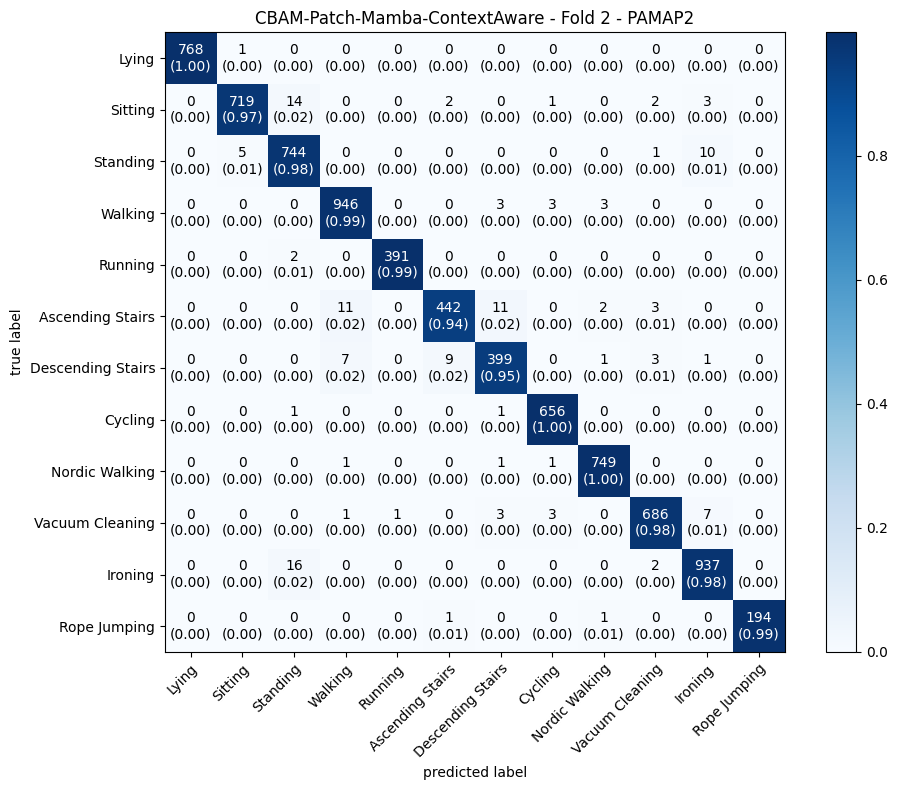


Fold 3/5
Model parameters: 840,053
START
Epoch 1/100 - Train Loss: 1.1508, Train Acc: 0.7809, Val Loss: 2.6162, Val Acc: 0.4792, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7858, Train Acc: 0.9208, Val Loss: 1.5063, Val Acc: 0.6402, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7040, Train Acc: 0.9472, Val Loss: 1.1353, Val Acc: 0.7980, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6706, Train Acc: 0.9610, Val Loss: 1.0296, Val Acc: 0.8305, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6466, Train Acc: 0.9703, Val Loss: 0.8594, Val Acc: 0.8816, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6269, Train Acc: 0.9765, Val Loss: 0.9392, Val Acc: 0.8471, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6183, Train Acc: 0.9783, Val Loss: 0.7816, Val Acc: 0.9270, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6045, Train Acc: 0.9829, Val Loss: 0.7938, Val Acc: 0.9221, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5962, Train Acc: 0.9856, Val Loss: 0.8226, Val Acc: 0.9000, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5903, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

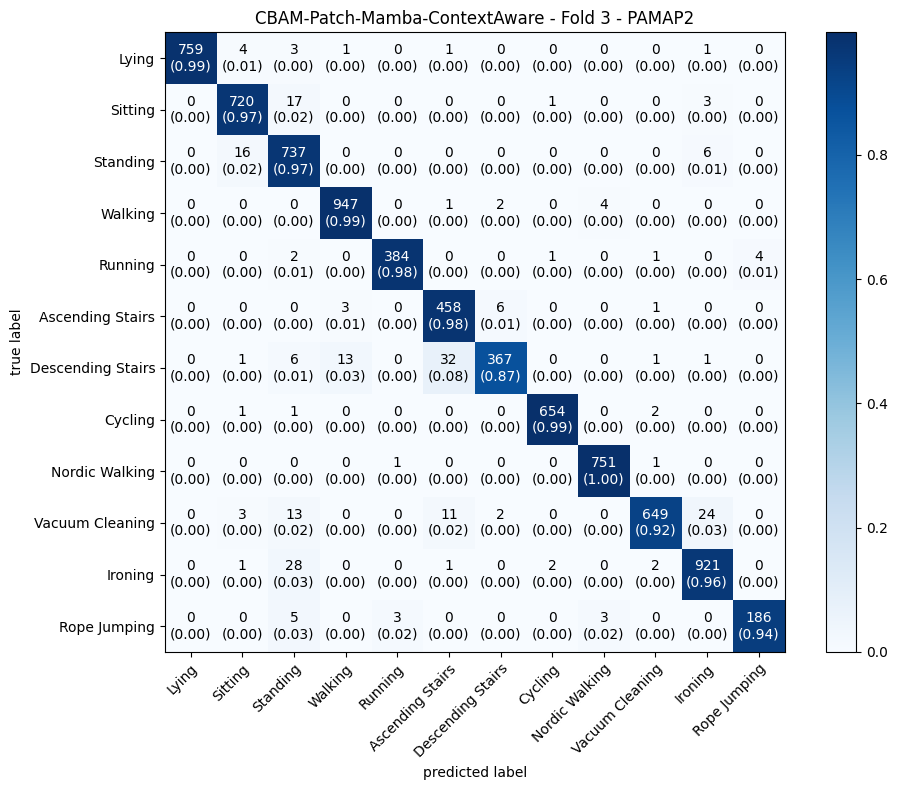


Fold 4/5
Model parameters: 840,053
START
Epoch 1/100 - Train Loss: 1.1182, Train Acc: 0.7938, Val Loss: 1.3397, Val Acc: 0.7000, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7704, Train Acc: 0.9267, Val Loss: 0.9245, Val Acc: 0.8664, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7022, Train Acc: 0.9477, Val Loss: 1.0426, Val Acc: 0.8140, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6835, Train Acc: 0.9600, Val Loss: 0.9781, Val Acc: 0.8497, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6488, Train Acc: 0.9683, Val Loss: 0.7793, Val Acc: 0.9217, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6246, Train Acc: 0.9769, Val Loss: 0.8169, Val Acc: 0.9205, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6156, Train Acc: 0.9796, Val Loss: 0.7476, Val Acc: 0.9287, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6046, Train Acc: 0.9827, Val Loss: 0.8366, Val Acc: 0.9041, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6013, Train Acc: 0.9858, Val Loss: 0.6924, Val Acc: 0.9547, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5897, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

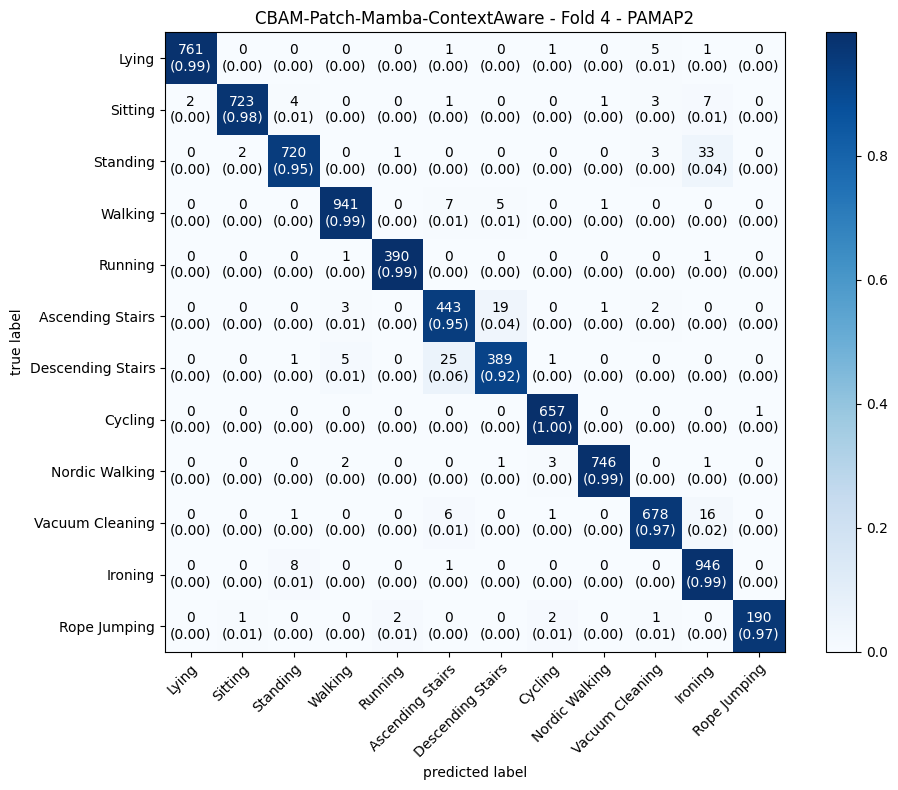


Fold 5/5
Model parameters: 840,053
START
Epoch 1/100 - Train Loss: 1.1245, Train Acc: 0.7934, Val Loss: 1.3889, Val Acc: 0.6955, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7704, Train Acc: 0.9261, Val Loss: 1.6287, Val Acc: 0.6225, LR: 0.000976
Epoch 3/100 - Train Loss: 0.7056, Train Acc: 0.9480, Val Loss: 0.9152, Val Acc: 0.8717, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6682, Train Acc: 0.9610, Val Loss: 0.8015, Val Acc: 0.9145, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6432, Train Acc: 0.9706, Val Loss: 0.7395, Val Acc: 0.9381, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6316, Train Acc: 0.9749, Val Loss: 0.7878, Val Acc: 0.9232, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6162, Train Acc: 0.9802, Val Loss: 0.7046, Val Acc: 0.9506, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6034, Train Acc: 0.9848, Val Loss: 0.7572, Val Acc: 0.9212, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5947, Train Acc: 0.9871, Val Loss: 0.6702, Val Acc: 0.9548, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5896, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

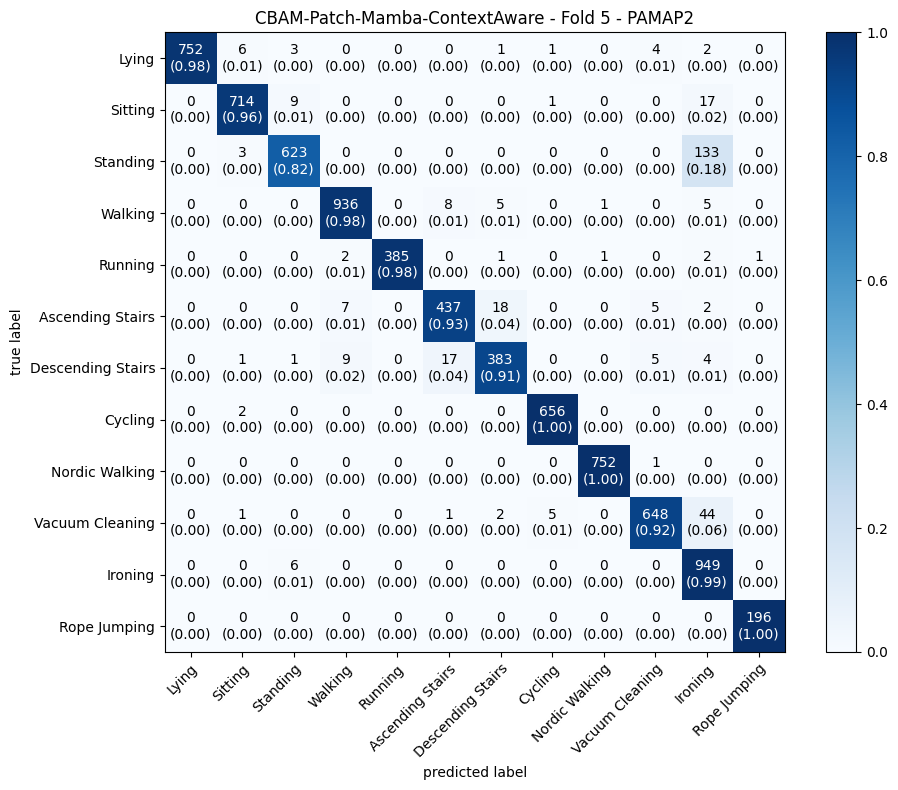


Generating t-SNE for CBAM-Patch-Mamba-ContextAware using full training data...
t-SNE input shape: (31388, 540)
Running t-SNE for CBAM-Patch-Mamba-ContextAware...


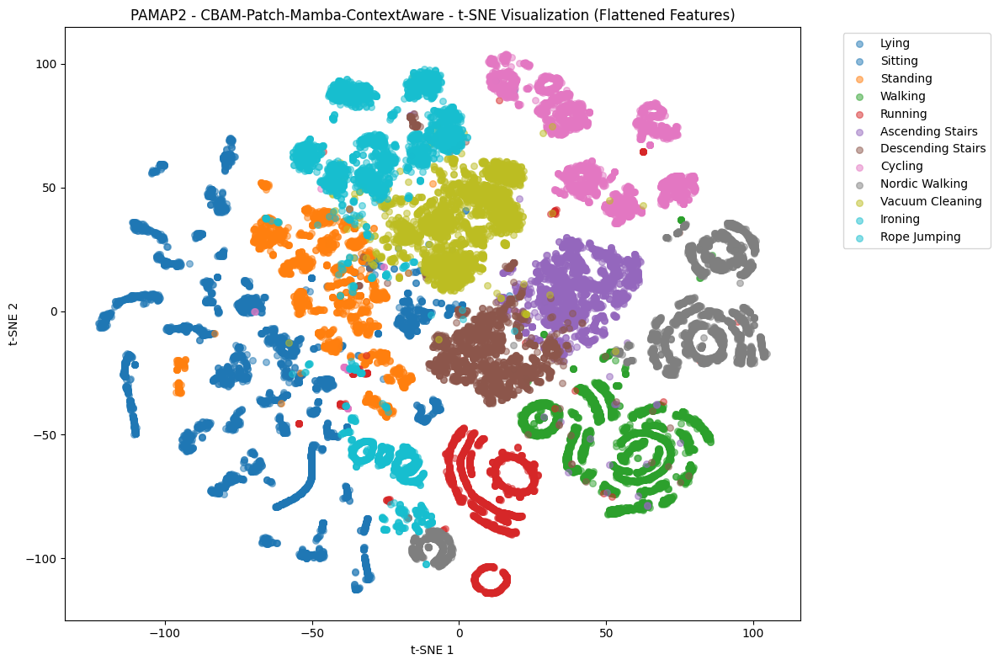


CBAM-Patch-Mamba-ContextAware Average Results:
Accuracy: 0.9706, F1: 0.9707
Precision: 0.9718, Recall: 0.9706
Sensitivity: 0.9682, Specificity: 0.9973
Parameters: 840,053
PAMAP2 ablation study completed!

Processing mHealth Dataset

=== Ablation Study for mHealth ===
Using device: cuda
Dataset: mHealth, Patch size: 10

--- Mamba Only ---

Fold 1/5
Model parameters: 183,999
START
Epoch 1/100 - Train Loss: 2.0705, Train Acc: 0.5637, Val Loss: 1.9388, Val Acc: 0.6927, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4538, Train Acc: 0.8165, Val Loss: 1.2843, Val Acc: 0.7466, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0258, Train Acc: 0.9178, Val Loss: 0.9377, Val Acc: 0.8797, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8175, Train Acc: 0.9502, Val Loss: 0.7198, Val Acc: 0.9533, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7186, Train Acc: 0.9712, Val Loss: 0.6208, Val Acc: 0.9840, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6670, Train Acc: 0.9917, Val Loss: 0.5995, Val Acc: 0.9887, LR: 0.000794
Epoch 7/100

<Figure size 1000x800 with 0 Axes>

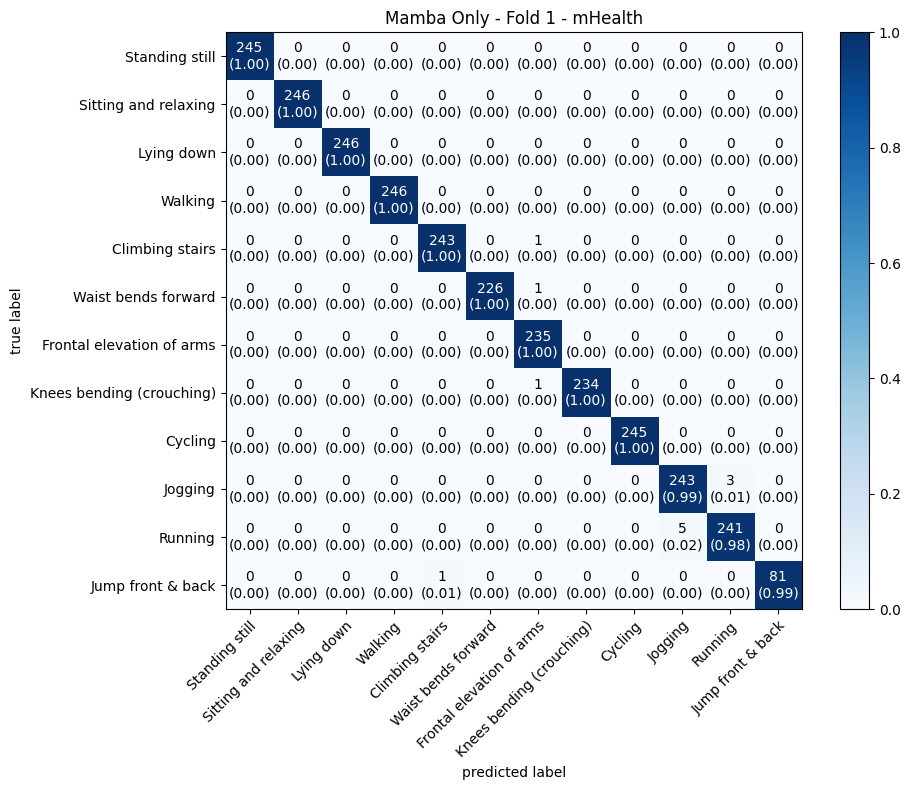


Fold 2/5
Model parameters: 183,999
START
Epoch 1/100 - Train Loss: 2.0517, Train Acc: 0.5953, Val Loss: 1.9059, Val Acc: 0.6285, LR: 0.000994
Epoch 2/100 - Train Loss: 1.3937, Train Acc: 0.8498, Val Loss: 1.1547, Val Acc: 0.8684, LR: 0.000976
Epoch 3/100 - Train Loss: 0.9859, Train Acc: 0.9317, Val Loss: 0.9508, Val Acc: 0.8695, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8038, Train Acc: 0.9533, Val Loss: 0.7468, Val Acc: 0.9533, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7170, Train Acc: 0.9737, Val Loss: 0.6165, Val Acc: 0.9887, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6643, Train Acc: 0.9923, Val Loss: 0.5779, Val Acc: 0.9945, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6369, Train Acc: 0.9956, Val Loss: 0.5670, Val Acc: 0.9927, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6312, Train Acc: 0.9948, Val Loss: 0.5734, Val Acc: 0.9923, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6174, Train Acc: 0.9976, Val Loss: 0.5523, Val Acc: 0.9971, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6131, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

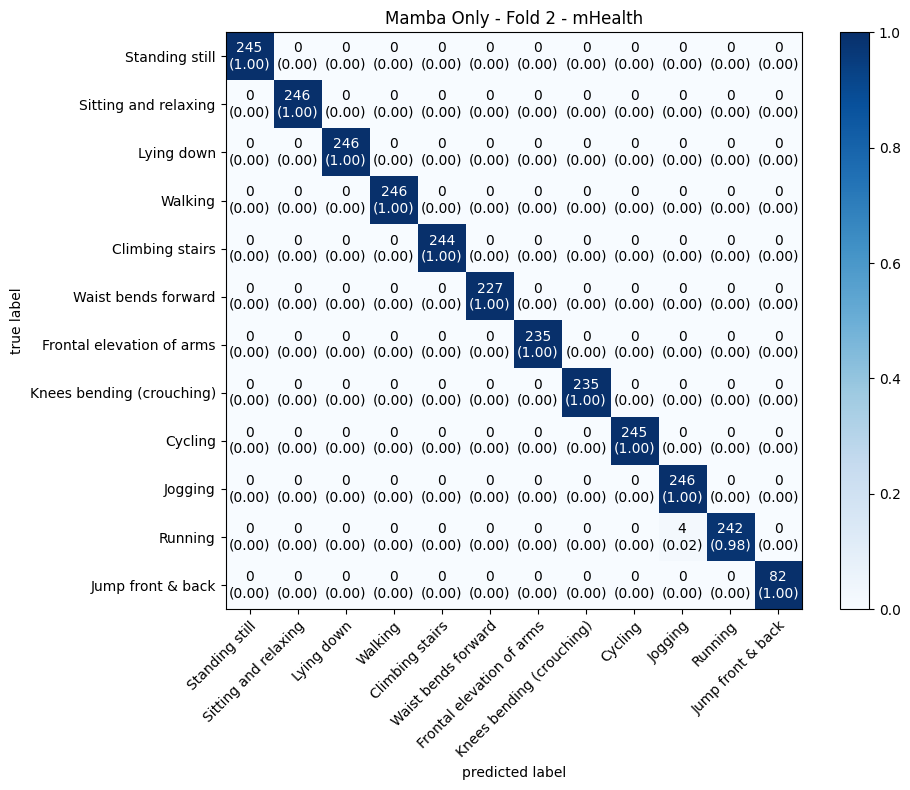


Fold 3/5
Model parameters: 183,999
START
Epoch 1/100 - Train Loss: 2.0583, Train Acc: 0.5915, Val Loss: 1.9249, Val Acc: 0.6114, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4312, Train Acc: 0.8093, Val Loss: 1.2343, Val Acc: 0.7572, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0121, Train Acc: 0.9070, Val Loss: 1.0052, Val Acc: 0.8028, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7917, Train Acc: 0.9610, Val Loss: 0.6642, Val Acc: 0.9883, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6916, Train Acc: 0.9882, Val Loss: 0.6071, Val Acc: 0.9916, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6503, Train Acc: 0.9938, Val Loss: 0.5645, Val Acc: 0.9971, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6325, Train Acc: 0.9954, Val Loss: 0.5613, Val Acc: 0.9956, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6196, Train Acc: 0.9977, Val Loss: 0.5529, Val Acc: 0.9971, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6155, Train Acc: 0.9982, Val Loss: 0.5594, Val Acc: 0.9960, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6122, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

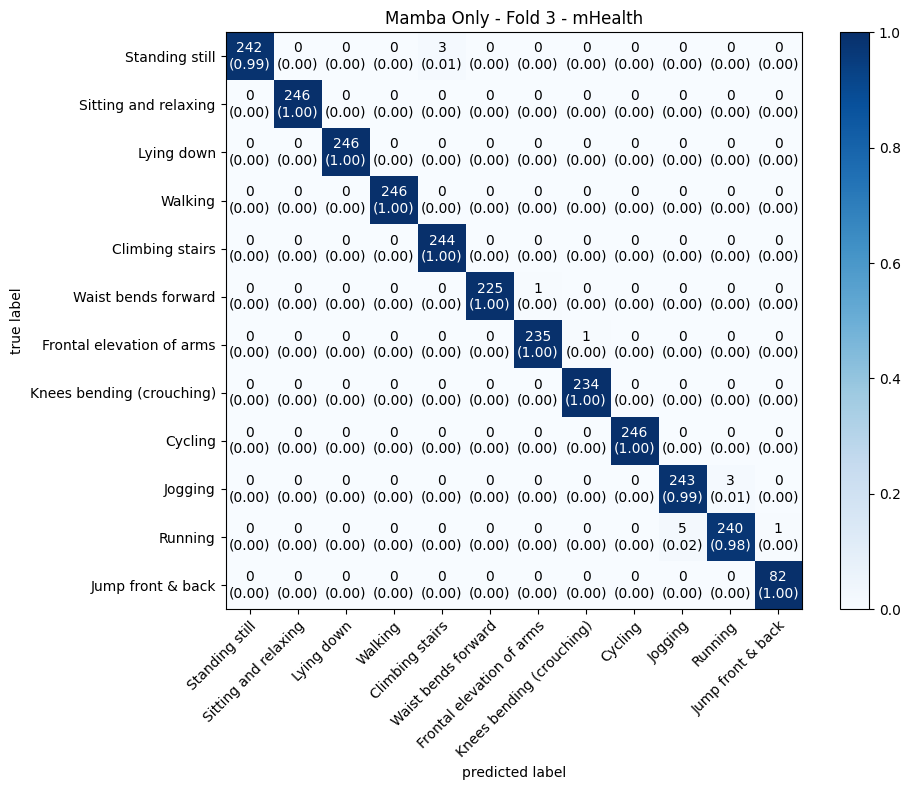


Fold 4/5
Model parameters: 183,999
START
Epoch 1/100 - Train Loss: 2.0567, Train Acc: 0.5571, Val Loss: 1.9402, Val Acc: 0.4419, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4797, Train Acc: 0.7784, Val Loss: 1.3244, Val Acc: 0.7605, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0876, Train Acc: 0.8956, Val Loss: 1.0040, Val Acc: 0.8866, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8445, Train Acc: 0.9458, Val Loss: 0.7601, Val Acc: 0.9435, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7344, Train Acc: 0.9673, Val Loss: 0.6197, Val Acc: 0.9894, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6702, Train Acc: 0.9921, Val Loss: 0.5965, Val Acc: 0.9883, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6443, Train Acc: 0.9964, Val Loss: 0.5691, Val Acc: 0.9945, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6284, Train Acc: 0.9966, Val Loss: 0.5581, Val Acc: 0.9967, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6197, Train Acc: 0.9978, Val Loss: 0.5527, Val Acc: 0.9967, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6130, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

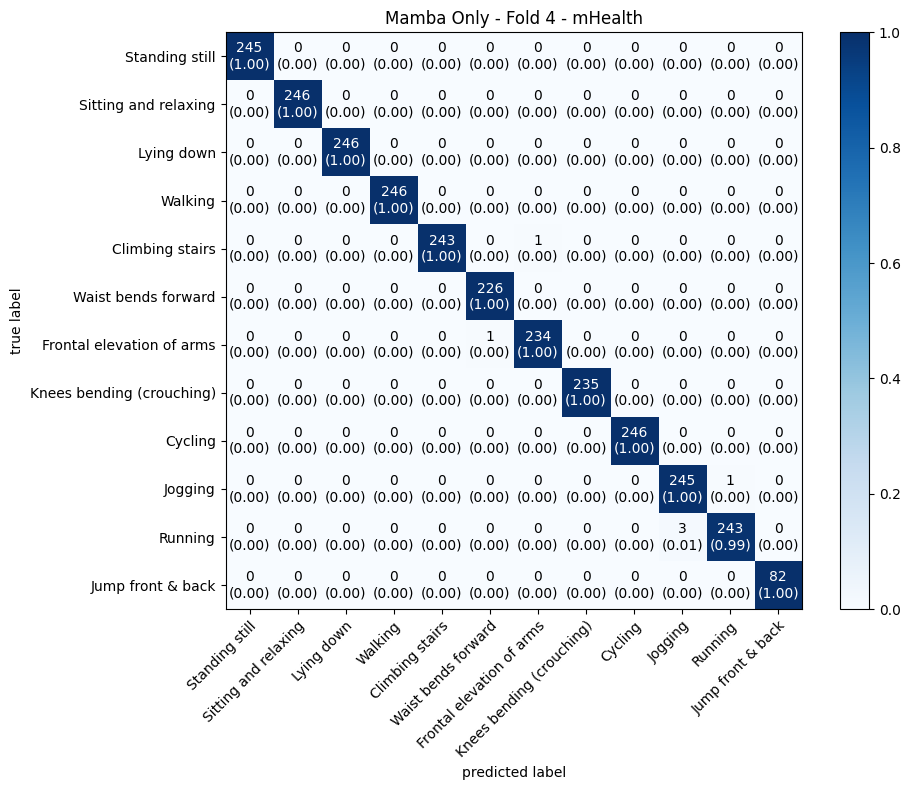


Fold 5/5
Model parameters: 183,999
START
Epoch 1/100 - Train Loss: 2.0474, Train Acc: 0.6274, Val Loss: 1.8653, Val Acc: 0.7204, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4238, Train Acc: 0.8338, Val Loss: 1.2927, Val Acc: 0.7145, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0037, Train Acc: 0.9019, Val Loss: 0.9053, Val Acc: 0.8979, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8011, Train Acc: 0.9623, Val Loss: 0.7310, Val Acc: 0.9537, LR: 0.000905
Epoch 5/100 - Train Loss: 0.6959, Train Acc: 0.9880, Val Loss: 0.6046, Val Acc: 0.9934, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6510, Train Acc: 0.9940, Val Loss: 0.5822, Val Acc: 0.9920, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6289, Train Acc: 0.9965, Val Loss: 0.5714, Val Acc: 0.9913, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6200, Train Acc: 0.9968, Val Loss: 0.5636, Val Acc: 0.9931, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6160, Train Acc: 0.9978, Val Loss: 0.5597, Val Acc: 0.9938, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6084, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

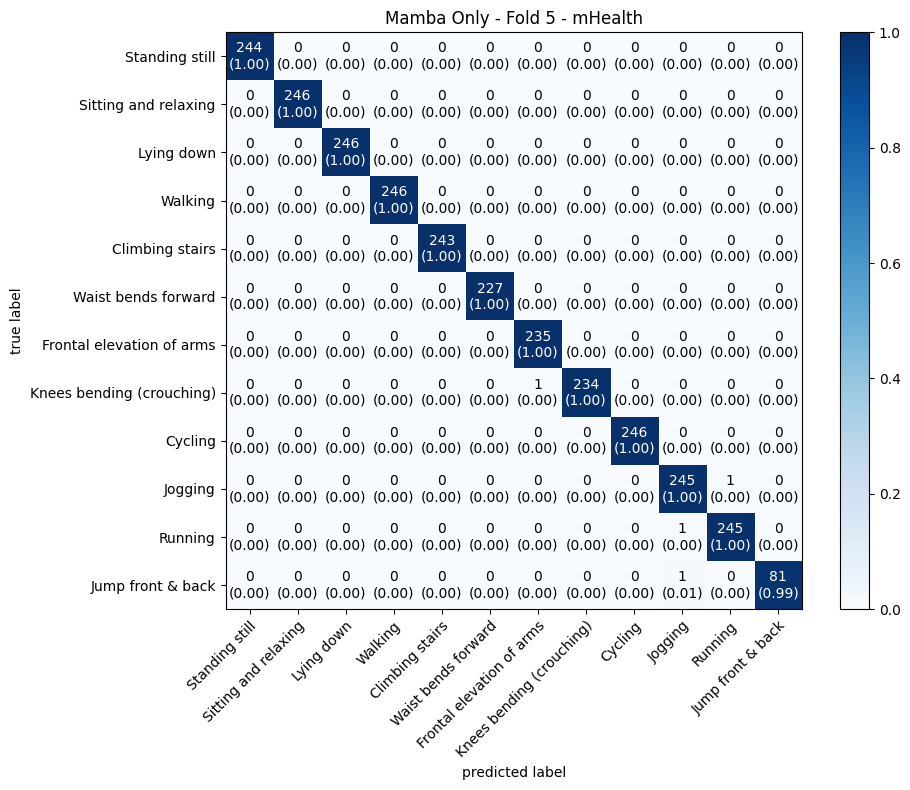


Generating t-SNE for Mamba Only using full training data...
t-SNE input shape: (13714, 210)
Running t-SNE for Mamba Only...


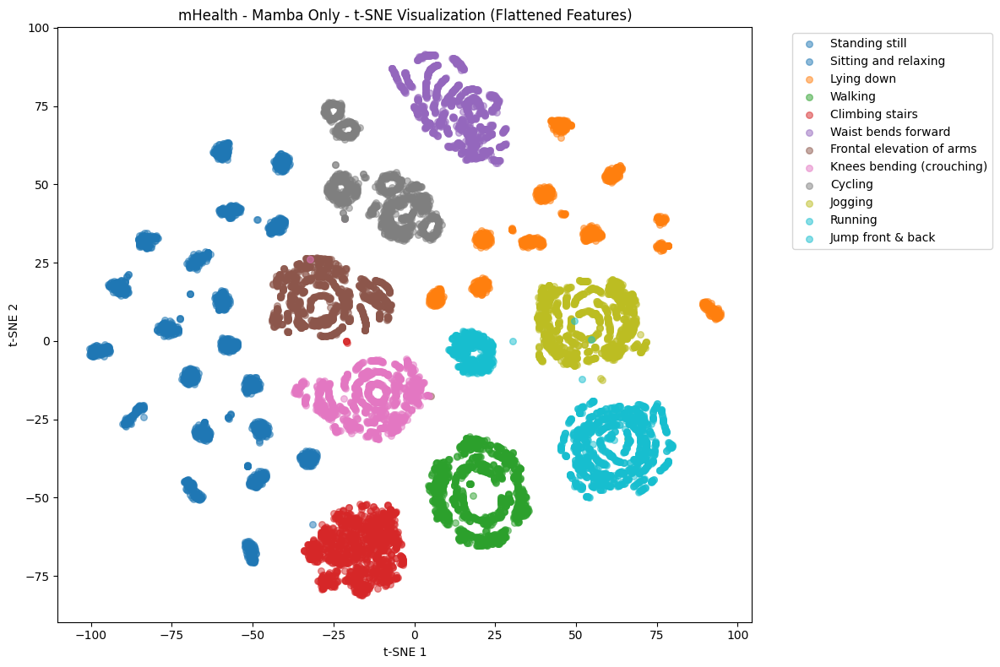


Mamba Only Average Results:
Accuracy: 0.9971, F1: 0.9971
Precision: 0.9971, Recall: 0.9971
Sensitivity: 0.9970, Specificity: 0.9997
Parameters: 183,999

--- CBAM-Patch-Mamba ---

Fold 1/5
Model parameters: 184,224
START
Epoch 1/100 - Train Loss: 2.0701, Train Acc: 0.5767, Val Loss: 2.2147, Val Acc: 0.4287, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4361, Train Acc: 0.8418, Val Loss: 1.2551, Val Acc: 0.8057, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0183, Train Acc: 0.9146, Val Loss: 0.8607, Val Acc: 0.9431, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8200, Train Acc: 0.9465, Val Loss: 0.9025, Val Acc: 0.8709, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7285, Train Acc: 0.9707, Val Loss: 0.7137, Val Acc: 0.9501, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6729, Train Acc: 0.9914, Val Loss: 0.6128, Val Acc: 0.9821, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6386, Train Acc: 0.9950, Val Loss: 0.6156, Val Acc: 0.9785, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6283, Train Acc: 0.9964, Val Loss: 0.5654, V

<Figure size 1000x800 with 0 Axes>

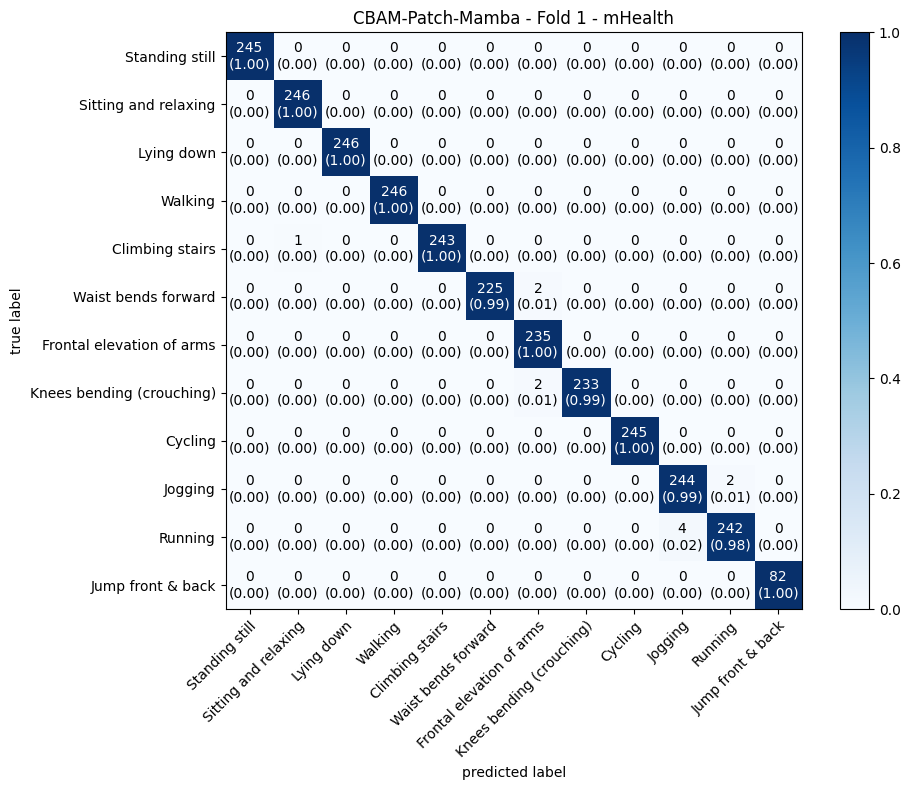


Fold 2/5
Model parameters: 184,224
START
Epoch 1/100 - Train Loss: 2.0746, Train Acc: 0.5976, Val Loss: 2.2836, Val Acc: 0.4645, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4468, Train Acc: 0.8046, Val Loss: 1.2379, Val Acc: 0.8301, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0327, Train Acc: 0.9143, Val Loss: 0.8471, Val Acc: 0.9326, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8197, Train Acc: 0.9511, Val Loss: 0.8264, Val Acc: 0.8990, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7245, Train Acc: 0.9708, Val Loss: 0.6299, Val Acc: 0.9894, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6667, Train Acc: 0.9930, Val Loss: 0.5905, Val Acc: 0.9923, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6406, Train Acc: 0.9953, Val Loss: 0.5738, Val Acc: 0.9913, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6251, Train Acc: 0.9968, Val Loss: 0.5810, Val Acc: 0.9909, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6197, Train Acc: 0.9972, Val Loss: 0.5597, Val Acc: 0.9964, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6136, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

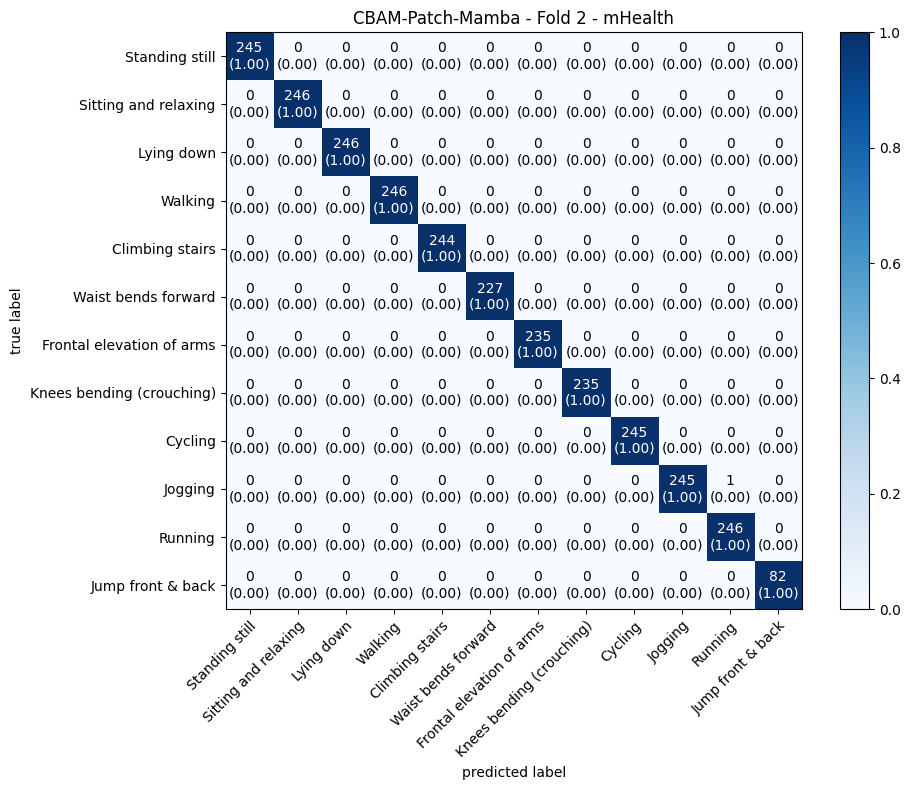


Fold 3/5
Model parameters: 184,224
START
Epoch 1/100 - Train Loss: 2.0669, Train Acc: 0.6018, Val Loss: 2.1584, Val Acc: 0.5162, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4416, Train Acc: 0.8211, Val Loss: 1.3232, Val Acc: 0.7459, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0298, Train Acc: 0.9056, Val Loss: 0.9064, Val Acc: 0.9194, LR: 0.000946
Epoch 4/100 - Train Loss: 0.8241, Train Acc: 0.9479, Val Loss: 0.7762, Val Acc: 0.9369, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7243, Train Acc: 0.9708, Val Loss: 0.6512, Val Acc: 0.9748, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6653, Train Acc: 0.9914, Val Loss: 0.6268, Val Acc: 0.9814, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6438, Train Acc: 0.9943, Val Loss: 0.6009, Val Acc: 0.9876, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6293, Train Acc: 0.9959, Val Loss: 0.5664, Val Acc: 0.9967, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6203, Train Acc: 0.9976, Val Loss: 0.5580, Val Acc: 0.9956, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6157, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

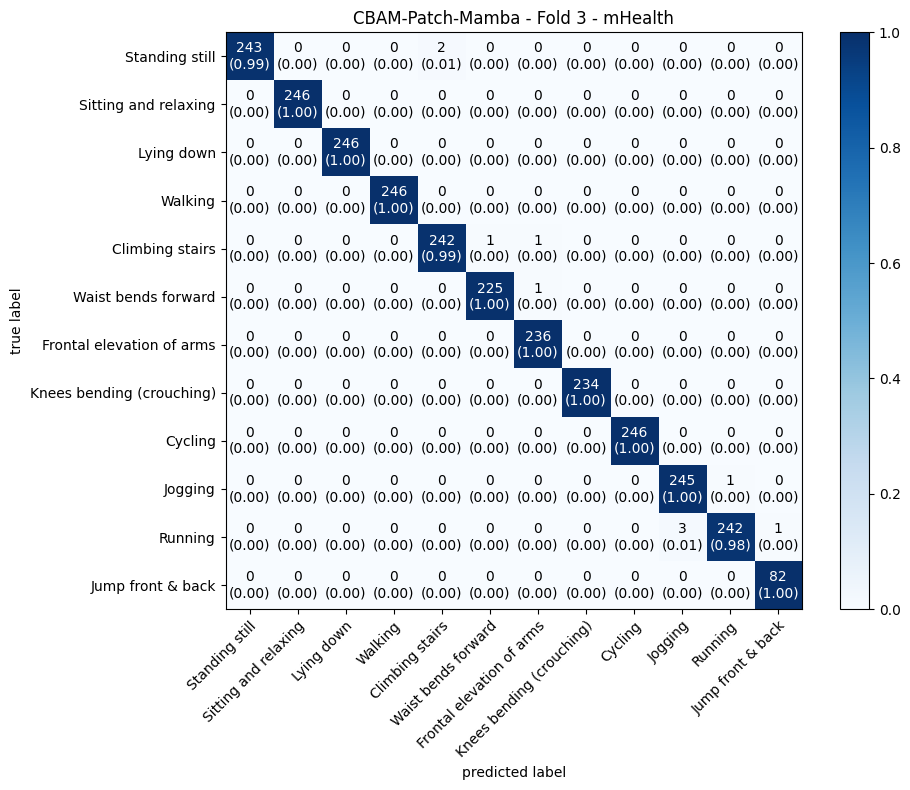


Fold 4/5
Model parameters: 184,224
START
Epoch 1/100 - Train Loss: 2.0657, Train Acc: 0.6151, Val Loss: 2.3436, Val Acc: 0.1393, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4121, Train Acc: 0.8419, Val Loss: 1.1855, Val Acc: 0.8458, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0012, Train Acc: 0.9154, Val Loss: 0.8560, Val Acc: 0.9187, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7998, Train Acc: 0.9503, Val Loss: 0.7290, Val Acc: 0.9355, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7059, Train Acc: 0.9741, Val Loss: 0.6095, Val Acc: 0.9909, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6592, Train Acc: 0.9930, Val Loss: 0.5719, Val Acc: 0.9949, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6365, Train Acc: 0.9966, Val Loss: 0.5632, Val Acc: 0.9956, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6217, Train Acc: 0.9978, Val Loss: 0.5612, Val Acc: 0.9938, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6172, Train Acc: 0.9976, Val Loss: 0.5544, Val Acc: 0.9964, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6146, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

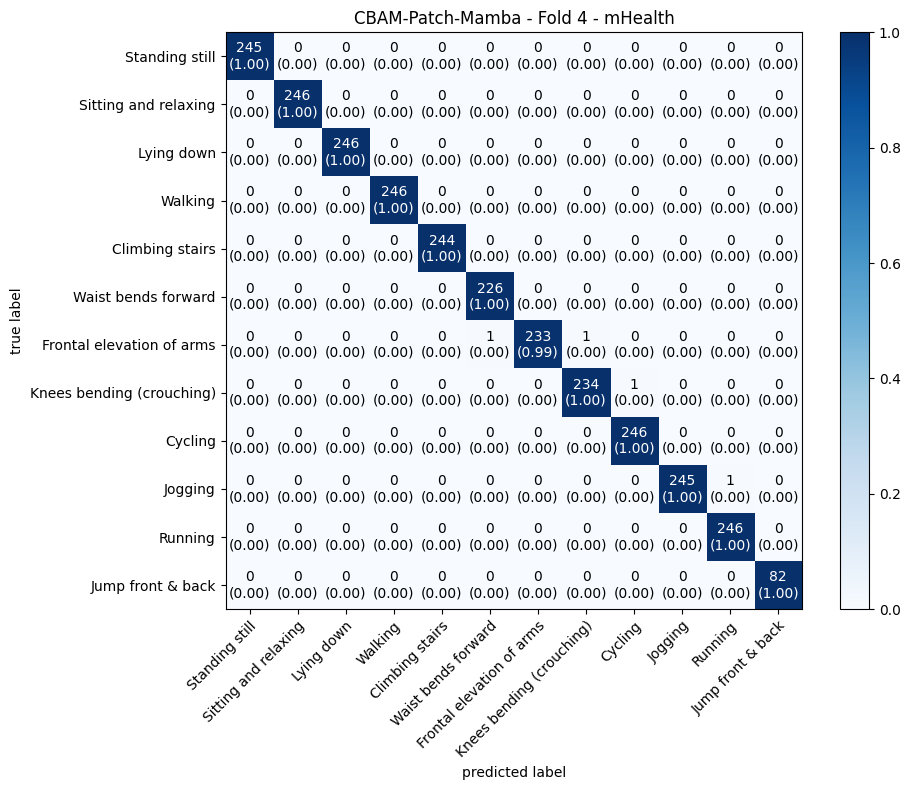


Fold 5/5
Model parameters: 184,224
START
Epoch 1/100 - Train Loss: 2.0780, Train Acc: 0.5709, Val Loss: 2.2787, Val Acc: 0.4495, LR: 0.000994
Epoch 2/100 - Train Loss: 1.4689, Train Acc: 0.8221, Val Loss: 1.3824, Val Acc: 0.6715, LR: 0.000976
Epoch 3/100 - Train Loss: 1.0209, Train Acc: 0.9216, Val Loss: 0.9585, Val Acc: 0.8647, LR: 0.000946
Epoch 4/100 - Train Loss: 0.7938, Train Acc: 0.9509, Val Loss: 0.6768, Val Acc: 0.9537, LR: 0.000905
Epoch 5/100 - Train Loss: 0.7022, Train Acc: 0.9740, Val Loss: 0.6588, Val Acc: 0.9632, LR: 0.000854
Epoch 6/100 - Train Loss: 0.6537, Train Acc: 0.9917, Val Loss: 0.5775, Val Acc: 0.9934, LR: 0.000794
Epoch 7/100 - Train Loss: 0.6262, Train Acc: 0.9953, Val Loss: 0.5660, Val Acc: 0.9949, LR: 0.000727
Epoch 8/100 - Train Loss: 0.6174, Train Acc: 0.9964, Val Loss: 0.5618, Val Acc: 0.9913, LR: 0.000655
Epoch 9/100 - Train Loss: 0.6103, Train Acc: 0.9977, Val Loss: 0.5566, Val Acc: 0.9934, LR: 0.000579
Epoch 10/100 - Train Loss: 0.6043, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

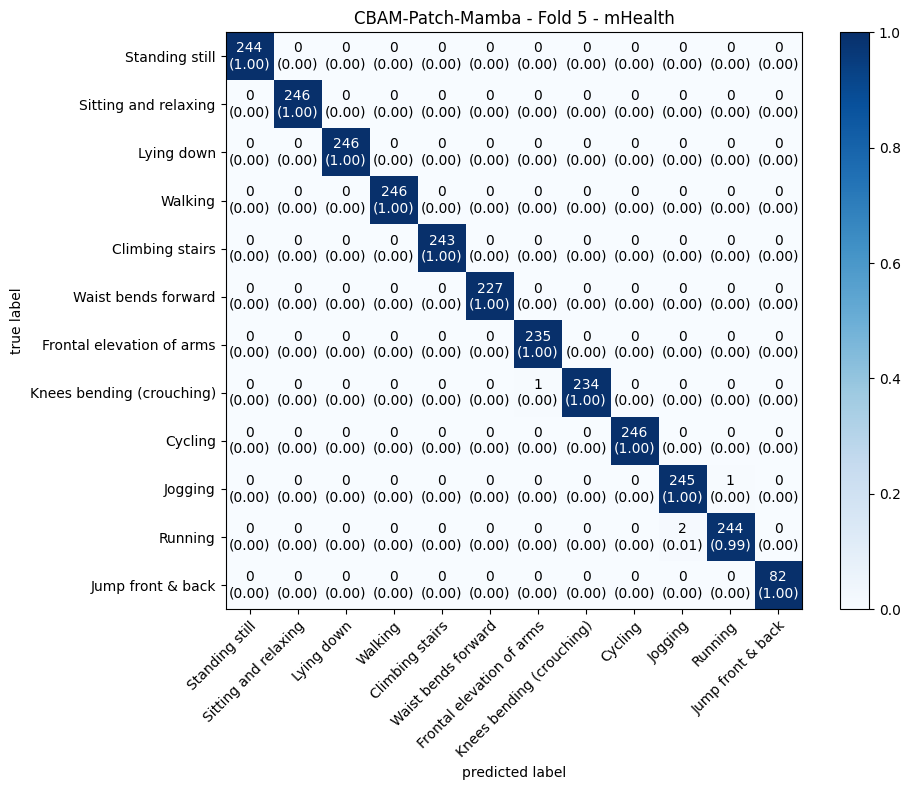


Generating t-SNE for CBAM-Patch-Mamba using full training data...
t-SNE input shape: (13714, 210)
Running t-SNE for CBAM-Patch-Mamba...


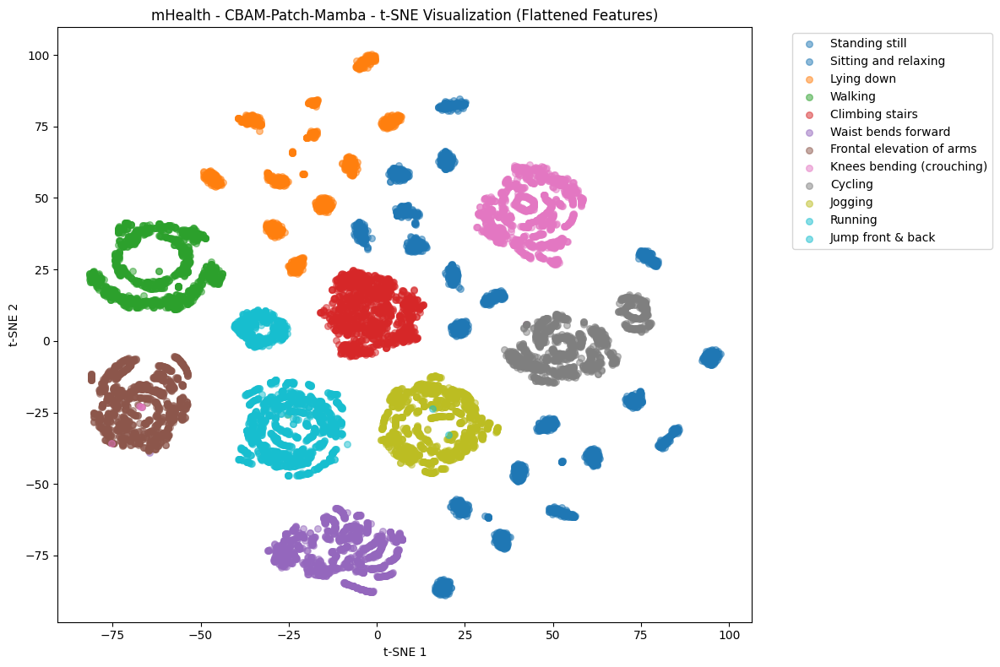


CBAM-Patch-Mamba Average Results:
Accuracy: 0.9978, F1: 0.9978
Precision: 0.9978, Recall: 0.9978
Sensitivity: 0.9979, Specificity: 0.9998
Parameters: 184,224

--- CBAM-Patch-Mamba-ContextAware ---

Fold 1/5
Model parameters: 249,899
START
Epoch 1/100 - Train Loss: 1.4394, Train Acc: 0.6793, Val Loss: 2.4734, Val Acc: 0.2220, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7528, Train Acc: 0.9447, Val Loss: 0.9270, Val Acc: 0.8502, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6383, Train Acc: 0.9868, Val Loss: 0.6331, Val Acc: 0.9810, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5945, Train Acc: 0.9930, Val Loss: 0.6176, Val Acc: 0.9891, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5771, Train Acc: 0.9961, Val Loss: 0.5803, Val Acc: 0.9953, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5673, Train Acc: 0.9972, Val Loss: 0.5717, Val Acc: 0.9953, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5597, Train Acc: 0.9989, Val Loss: 0.5689, Val Acc: 0.9960, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5560, Train Acc: 0.9996, 

<Figure size 1000x800 with 0 Axes>

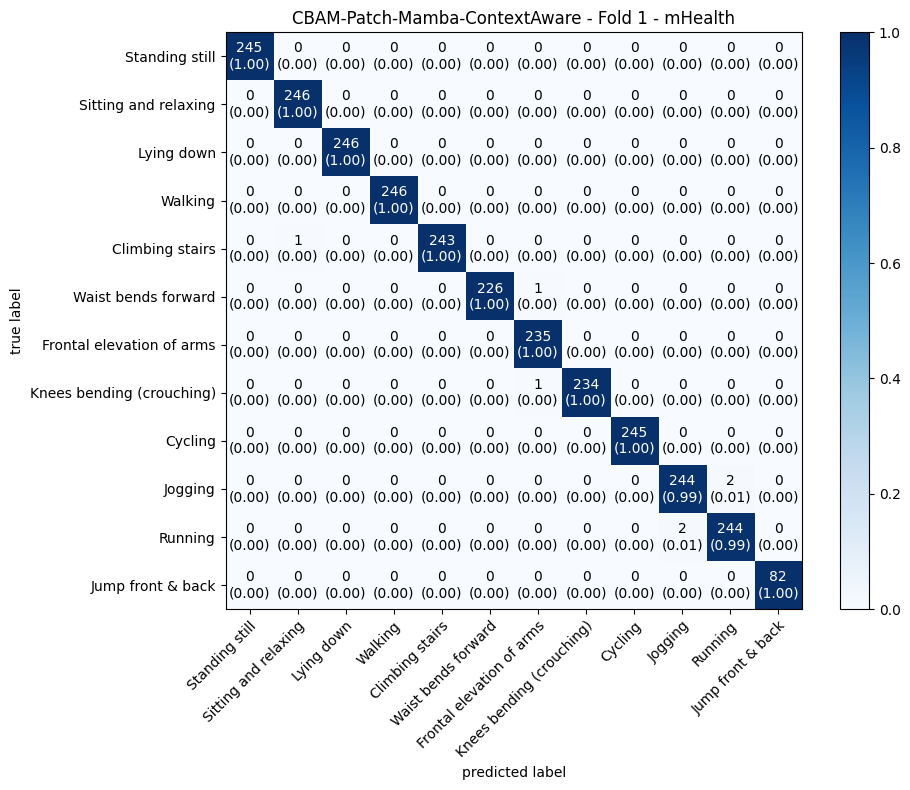


Fold 2/5
Model parameters: 249,899
START
Epoch 1/100 - Train Loss: 1.5134, Train Acc: 0.6351, Val Loss: 1.9595, Val Acc: 0.4079, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7954, Train Acc: 0.9332, Val Loss: 0.8528, Val Acc: 0.8983, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6522, Train Acc: 0.9826, Val Loss: 0.6499, Val Acc: 0.9748, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5995, Train Acc: 0.9942, Val Loss: 0.6347, Val Acc: 0.9803, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5799, Train Acc: 0.9957, Val Loss: 0.6115, Val Acc: 0.9810, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5691, Train Acc: 0.9967, Val Loss: 0.6050, Val Acc: 0.9869, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5638, Train Acc: 0.9983, Val Loss: 0.5842, Val Acc: 0.9931, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5559, Train Acc: 0.9987, Val Loss: 0.5898, Val Acc: 0.9876, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5537, Train Acc: 0.9994, Val Loss: 0.5662, Val Acc: 0.9956, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5506, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

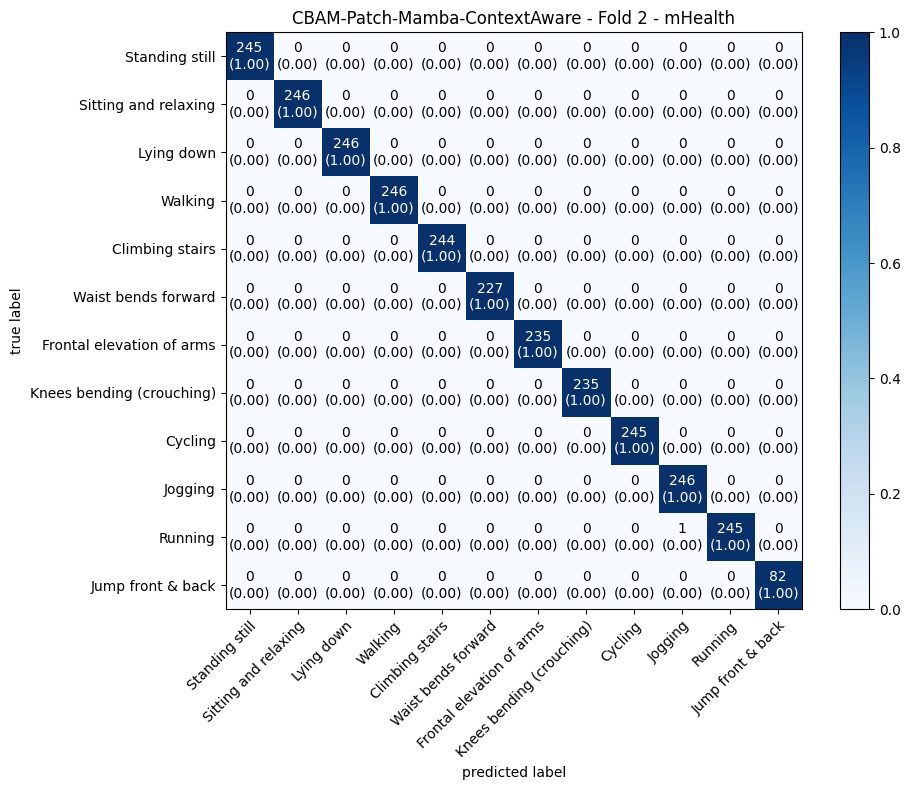


Fold 3/5
Model parameters: 249,899
START
Epoch 1/100 - Train Loss: 1.4119, Train Acc: 0.6913, Val Loss: 2.1607, Val Acc: 0.4480, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7535, Train Acc: 0.9493, Val Loss: 0.7826, Val Acc: 0.9216, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6384, Train Acc: 0.9853, Val Loss: 0.6740, Val Acc: 0.9741, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5917, Train Acc: 0.9950, Val Loss: 0.5888, Val Acc: 0.9923, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5740, Train Acc: 0.9966, Val Loss: 0.5848, Val Acc: 0.9942, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5661, Train Acc: 0.9978, Val Loss: 0.5781, Val Acc: 0.9938, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5586, Train Acc: 0.9988, Val Loss: 0.5641, Val Acc: 0.9949, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5554, Train Acc: 0.9990, Val Loss: 0.5575, Val Acc: 0.9964, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5516, Train Acc: 0.9994, Val Loss: 0.5564, Val Acc: 0.9964, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5486, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

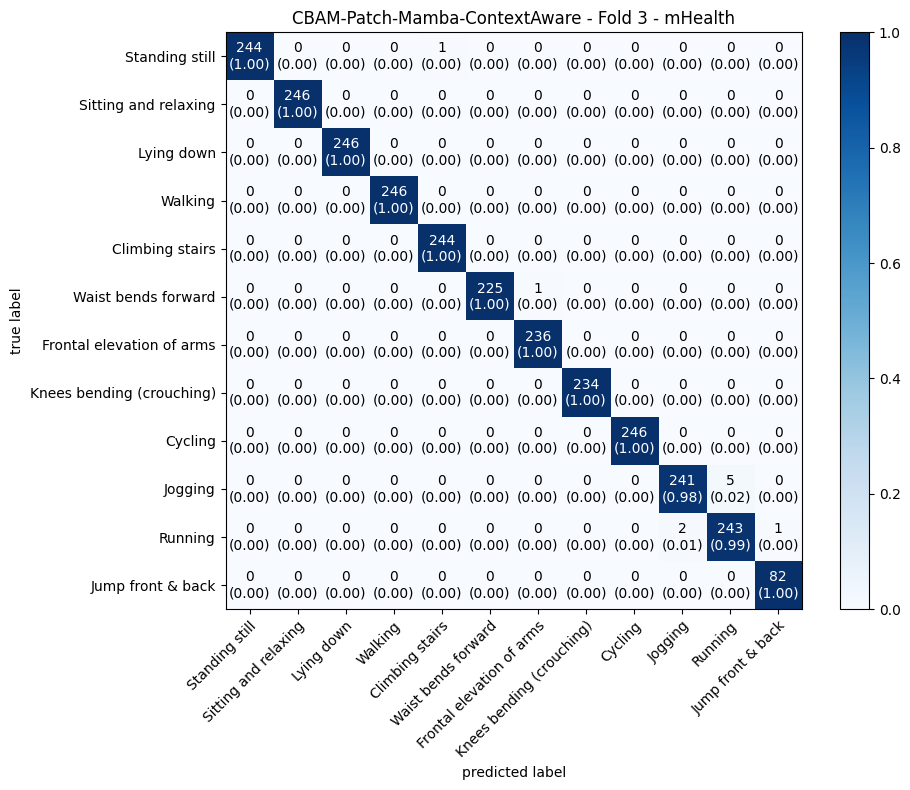


Fold 4/5
Model parameters: 249,899
START
Epoch 1/100 - Train Loss: 1.4477, Train Acc: 0.6751, Val Loss: 2.2659, Val Acc: 0.3230, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7647, Train Acc: 0.9448, Val Loss: 0.7948, Val Acc: 0.9307, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6388, Train Acc: 0.9825, Val Loss: 0.6642, Val Acc: 0.9789, LR: 0.000946
Epoch 4/100 - Train Loss: 0.6000, Train Acc: 0.9925, Val Loss: 0.5945, Val Acc: 0.9891, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5775, Train Acc: 0.9959, Val Loss: 0.5773, Val Acc: 0.9949, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5670, Train Acc: 0.9974, Val Loss: 0.5669, Val Acc: 0.9934, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5595, Train Acc: 0.9985, Val Loss: 0.5632, Val Acc: 0.9945, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5545, Train Acc: 0.9987, Val Loss: 0.5611, Val Acc: 0.9945, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5509, Train Acc: 0.9995, Val Loss: 0.5560, Val Acc: 0.9960, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5498, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

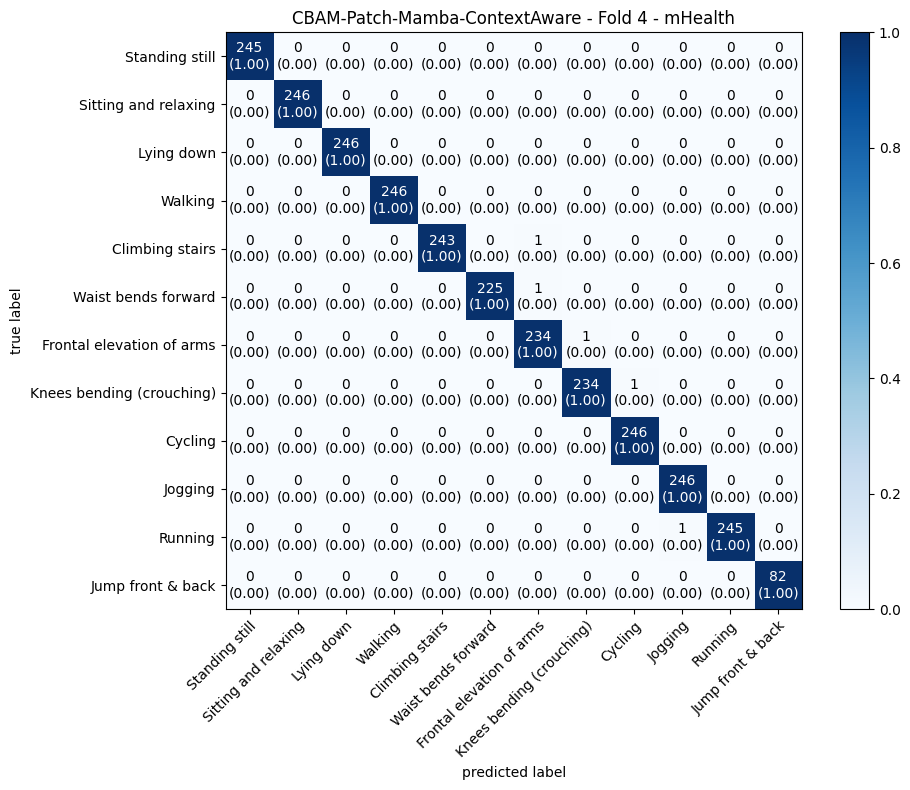


Fold 5/5
Model parameters: 249,899
START
Epoch 1/100 - Train Loss: 1.4231, Train Acc: 0.6861, Val Loss: 2.3507, Val Acc: 0.3234, LR: 0.000994
Epoch 2/100 - Train Loss: 0.7631, Train Acc: 0.9469, Val Loss: 0.7997, Val Acc: 0.9329, LR: 0.000976
Epoch 3/100 - Train Loss: 0.6371, Train Acc: 0.9852, Val Loss: 0.6189, Val Acc: 0.9818, LR: 0.000946
Epoch 4/100 - Train Loss: 0.5955, Train Acc: 0.9938, Val Loss: 0.5894, Val Acc: 0.9938, LR: 0.000905
Epoch 5/100 - Train Loss: 0.5761, Train Acc: 0.9970, Val Loss: 0.5870, Val Acc: 0.9938, LR: 0.000854
Epoch 6/100 - Train Loss: 0.5652, Train Acc: 0.9981, Val Loss: 0.5719, Val Acc: 0.9953, LR: 0.000794
Epoch 7/100 - Train Loss: 0.5595, Train Acc: 0.9985, Val Loss: 0.5662, Val Acc: 0.9960, LR: 0.000727
Epoch 8/100 - Train Loss: 0.5563, Train Acc: 0.9991, Val Loss: 0.5605, Val Acc: 0.9953, LR: 0.000655
Epoch 9/100 - Train Loss: 0.5541, Train Acc: 0.9995, Val Loss: 0.5576, Val Acc: 0.9960, LR: 0.000579
Epoch 10/100 - Train Loss: 0.5519, Train Acc: 0.9

<Figure size 1000x800 with 0 Axes>

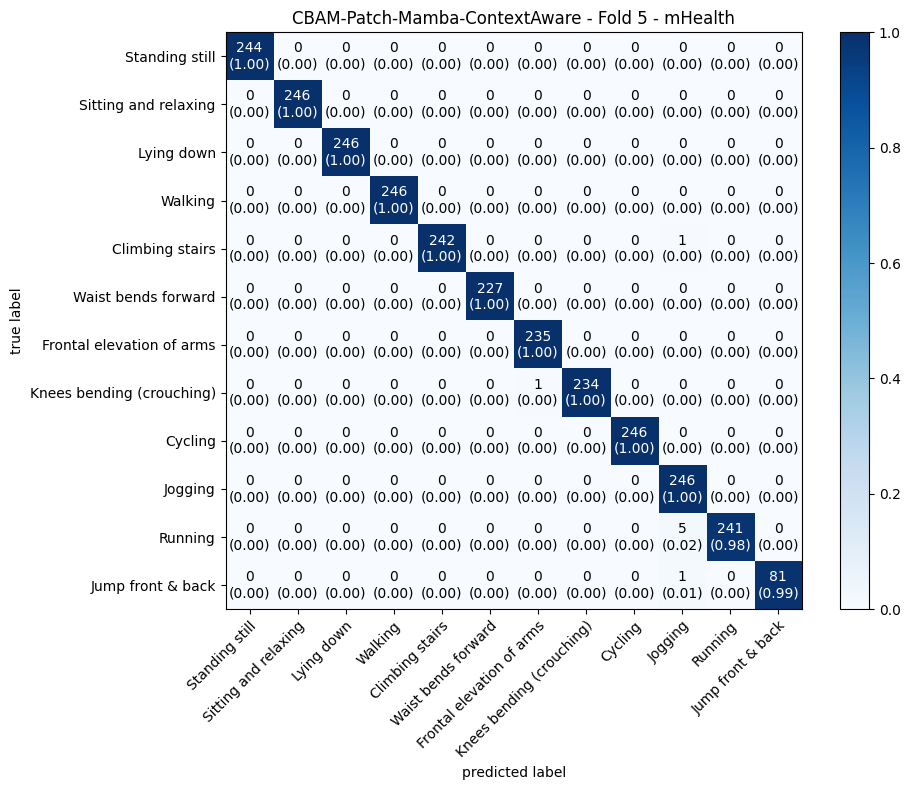


Generating t-SNE for CBAM-Patch-Mamba-ContextAware using full training data...
t-SNE input shape: (13714, 210)
Running t-SNE for CBAM-Patch-Mamba-ContextAware...


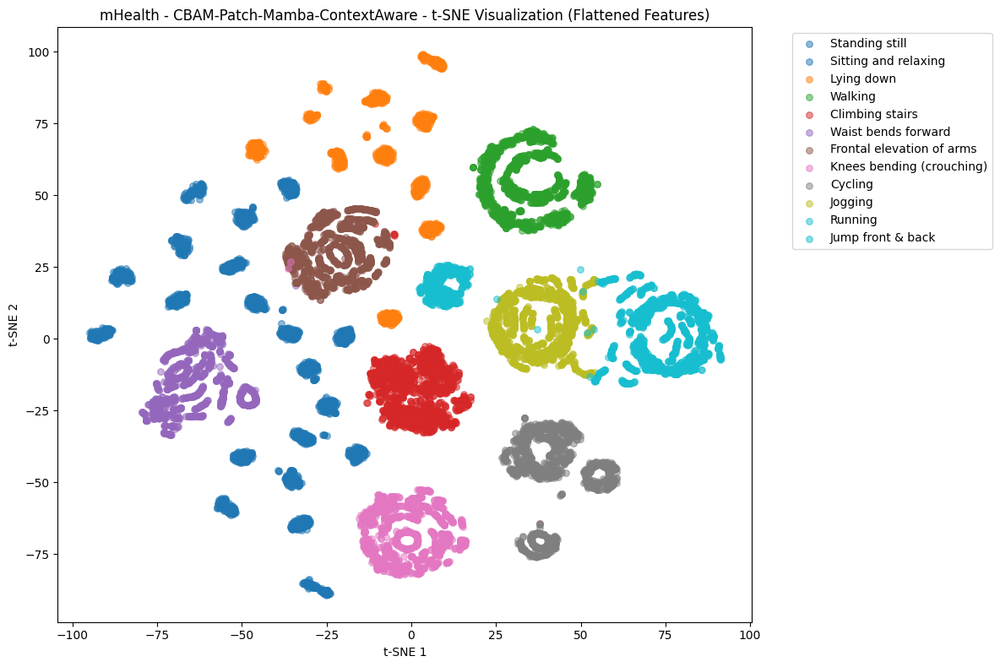


CBAM-Patch-Mamba-ContextAware Average Results:
Accuracy: 0.9977, F1: 0.9977
Precision: 0.9978, Recall: 0.9977
Sensitivity: 0.9977, Specificity: 0.9998
Parameters: 249,899
mHealth ablation study completed!

Processing Opportunity Dataset

=== Ablation Study for Opportunity ===
Using device: cuda
Dataset: Opportunity, Patch size: 6

--- Mamba Only ---

Fold 1/5
Model parameters: 160,372
START
Epoch 1/100 - Train Loss: 2.6340, Train Acc: 0.3599, Val Loss: 2.7695, Val Acc: 0.3457, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3366, Train Acc: 0.4451, Val Loss: 2.3467, Val Acc: 0.4525, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0920, Train Acc: 0.4659, Val Loss: 2.0474, Val Acc: 0.5279, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9046, Train Acc: 0.5115, Val Loss: 1.8810, Val Acc: 0.5601, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7726, Train Acc: 0.5451, Val Loss: 1.7803, Val Acc: 0.5733, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6673, Train Acc: 0.5821, Val Loss: 1.6486, Val Acc: 0.6013, LR: 0.000794

<Figure size 1000x800 with 0 Axes>

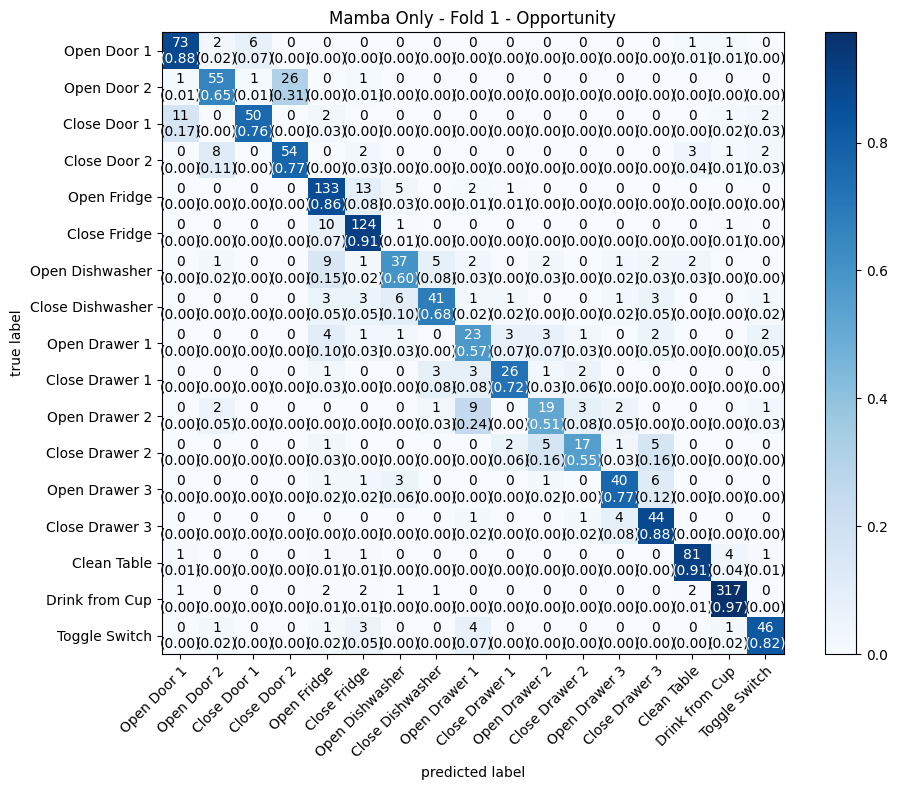


Fold 2/5
Model parameters: 160,372
START
Epoch 1/100 - Train Loss: 2.6343, Train Acc: 0.3566, Val Loss: 2.7510, Val Acc: 0.3946, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3388, Train Acc: 0.4810, Val Loss: 2.3706, Val Acc: 0.4944, LR: 0.000976
Epoch 3/100 - Train Loss: 2.1046, Train Acc: 0.5017, Val Loss: 2.2498, Val Acc: 0.5070, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9149, Train Acc: 0.5423, Val Loss: 2.0315, Val Acc: 0.5300, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7760, Train Acc: 0.5542, Val Loss: 1.7764, Val Acc: 0.5719, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6775, Train Acc: 0.5714, Val Loss: 1.6612, Val Acc: 0.5873, LR: 0.000794
Epoch 7/100 - Train Loss: 1.6071, Train Acc: 0.5865, Val Loss: 1.5767, Val Acc: 0.5782, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5505, Train Acc: 0.5954, Val Loss: 1.5200, Val Acc: 0.6047, LR: 0.000655
Epoch 9/100 - Train Loss: 1.5004, Train Acc: 0.6077, Val Loss: 1.4759, Val Acc: 0.6271, LR: 0.000579
Epoch 10/100 - Train Loss: 1.4656, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

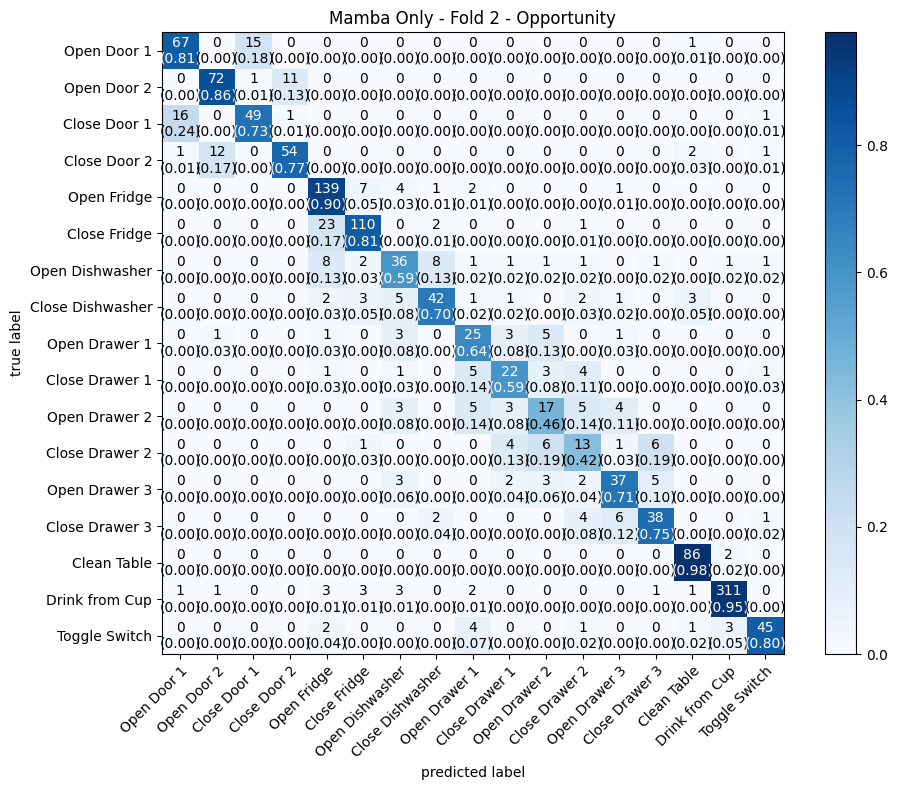


Fold 3/5
Model parameters: 160,372
START
Epoch 1/100 - Train Loss: 2.6245, Train Acc: 0.3617, Val Loss: 2.7557, Val Acc: 0.3457, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3221, Train Acc: 0.4625, Val Loss: 2.3329, Val Acc: 0.4511, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0713, Train Acc: 0.4825, Val Loss: 2.0555, Val Acc: 0.4993, LR: 0.000946
Epoch 4/100 - Train Loss: 1.8902, Train Acc: 0.5088, Val Loss: 1.7900, Val Acc: 0.5223, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7568, Train Acc: 0.5370, Val Loss: 1.7034, Val Acc: 0.5761, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6539, Train Acc: 0.5752, Val Loss: 1.5907, Val Acc: 0.5747, LR: 0.000794
Epoch 7/100 - Train Loss: 1.5886, Train Acc: 0.5880, Val Loss: 1.5575, Val Acc: 0.5943, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5290, Train Acc: 0.6020, Val Loss: 1.4836, Val Acc: 0.6041, LR: 0.000655
Epoch 9/100 - Train Loss: 1.4929, Train Acc: 0.6202, Val Loss: 1.4906, Val Acc: 0.6306, LR: 0.000579
Epoch 10/100 - Train Loss: 1.4496, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

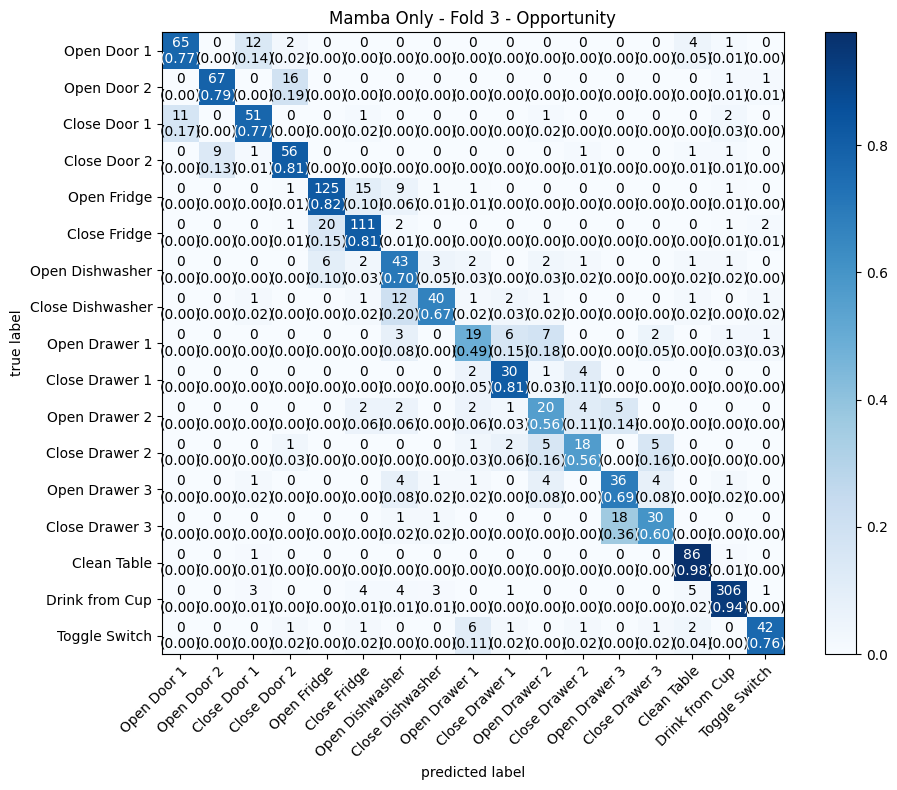


Fold 4/5
Model parameters: 160,372
START
Epoch 1/100 - Train Loss: 2.6474, Train Acc: 0.3498, Val Loss: 2.7474, Val Acc: 0.3450, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3399, Train Acc: 0.4450, Val Loss: 2.3412, Val Acc: 0.4609, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0953, Train Acc: 0.4732, Val Loss: 2.0589, Val Acc: 0.4902, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9155, Train Acc: 0.5065, Val Loss: 1.8381, Val Acc: 0.5189, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7695, Train Acc: 0.5568, Val Loss: 1.6981, Val Acc: 0.5663, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6651, Train Acc: 0.5782, Val Loss: 1.6230, Val Acc: 0.5971, LR: 0.000794
Epoch 7/100 - Train Loss: 1.5838, Train Acc: 0.6127, Val Loss: 1.5663, Val Acc: 0.5943, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5193, Train Acc: 0.6276, Val Loss: 1.4870, Val Acc: 0.6222, LR: 0.000655
Epoch 9/100 - Train Loss: 1.4655, Train Acc: 0.6476, Val Loss: 1.4353, Val Acc: 0.6418, LR: 0.000579
Epoch 10/100 - Train Loss: 1.4311, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

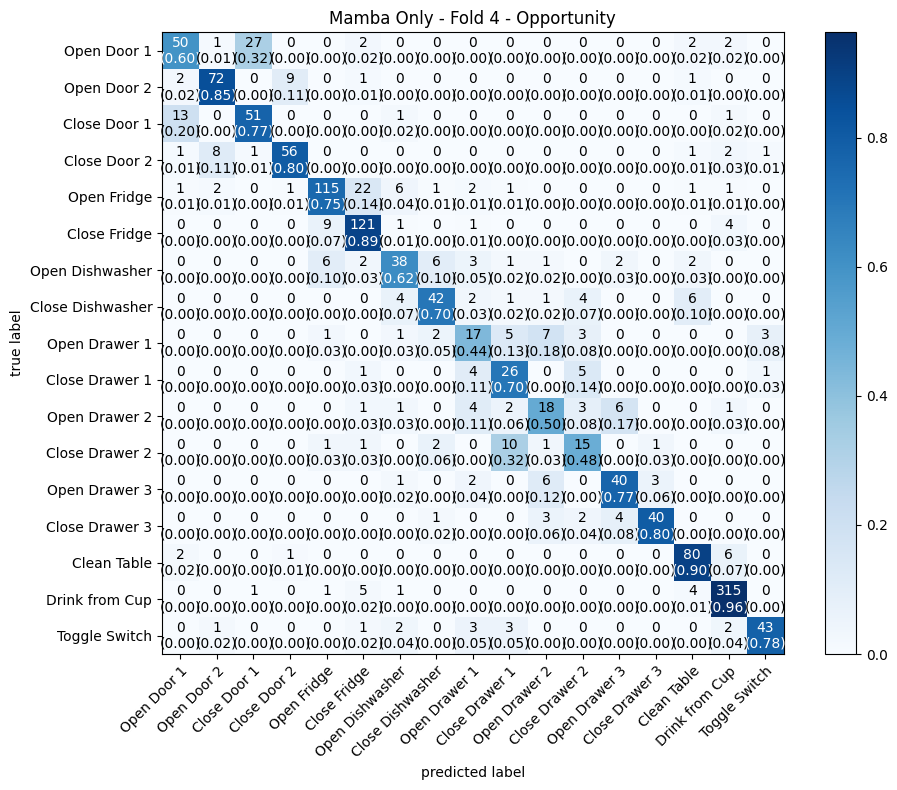


Fold 5/5
Model parameters: 160,372
START
Epoch 1/100 - Train Loss: 2.6474, Train Acc: 0.3500, Val Loss: 2.7510, Val Acc: 0.3492, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3321, Train Acc: 0.4613, Val Loss: 2.3994, Val Acc: 0.4504, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0705, Train Acc: 0.4963, Val Loss: 1.9602, Val Acc: 0.5154, LR: 0.000946
Epoch 4/100 - Train Loss: 1.8960, Train Acc: 0.5238, Val Loss: 1.7720, Val Acc: 0.5363, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7713, Train Acc: 0.5501, Val Loss: 1.7317, Val Acc: 0.5531, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6675, Train Acc: 0.5838, Val Loss: 1.5922, Val Acc: 0.6089, LR: 0.000794
Epoch 7/100 - Train Loss: 1.6004, Train Acc: 0.5983, Val Loss: 1.5499, Val Acc: 0.6173, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5446, Train Acc: 0.6150, Val Loss: 1.4950, Val Acc: 0.6180, LR: 0.000655
Epoch 9/100 - Train Loss: 1.5035, Train Acc: 0.6188, Val Loss: 1.4639, Val Acc: 0.6292, LR: 0.000579
Epoch 10/100 - Train Loss: 1.4609, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

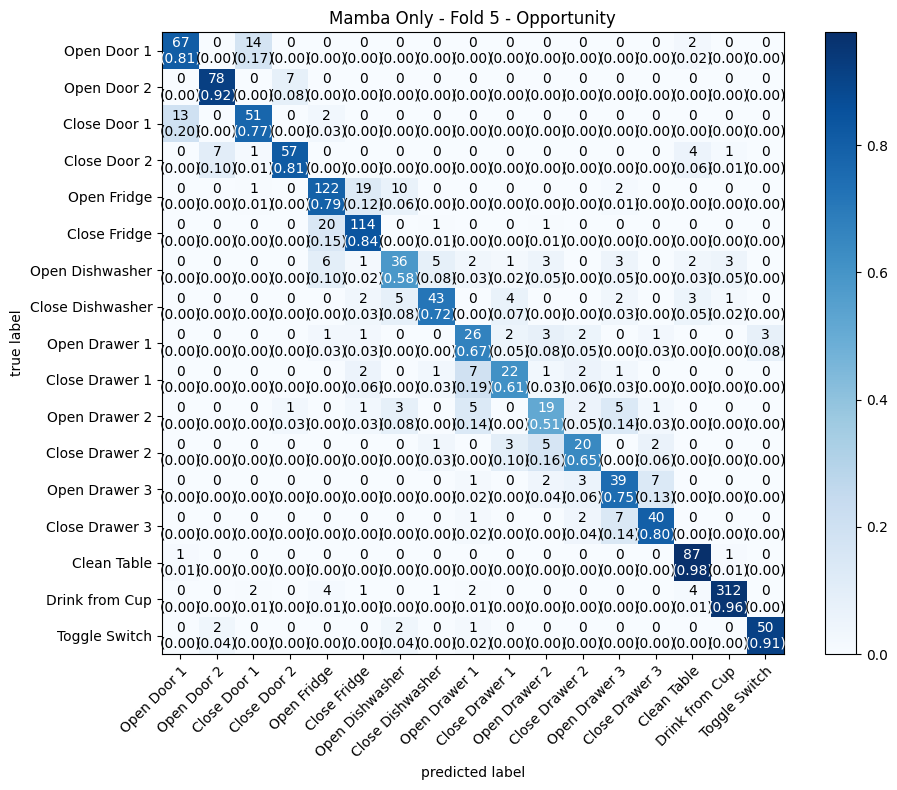


Generating t-SNE for Mamba Only using full training data...
t-SNE input shape: (7157, 162)
Running t-SNE for Mamba Only...


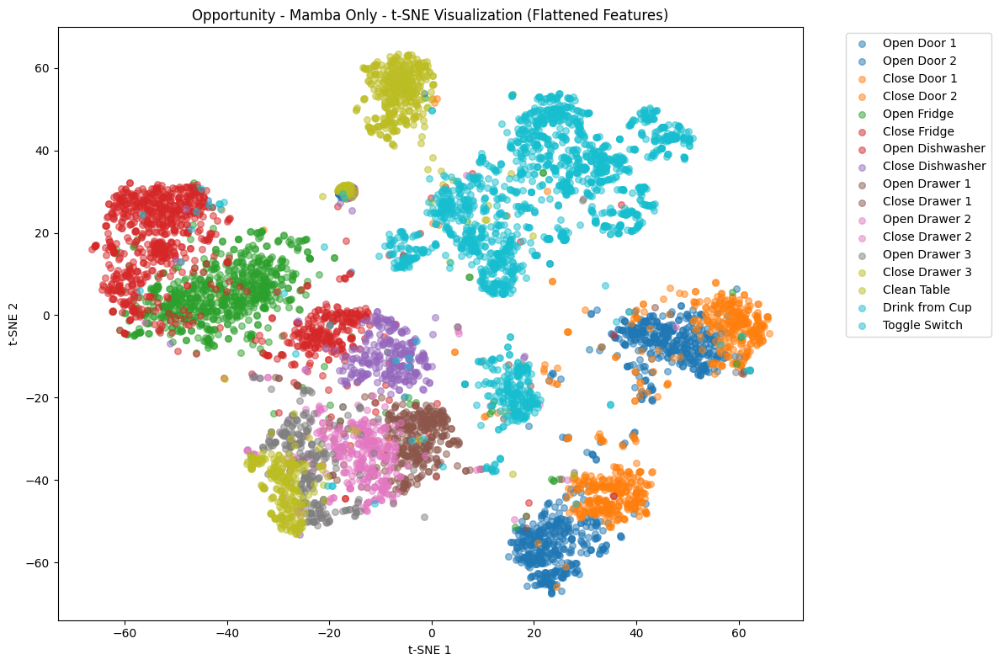


Mamba Only Average Results:
Accuracy: 0.8118, F1: 0.8116
Precision: 0.8150, Recall: 0.8118
Sensitivity: 0.7438, Specificity: 0.9882
Parameters: 160,372

--- CBAM-Patch-Mamba ---

Fold 1/5
Model parameters: 160,711
START
Epoch 1/100 - Train Loss: 2.6484, Train Acc: 0.3266, Val Loss: 2.7915, Val Acc: 0.2779, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3388, Train Acc: 0.4335, Val Loss: 2.5118, Val Acc: 0.3918, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0863, Train Acc: 0.4717, Val Loss: 2.1368, Val Acc: 0.4979, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9035, Train Acc: 0.5122, Val Loss: 1.8748, Val Acc: 0.5272, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7796, Train Acc: 0.5441, Val Loss: 1.7311, Val Acc: 0.5573, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6729, Train Acc: 0.5747, Val Loss: 1.6490, Val Acc: 0.5915, LR: 0.000794
Epoch 7/100 - Train Loss: 1.6122, Train Acc: 0.5884, Val Loss: 1.5768, Val Acc: 0.6117, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5429, Train Acc: 0.6000, Val Loss: 1.5062, V

<Figure size 1000x800 with 0 Axes>

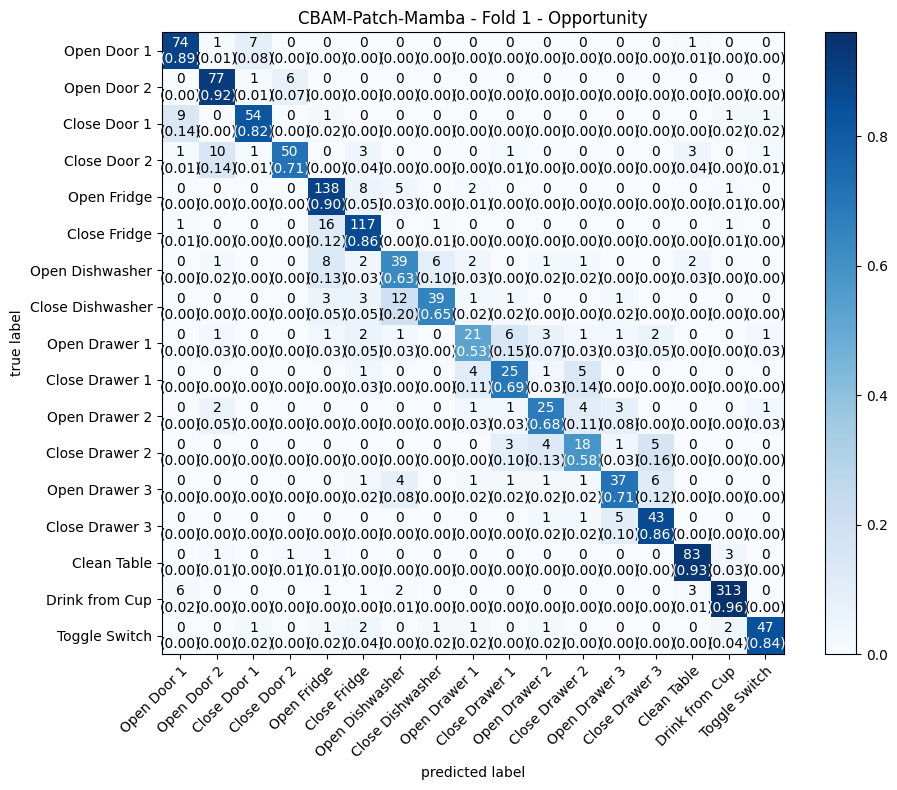


Fold 2/5
Model parameters: 160,711
START
Epoch 1/100 - Train Loss: 2.6366, Train Acc: 0.3482, Val Loss: 2.7973, Val Acc: 0.2744, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3404, Train Acc: 0.4507, Val Loss: 2.5269, Val Acc: 0.4078, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0975, Train Acc: 0.4610, Val Loss: 2.2001, Val Acc: 0.4441, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9180, Train Acc: 0.4985, Val Loss: 1.9138, Val Acc: 0.5049, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7775, Train Acc: 0.5344, Val Loss: 1.7606, Val Acc: 0.5419, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6818, Train Acc: 0.5665, Val Loss: 1.6533, Val Acc: 0.5838, LR: 0.000794
Epoch 7/100 - Train Loss: 1.5997, Train Acc: 0.5886, Val Loss: 1.5818, Val Acc: 0.5866, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5370, Train Acc: 0.6073, Val Loss: 1.4994, Val Acc: 0.6068, LR: 0.000655
Epoch 9/100 - Train Loss: 1.4839, Train Acc: 0.6233, Val Loss: 1.5289, Val Acc: 0.6075, LR: 0.000579
Epoch 10/100 - Train Loss: 1.4529, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

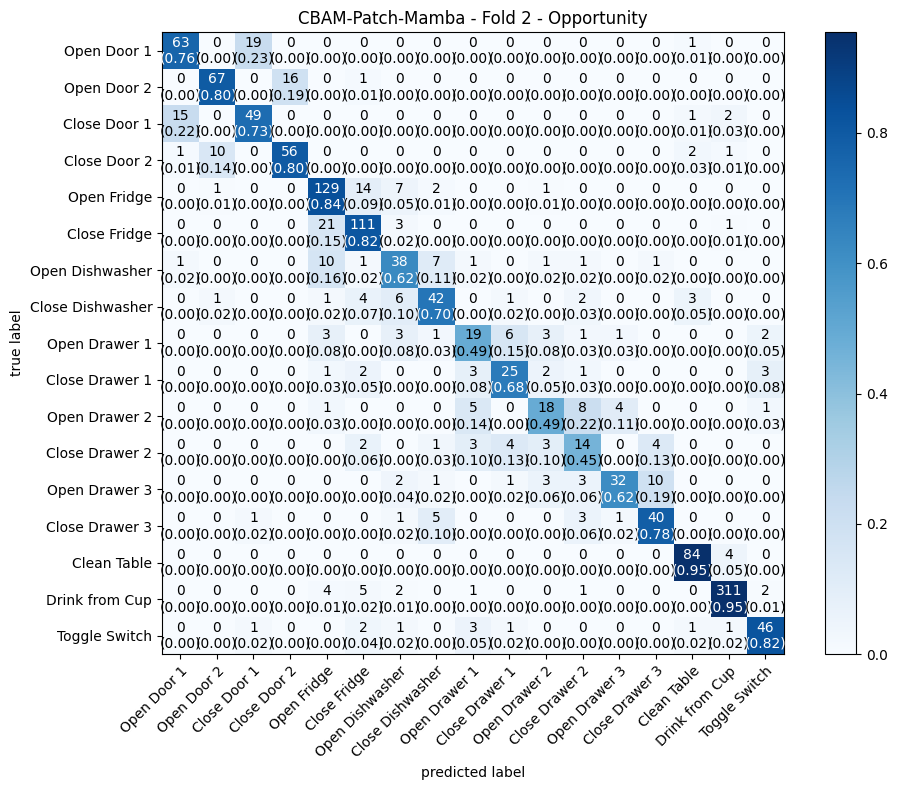


Fold 3/5
Model parameters: 160,711
START
Epoch 1/100 - Train Loss: 2.6304, Train Acc: 0.3354, Val Loss: 2.8089, Val Acc: 0.2961, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3312, Train Acc: 0.4103, Val Loss: 2.5939, Val Acc: 0.3890, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0929, Train Acc: 0.4369, Val Loss: 2.1827, Val Acc: 0.4302, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9147, Train Acc: 0.4618, Val Loss: 1.8383, Val Acc: 0.4546, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7849, Train Acc: 0.4993, Val Loss: 1.8028, Val Acc: 0.5349, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6922, Train Acc: 0.5433, Val Loss: 1.6297, Val Acc: 0.5691, LR: 0.000794
Epoch 7/100 - Train Loss: 1.6210, Train Acc: 0.5647, Val Loss: 1.5491, Val Acc: 0.5824, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5588, Train Acc: 0.5911, Val Loss: 1.5126, Val Acc: 0.6096, LR: 0.000655
Epoch 9/100 - Train Loss: 1.5206, Train Acc: 0.6113, Val Loss: 1.4879, Val Acc: 0.6257, LR: 0.000579
Epoch 10/100 - Train Loss: 1.4798, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

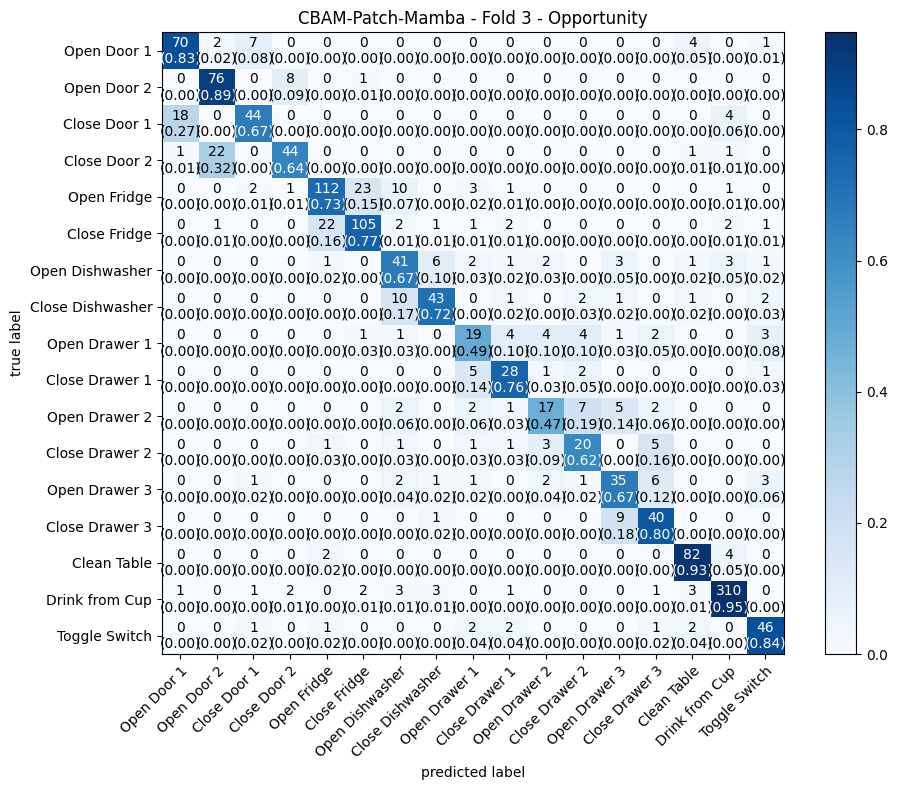


Fold 4/5
Model parameters: 160,711
START
Epoch 1/100 - Train Loss: 2.6460, Train Acc: 0.3370, Val Loss: 2.7993, Val Acc: 0.3582, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3389, Train Acc: 0.4381, Val Loss: 2.5002, Val Acc: 0.4050, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0907, Train Acc: 0.4637, Val Loss: 2.1963, Val Acc: 0.4420, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9049, Train Acc: 0.5063, Val Loss: 1.8805, Val Acc: 0.5223, LR: 0.000905
Epoch 5/100 - Train Loss: 1.7783, Train Acc: 0.5417, Val Loss: 1.7227, Val Acc: 0.5552, LR: 0.000854
Epoch 6/100 - Train Loss: 1.6702, Train Acc: 0.5696, Val Loss: 1.6376, Val Acc: 0.5740, LR: 0.000794
Epoch 7/100 - Train Loss: 1.5999, Train Acc: 0.5862, Val Loss: 1.5878, Val Acc: 0.5845, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5466, Train Acc: 0.5941, Val Loss: 1.5221, Val Acc: 0.5866, LR: 0.000655
Epoch 9/100 - Train Loss: 1.5043, Train Acc: 0.6078, Val Loss: 1.5042, Val Acc: 0.5957, LR: 0.000579
Epoch 10/100 - Train Loss: 1.4641, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

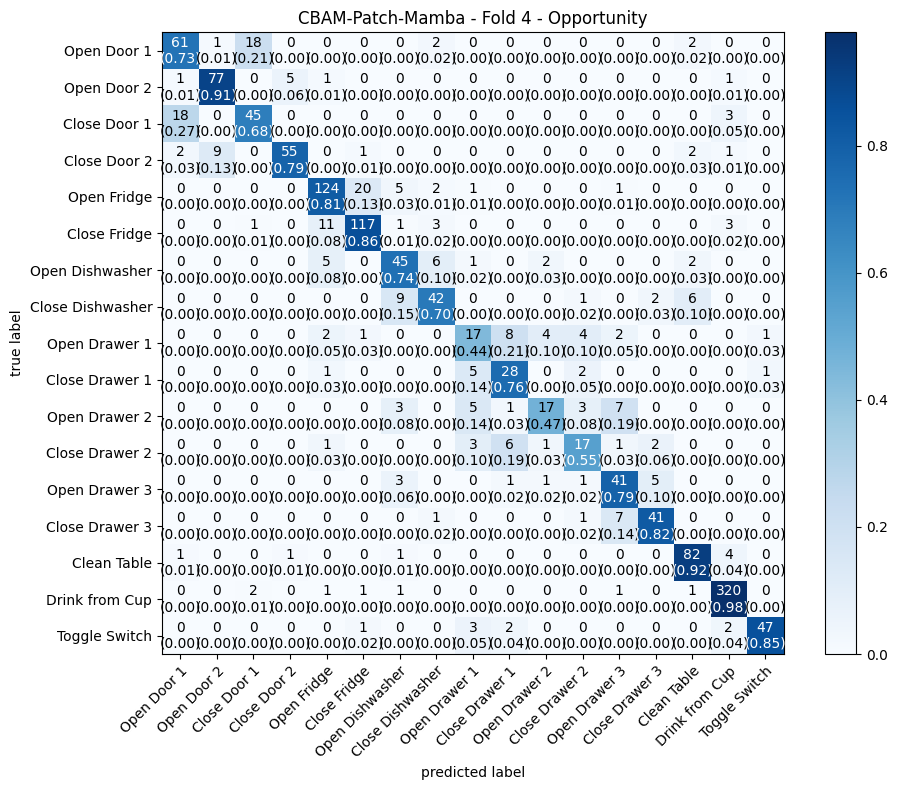


Fold 5/5
Model parameters: 160,711
START
Epoch 1/100 - Train Loss: 2.6139, Train Acc: 0.3663, Val Loss: 2.7875, Val Acc: 0.2430, LR: 0.000994
Epoch 2/100 - Train Loss: 2.3060, Train Acc: 0.4583, Val Loss: 2.5040, Val Acc: 0.3897, LR: 0.000976
Epoch 3/100 - Train Loss: 2.0843, Train Acc: 0.4842, Val Loss: 2.0903, Val Acc: 0.4644, LR: 0.000946
Epoch 4/100 - Train Loss: 1.9256, Train Acc: 0.5102, Val Loss: 1.8642, Val Acc: 0.5293, LR: 0.000905
Epoch 5/100 - Train Loss: 1.8082, Train Acc: 0.5331, Val Loss: 1.7615, Val Acc: 0.5552, LR: 0.000854
Epoch 6/100 - Train Loss: 1.7216, Train Acc: 0.5543, Val Loss: 1.6379, Val Acc: 0.5684, LR: 0.000794
Epoch 7/100 - Train Loss: 1.6577, Train Acc: 0.5682, Val Loss: 1.5872, Val Acc: 0.5733, LR: 0.000727
Epoch 8/100 - Train Loss: 1.5991, Train Acc: 0.5824, Val Loss: 1.5501, Val Acc: 0.5873, LR: 0.000655
Epoch 9/100 - Train Loss: 1.5547, Train Acc: 0.5929, Val Loss: 1.5256, Val Acc: 0.5992, LR: 0.000579
Epoch 10/100 - Train Loss: 1.5167, Train Acc: 0.6

<Figure size 1000x800 with 0 Axes>

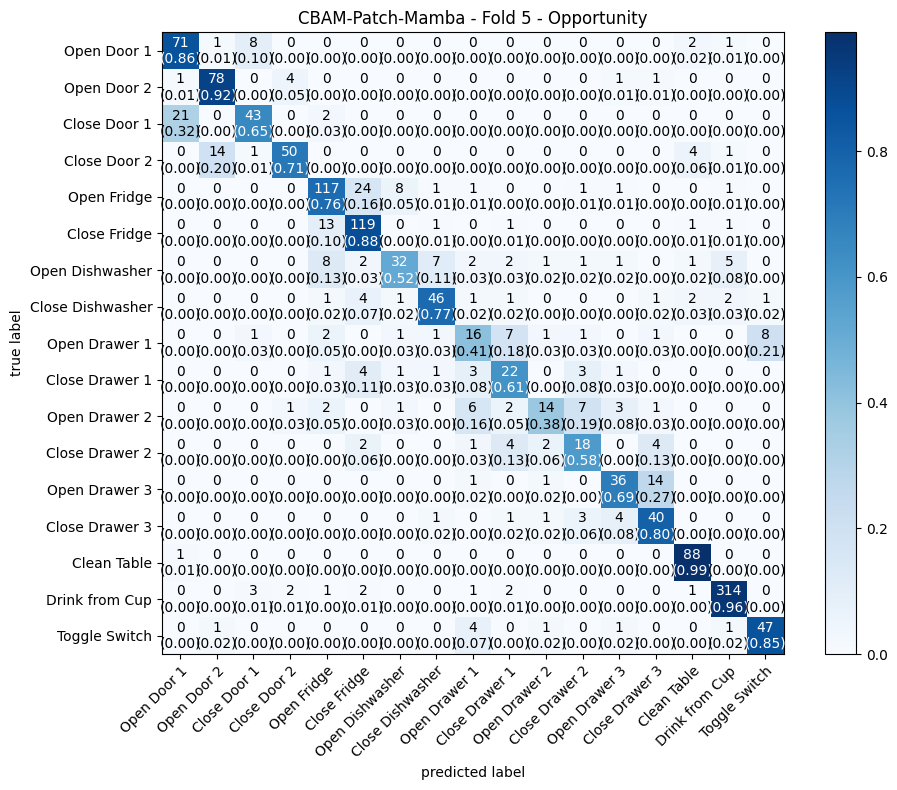


Generating t-SNE for CBAM-Patch-Mamba using full training data...
t-SNE input shape: (7157, 162)
Running t-SNE for CBAM-Patch-Mamba...


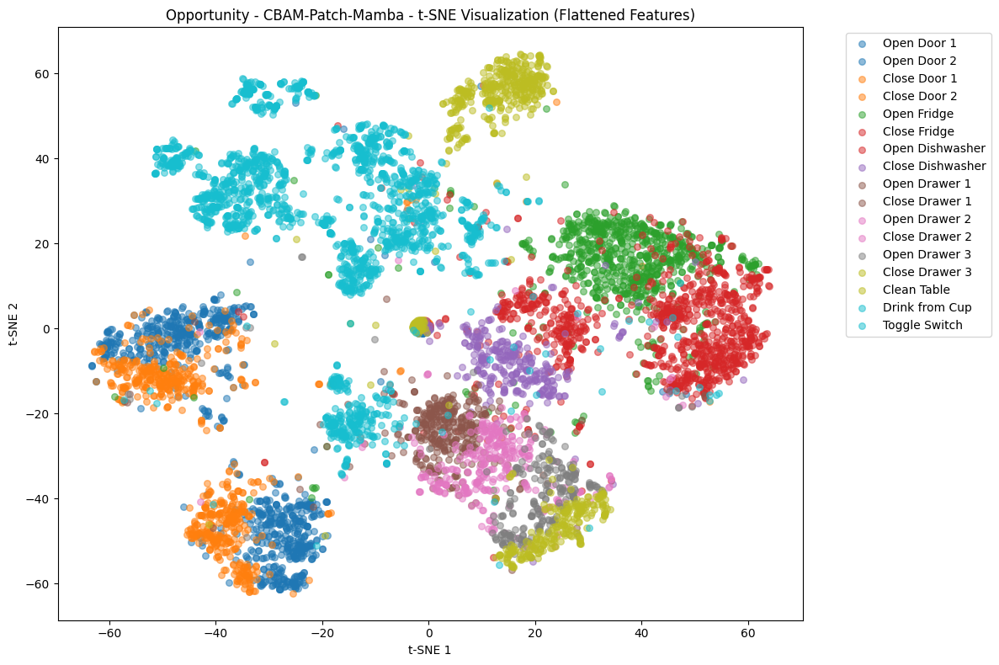


CBAM-Patch-Mamba Average Results:
Accuracy: 0.8108, F1: 0.8093
Precision: 0.8120, Recall: 0.8108
Sensitivity: 0.7414, Specificity: 0.9881
Parameters: 160,711

--- CBAM-Patch-Mamba-ContextAware ---

Fold 1/5
Model parameters: 202,097
START
Epoch 1/100 - Train Loss: 2.2159, Train Acc: 0.4076, Val Loss: 2.4276, Val Acc: 0.3506, LR: 0.000994
Epoch 2/100 - Train Loss: 1.6449, Train Acc: 0.5644, Val Loss: 2.0487, Val Acc: 0.4686, LR: 0.000976
Epoch 3/100 - Train Loss: 1.4594, Train Acc: 0.6373, Val Loss: 1.6152, Val Acc: 0.5677, LR: 0.000946
Epoch 4/100 - Train Loss: 1.3329, Train Acc: 0.6881, Val Loss: 1.4094, Val Acc: 0.6487, LR: 0.000905
Epoch 5/100 - Train Loss: 1.2290, Train Acc: 0.7405, Val Loss: 1.3483, Val Acc: 0.6767, LR: 0.000854
Epoch 6/100 - Train Loss: 1.1545, Train Acc: 0.7785, Val Loss: 1.2541, Val Acc: 0.7228, LR: 0.000794
Epoch 7/100 - Train Loss: 1.1036, Train Acc: 0.7999, Val Loss: 1.2167, Val Acc: 0.7514, LR: 0.000727
Epoch 8/100 - Train Loss: 1.0580, Train Acc: 0.8260, 

<Figure size 1000x800 with 0 Axes>

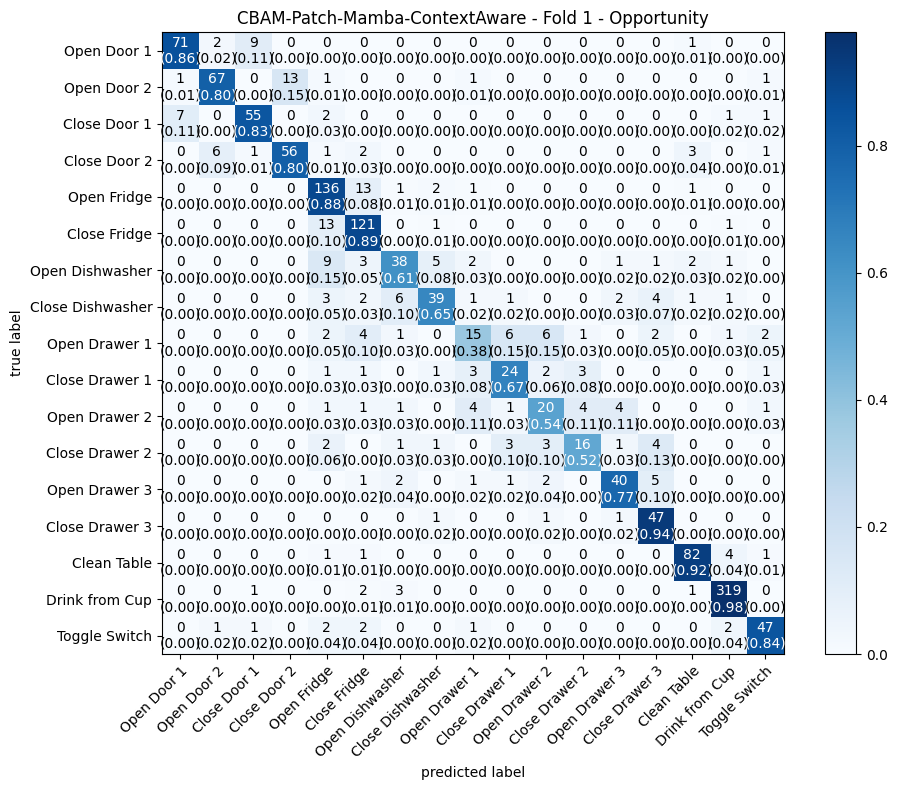


Fold 2/5
Model parameters: 202,097
START
Epoch 1/100 - Train Loss: 2.2642, Train Acc: 0.3778, Val Loss: 2.4137, Val Acc: 0.3142, LR: 0.000994
Epoch 2/100 - Train Loss: 1.6683, Train Acc: 0.5486, Val Loss: 2.0886, Val Acc: 0.4427, LR: 0.000976
Epoch 3/100 - Train Loss: 1.4804, Train Acc: 0.6254, Val Loss: 1.6949, Val Acc: 0.5349, LR: 0.000946
Epoch 4/100 - Train Loss: 1.3386, Train Acc: 0.6965, Val Loss: 1.4160, Val Acc: 0.6613, LR: 0.000905
Epoch 5/100 - Train Loss: 1.2307, Train Acc: 0.7407, Val Loss: 1.2871, Val Acc: 0.6997, LR: 0.000854
Epoch 6/100 - Train Loss: 1.1636, Train Acc: 0.7643, Val Loss: 1.2321, Val Acc: 0.7346, LR: 0.000794
Epoch 7/100 - Train Loss: 1.1073, Train Acc: 0.7952, Val Loss: 1.1864, Val Acc: 0.7612, LR: 0.000727
Epoch 8/100 - Train Loss: 1.0589, Train Acc: 0.8162, Val Loss: 1.1747, Val Acc: 0.7612, LR: 0.000655
Epoch 9/100 - Train Loss: 1.0217, Train Acc: 0.8379, Val Loss: 1.1572, Val Acc: 0.7737, LR: 0.000579
Epoch 10/100 - Train Loss: 1.0035, Train Acc: 0.8

<Figure size 1000x800 with 0 Axes>

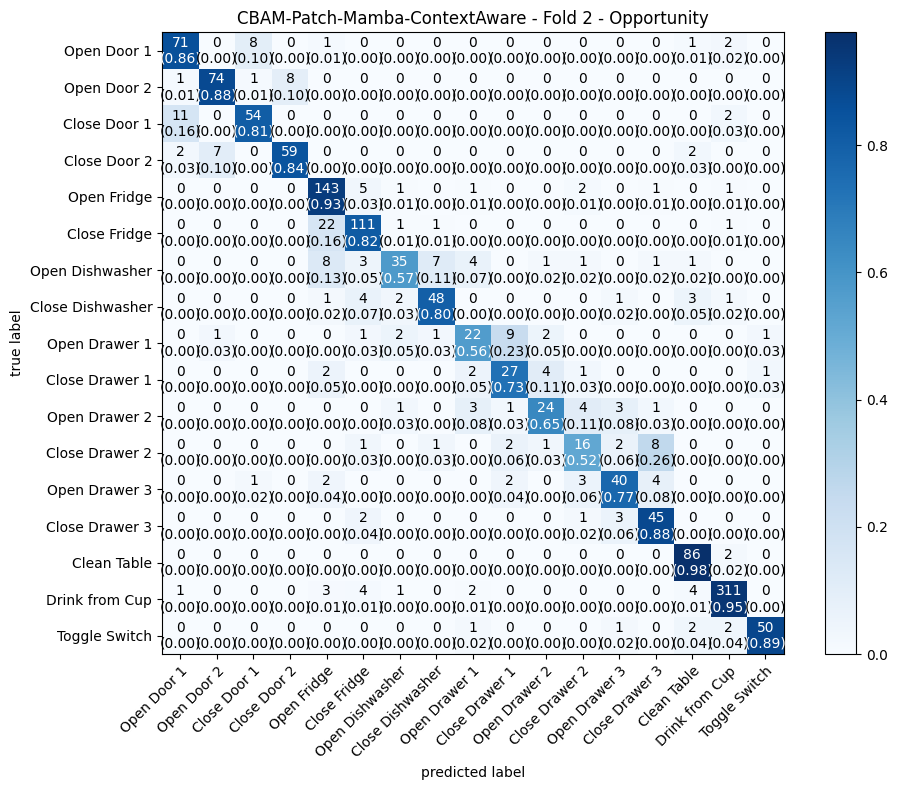


Fold 3/5
Model parameters: 202,097
START
Epoch 1/100 - Train Loss: 2.2506, Train Acc: 0.3940, Val Loss: 2.3715, Val Acc: 0.3261, LR: 0.000994
Epoch 2/100 - Train Loss: 1.6352, Train Acc: 0.5636, Val Loss: 2.1119, Val Acc: 0.3638, LR: 0.000976
Epoch 3/100 - Train Loss: 1.4481, Train Acc: 0.6388, Val Loss: 1.7338, Val Acc: 0.5112, LR: 0.000946
Epoch 4/100 - Train Loss: 1.3227, Train Acc: 0.6986, Val Loss: 1.3871, Val Acc: 0.6697, LR: 0.000905
Epoch 5/100 - Train Loss: 1.2165, Train Acc: 0.7438, Val Loss: 1.3895, Val Acc: 0.6892, LR: 0.000854
Epoch 6/100 - Train Loss: 1.1468, Train Acc: 0.7830, Val Loss: 1.2402, Val Acc: 0.7514, LR: 0.000794
Epoch 7/100 - Train Loss: 1.0987, Train Acc: 0.8067, Val Loss: 1.1946, Val Acc: 0.7521, LR: 0.000727
Epoch 8/100 - Train Loss: 1.0454, Train Acc: 0.8246, Val Loss: 1.1894, Val Acc: 0.7647, LR: 0.000655
Epoch 9/100 - Train Loss: 1.0087, Train Acc: 0.8365, Val Loss: 1.1487, Val Acc: 0.7779, LR: 0.000579
Epoch 10/100 - Train Loss: 0.9770, Train Acc: 0.8

<Figure size 1000x800 with 0 Axes>

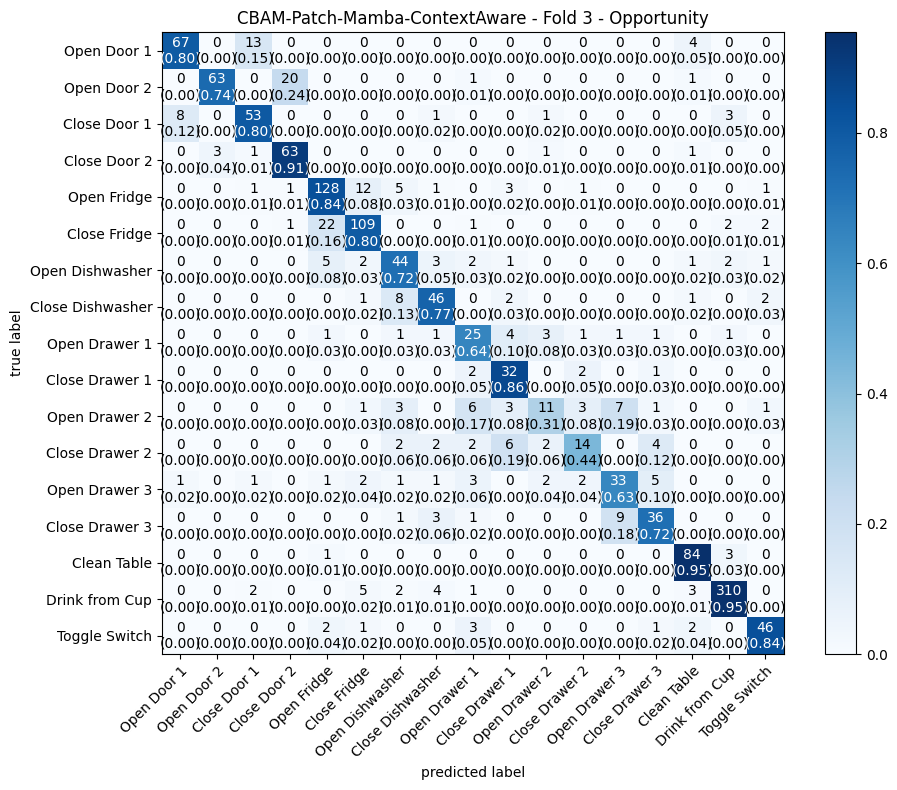


Fold 4/5
Model parameters: 202,097
START
Epoch 1/100 - Train Loss: 2.2332, Train Acc: 0.4169, Val Loss: 2.3767, Val Acc: 0.3156, LR: 0.000994
Epoch 2/100 - Train Loss: 1.6357, Train Acc: 0.5741, Val Loss: 2.0431, Val Acc: 0.4316, LR: 0.000976
Epoch 3/100 - Train Loss: 1.4417, Train Acc: 0.6490, Val Loss: 1.7091, Val Acc: 0.5496, LR: 0.000946
Epoch 4/100 - Train Loss: 1.3152, Train Acc: 0.7000, Val Loss: 1.3758, Val Acc: 0.6690, LR: 0.000905
Epoch 5/100 - Train Loss: 1.2224, Train Acc: 0.7420, Val Loss: 1.3438, Val Acc: 0.6990, LR: 0.000854
Epoch 6/100 - Train Loss: 1.1446, Train Acc: 0.7741, Val Loss: 1.2702, Val Acc: 0.7325, LR: 0.000794
Epoch 7/100 - Train Loss: 1.0860, Train Acc: 0.8104, Val Loss: 1.2396, Val Acc: 0.7472, LR: 0.000727
Epoch 8/100 - Train Loss: 1.0449, Train Acc: 0.8244, Val Loss: 1.2102, Val Acc: 0.7500, LR: 0.000655
Epoch 9/100 - Train Loss: 1.0107, Train Acc: 0.8407, Val Loss: 1.1790, Val Acc: 0.7647, LR: 0.000579
Epoch 10/100 - Train Loss: 0.9766, Train Acc: 0.8

<Figure size 1000x800 with 0 Axes>

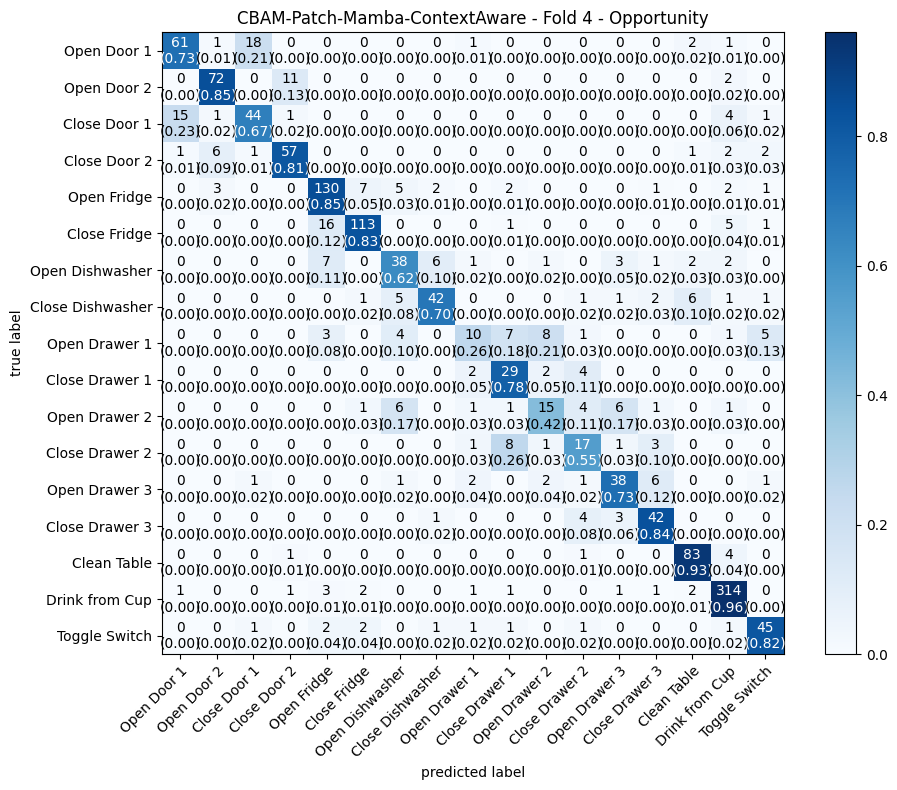


Fold 5/5
Model parameters: 202,097
START
Epoch 1/100 - Train Loss: 2.2620, Train Acc: 0.3917, Val Loss: 2.3395, Val Acc: 0.3080, LR: 0.000994
Epoch 2/100 - Train Loss: 1.6735, Train Acc: 0.5545, Val Loss: 2.0152, Val Acc: 0.4448, LR: 0.000976
Epoch 3/100 - Train Loss: 1.4768, Train Acc: 0.6302, Val Loss: 1.6376, Val Acc: 0.5915, LR: 0.000946
Epoch 4/100 - Train Loss: 1.3437, Train Acc: 0.6842, Val Loss: 1.4080, Val Acc: 0.6676, LR: 0.000905
Epoch 5/100 - Train Loss: 1.2421, Train Acc: 0.7366, Val Loss: 1.3234, Val Acc: 0.7053, LR: 0.000854
Epoch 6/100 - Train Loss: 1.1732, Train Acc: 0.7664, Val Loss: 1.2311, Val Acc: 0.7430, LR: 0.000794
Epoch 7/100 - Train Loss: 1.1194, Train Acc: 0.7946, Val Loss: 1.2411, Val Acc: 0.7451, LR: 0.000727
Epoch 8/100 - Train Loss: 1.0714, Train Acc: 0.8181, Val Loss: 1.1570, Val Acc: 0.7800, LR: 0.000655
Epoch 9/100 - Train Loss: 1.0325, Train Acc: 0.8391, Val Loss: 1.1499, Val Acc: 0.7821, LR: 0.000579
Epoch 10/100 - Train Loss: 1.0181, Train Acc: 0.8

<Figure size 1000x800 with 0 Axes>

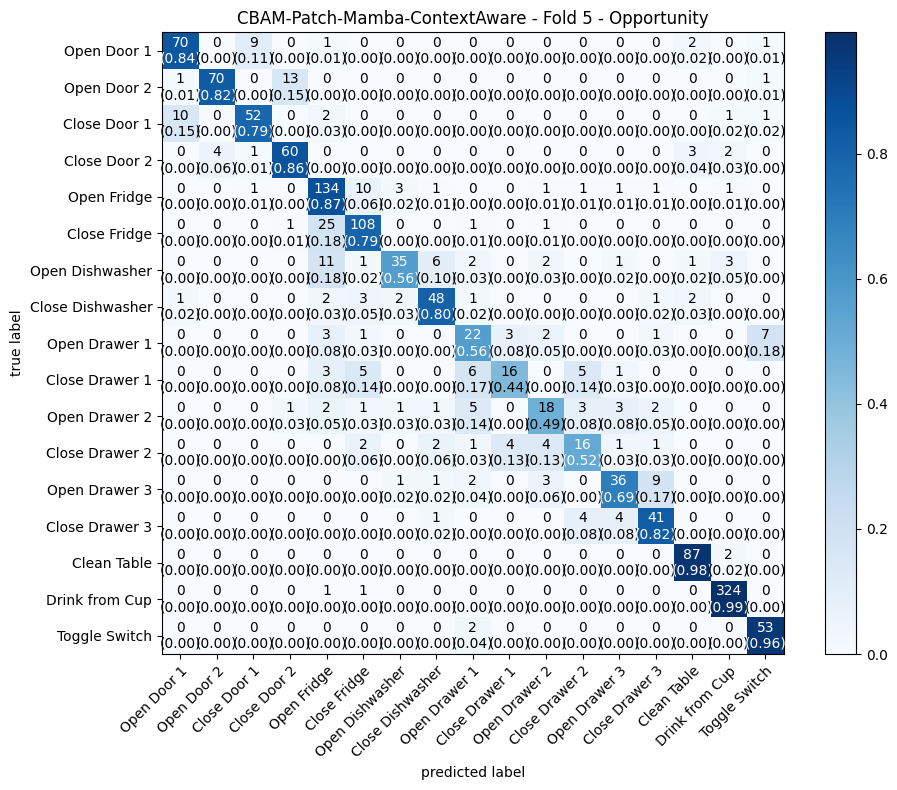


Generating t-SNE for CBAM-Patch-Mamba-ContextAware using full training data...
t-SNE input shape: (7157, 162)
Running t-SNE for CBAM-Patch-Mamba-ContextAware...


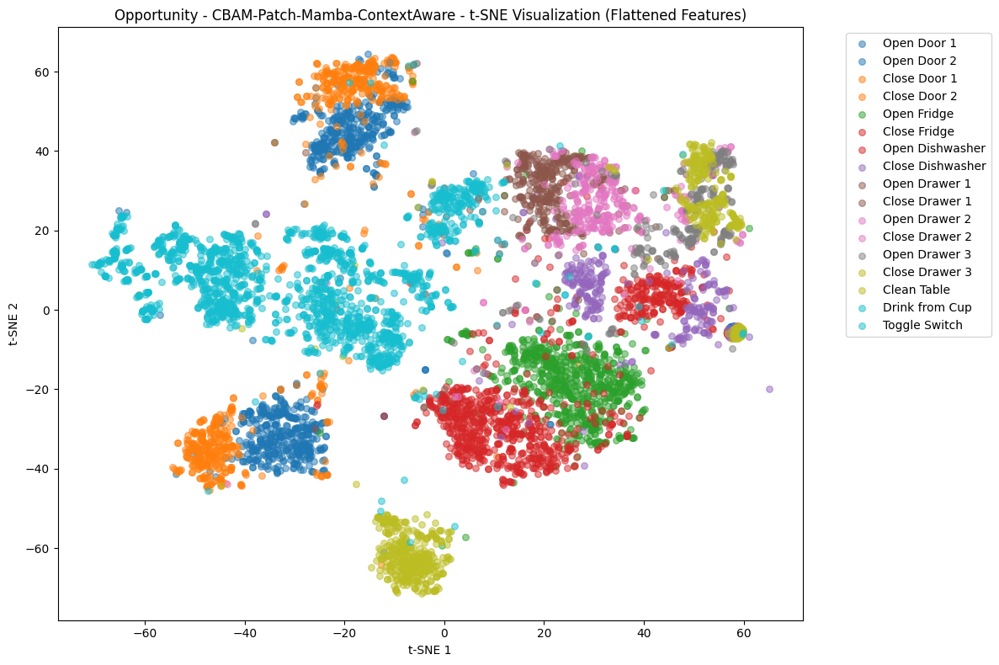


CBAM-Patch-Mamba-ContextAware Average Results:
Accuracy: 0.8262, F1: 0.8233
Precision: 0.8258, Recall: 0.8262
Sensitivity: 0.7549, Specificity: 0.9890
Parameters: 202,097
Opportunity ablation study completed!

FINAL RESULTS - ALL DATASETS

Complete Results Table:
    dataset                         model    fold  accuracy       f1  precision   recall  sensitivity  specificity  parameters
    UCI-HAR                    Mamba Only       1  0.959223 0.959045   0.963733 0.959223     0.963019     0.991773      228510
    UCI-HAR                    Mamba Only       2  0.934466 0.933667   0.943672 0.934466     0.940206     0.986776      228510
    UCI-HAR                    Mamba Only       3  0.965049 0.965037   0.965701 0.965049     0.967660     0.992938      228510
    UCI-HAR                    Mamba Only       4  0.967961 0.967968   0.968019 0.967961     0.970167     0.993503      228510
    UCI-HAR                    Mamba Only       5  0.961632 0.961643   0.962623 0.961632     0.96429

,dataset,model,fold,accuracy,f1,precision,recall,sensitivity,specificity,parameters
0,UCI-HAR,Mamba Only,1,0.959223,0.959045,0.963733,0.959223,0.963019,0.991773,228510
1,UCI-HAR,Mamba Only,2,0.934466,0.933667,0.943672,0.934466,0.940206,0.986776,228510
2,UCI-HAR,Mamba Only,3,0.965049,0.965037,0.965701,0.965049,0.967660,0.992938,228510
3,UCI-HAR,Mamba Only,4,0.967961,0.967968,0.968019,0.967961,0.970167,0.993503,228510
4,UCI-HAR,Mamba Only,5,0.961632,0.961643,0.962623,0.961632,0.964297,0.992239,228510
5,UCI-HAR,Mamba Only,Average,0.957666,0.957472,0.960750,0.957666,0.961070,0.991446,228510
6,UCI-HAR,CBAM-Patch-Mamba,1,0.966019,0.965980,0.968056,0.966019,0.968994,0.993135,228561
7,UCI-HAR,CBAM-Patch-Mamba,2,0.917476,0.913935,0.942053,0.917476,0.925495,0.983376,228561
8,UCI-HAR,CBAM-Patch-Mamba,3,0.962621,0.962560,0.962976,0.962621,0.964797,0.992403,228561
9,UCI-HAR,CBAM-Patch-Mamba,4,0.966990,0.966966,0.967088,0.966990,0.968959,0.993296,228561



ABLATION STUDY SUMMARY BY DATASET

UCI-HAR:
  Mamba Only:
    Accuracy: 0.9577, F1: 0.9575
    Parameters: 228,510
  CBAM-Patch-Mamba:
    Accuracy: 0.9487, F1: 0.9477
    Parameters: 228,561
  CBAM-Patch-Mamba-ContextAware:
    Accuracy: 0.9586, F1: 0.9583
    Parameters: 346,421

USC-HAD:
  Mamba Only:
    Accuracy: 0.9017, F1: 0.9021
    Parameters: 142,385
  CBAM-Patch-Mamba:
    Accuracy: 0.9013, F1: 0.9044
    Parameters: 142,412
  CBAM-Patch-Mamba-ContextAware:
    Accuracy: 0.9075, F1: 0.9070
    Parameters: 163,661

WISDM:
  Mamba Only:
    Accuracy: 0.9552, F1: 0.9549
    Parameters: 107,402
  CBAM-Patch-Mamba:
    Accuracy: 0.9535, F1: 0.9532
    Parameters: 107,417
  CBAM-Patch-Mamba-ContextAware:
    Accuracy: 0.9529, F1: 0.9523
    Parameters: 104,609

PAMAP2:
  Mamba Only:
    Accuracy: 0.9766, F1: 0.9766
    Parameters: 425,949
  CBAM-Patch-Mamba:
    Accuracy: 0.9760, F1: 0.9759
    Parameters: 426,288
  CBAM-Patch-Mamba-ContextAware:
    Accuracy: 0.9706, F1: 0.9707


In [19]:

###############################
def main():
    set_seed(232)

    datasets = {
        'UCI-HAR': load_uci_har_data,
        'USC-HAD': load_usc_had_data,
        'WISDM': load_wisdm_data,
        'PAMAP2': load_pamap2_data,
        'mHealth': load_mhealth_data,
        'Opportunity': load_opportunity_data
    }

    print("="*80)
    print("LOADING ALL DATASETS")
    print("="*80)

    loaded_datasets = {}

    for dataset_name, load_func in datasets.items():
        print(f"\n{'='*60}")
        print(f"Loading {dataset_name} Dataset")
        print(f"{'='*60}")

        try:
            X, y, activity_labels = load_func()

            if X is not None and y is not None:
                num_classes = len(np.unique(y))
                print(f"Dataset shape: {X.shape}")
                print(f"Number of classes: {num_classes}")
                print(f"Activity labels: {activity_labels}")

                X_train, X_temp, y_train, y_temp = train_test_split(X, y, test_size=0.4, stratify=y, random_state=42)
                X_val, X_test, y_val, y_test = train_test_split(X_temp, y_temp, test_size=0.5, stratify=y_temp, random_state=42)

                print(f"\nData split sizes:")
                print(f"  Train: {X_train.shape[0]} samples")
                print(f"  Validation: {X_val.shape[0]} samples")
                print(f"  Test: {X_test.shape[0]} samples")

                print(f"\nClass distribution in full dataset:")
                unique, counts = np.unique(y, return_counts=True)
                for i, (label_idx, count) in enumerate(zip(unique, counts)):
                    if label_idx < len(activity_labels):
                        print(f"  {activity_labels[label_idx]}: {count} samples")

                loaded_datasets[dataset_name] = {
                    'X': X,
                    'y': y,
                    'activity_labels': activity_labels,
                    'num_classes': num_classes
                }

                print(f"{dataset_name} dataset loaded successfully!")
            else:
                print(f"Failed to load {dataset_name} dataset")

        except Exception as e:
            print(f"Error loading {dataset_name}: {e}")
            continue

    print("\n" + "="*80)
    print("STARTING ABLATION STUDIES")
    print("="*80)

    all_results = []

    for dataset_name, dataset_info in loaded_datasets.items():
        print(f"\n{'='*60}")
        print(f"Processing {dataset_name} Dataset")
        print(f"{'='*60}")

        try:
            results = run_ablation_study(
                dataset_info['X'],
                dataset_info['y'],
                dataset_info['num_classes'],
                dataset_name,
                dataset_info['activity_labels']
            )
            all_results.extend(results)

            print(f"{dataset_name} ablation study completed!")

        except Exception as e:
            print(f"Error processing {dataset_name}: {e}")
            continue

    print("\n" + "="*80)
    print("FINAL RESULTS - ALL DATASETS")
    print("="*80)

    if all_results:
        results_df = pd.DataFrame(all_results)
        results_df = results_df[['dataset', 'model', 'fold', 'accuracy', 'f1', 'precision',
                                'recall', 'sensitivity', 'specificity', 'parameters']]

        print("\nComplete Results Table:")
        pd.set_option('display.max_rows', None)
        pd.set_option('display.max_columns', None)
        pd.set_option('display.width', None)
        pd.set_option('display.max_colwidth', None)

        print(results_df.to_string(index=False))
        display(results_df)

        print("\n" + "="*80)
        print("ABLATION STUDY SUMMARY BY DATASET")
        print("="*80)

        for dataset_name in results_df['dataset'].unique():
            print(f"\n{dataset_name}:")
            dataset_results = results_df[(results_df['dataset'] == dataset_name) &
                                       (results_df['fold'] == 'Average')]

            for _, row in dataset_results.iterrows():
                print(f"  {row['model']}:")
                print(f"    Accuracy: {row['accuracy']:.4f}, F1: {row['f1']:.4f}")
                print(f"    Parameters: {row['parameters']:,}")
    else:
        print("No results to display")

if __name__ == "__main__":
    main()